# Imports And Consts

In [1]:
RESULTS_COLUMNS = [
    "score",
    "numberOfTruePositives",
    "accuracy",
    "precision",
    "numberOfFeatures",
    "model",
    "model_parameters",
    "feature_selector",
    "selector_parameters",
]

In [2]:
import functions
import numpy as np
import pandas as pd
import seaborn as sns
import pickle
from sklearn.feature_selection import f_classif, mutual_info_classif
import matplotlib.pyplot as plt
from sklearn.svm import SVC
import xgboost as xgb

# Load Data

load the training and test data in a format specified by task description

In [3]:
with open("./Dataset/x_test.txt") as file:
    X_test = [[float(digit) for digit in line.split()] for line in file]


with open("./Dataset/x_train.txt") as file:
    X_train = [[float(digit) for digit in line.split()] for line in file]


with open("./Dataset/y_train.txt") as file:
    y_train = [[float(digit) for digit in line.split()] for line in file]

In the X_test there are 500 features and 5000 observations, y_train contains 5000 values, X_train contains 500 features and 5000 observations

In [4]:
print("X_test datapoints:", len(X_test), " features:", len(X_test[0]))
print("X_train datapoints:", len(X_train), " features:", len(X_train[0]))
print("y_train datapoints:", len(y_train))

X_test datapoints: 5000  features: 500
X_train datapoints: 5000  features: 500
y_train datapoints: 5000


# Batch 1

## Consts

In [5]:
RESULTS_FILENAME = "./Results/Limited/MLP/results-1"

## Experiment

### Parameters

In [6]:
# HistGradientBoostingClassifier
learning_rate = [0.1, 0.01]
max_depth = [2, 3, 5, None]
random_state = [42]
max_features = [3, 5, 8, 1.0]
l2_regularization = [0, 0.5, 0.8]
histGradientBoostingParameters = functions.generateParameters(
    [learning_rate, max_depth, random_state, max_features, l2_regularization], globals()
)

# LDA
solver = ["svd", "lsqr"]
shrinkage = [None, "auto"]
n_components = [3, 5, 8, None]
ldaParameters = functions.generateParameters(
    [solver, shrinkage, n_components], globals()
)


# QDA
reg_param = [0, 0.3, 0.5, 0.8]
qdaParameters = functions.generateParameters([reg_param], globals())

# KNN
n_neighbors = [3, 5, 8]
weights = ["uniform", "distance"]
p = [1, 2]
leaf_size = [15, 30, 50]
knnParameters = functions.generateParameters(
    [n_neighbors, weights, p, leaf_size], globals()
)

# SVM
C = [0.5, 1.0, 1.5]
kernel = ["linear", "rbf", "sigmoid", "poly"]
svcParameters = functions.generateParameters([C, kernel], globals())

# GradientBoostingClassifier
loss = ["exponential"]
learning_rate = [0.001]
n_estimators = [800]
min_samples_split = [2]
min_samples_leaf = [5, 7]
subsample = [1.0]
max_depth = [5, 8]
min_impurity_decrease = [1]
random_state = [42]
max_features = [None]
ccp_alpha = [0]
gradientBoostingParameters = functions.generateParameters(
    [
        loss,
        learning_rate,
        n_estimators,
        subsample,
        max_depth,
        random_state,
        max_features,
        ccp_alpha,
        min_samples_split,
        min_samples_leaf,
        min_impurity_decrease,
    ],
    globals(),
)


# MLPClassifier

activation = ["relu", "tanh"]
solver = ["adam"]
alpha = [0.01, 0.1, 0.001, 0.005]
learning_rate = ["adaptive"]
learning_rate_init = [0.01, 0.001, 0.005, 0.0001]
hidden_layer_sizes = [(100,), (50,), (20,), (10,), (30,)]
max_iter = [1600]
random_state = [42]
mlpClassifierParameters = functions.generateParameters(
    [
        activation,
        solver,
        alpha,
        learning_rate,
        learning_rate_init,
        hidden_layer_sizes,
        max_iter,
        random_state,
    ],
    globals(),
)
# Voting?
estimators = [
    [
        (
            "1",
            functions.GradientBoostingClassifier(
                loss="exponential",
                learning_rate=0.01,
                n_estimators=200,
                random_state=42,
            ),
        ),
        ("2", functions.MLPClassifier(max_iter=800, random_state=42)),
        ("3", functions.QuadraticDiscriminantAnalysis()),
    ]
]
voting = ["soft"]

votingParameters = functions.generateParameters([estimators, voting], globals())

# AdaBoost


estimator = [
    functions.GradientBoostingClassifier(
        loss="exponential",
        learning_rate=0.001,
        n_estimators=800,
        random_state=42,
    )
]
estimator = [functions.QuadraticDiscriminantAnalysis()]
n_estimators = [50]
learning_rate = [0.5, 0.1]
random_state = [42]

adaBoostParameters = functions.generateParameters(
    [estimator, n_estimators, learning_rate, random_state], globals()
)

# XGBOOST
max_depth = [2, 3]
eta = [0.001, 0.0001, 0.01]
objective = ["binary:logistic"]
nthread = [4, 2, 8]
eval_metric = ["auc"]
gamma = [0, 2, 10]
min_child_weight = [1, 5, 10]
max_delta_step = [0, 2, 8]
scale_pos_weight = [1, 1.2, 1.5]
refresh_leaf = [0, 1]
process_type = ["defualt", "update"]
num_parallel_tree = [1, 2, 5]
max_leaves = [0, 2, 5]
tree_method = ["exact", "approx", "hist"]

xGBoostParameters = functions.generateParameters(
    [max_depth, eta, objective, nthread, eval_metric], globals()
)


models = [
    # {"model": functions.ModelType.LDA, "parameters": ldaParameters},
    # {"model": functions.ModelType.QDA, "parameters": qdaParameters},
    # {"model": functions.ModelType.KNN, "parameters": knnParameters},
    # {"model": functions.ModelType.SVC, "parameters": svcParameters},
    # {
    #  "model": functions.ModelType.GradientBoosting,
    #  "parameters": gradientBoostingParameters,
    # },
    # {
    #     "model": functions.ModelType.HistGradientBoosting,
    #     "parameters": histGradientBoostingParameters,
    # },
    {"model": functions.ModelType.MLPClassifier, "parameters": mlpClassifierParameters},
    # {"model": functions.ModelType.ADABoost, "parameters": adaBoostParameters},
    # {"model": functions.ModelType.Voting, "parameters": votingParameters},
    # {"model": functions.ModelType.XGBoost, "parameters": xGBoostParameters},
]

In [7]:
# KBest
k = [2, 3]
score_func = [mutual_info_classif]
kBestParameters = functions.generateParameters([score_func, k], globals())

# FPR

# mutual_info_classif seems to break for FPR but maybe try to run these without StandardScaler?
score_func = [f_classif]
alpha = [0.01]
fprParameters = functions.generateParameters([score_func, alpha], globals())


# RFE
estimator = [SVC(kernel="linear")]
n_features_to_select = [2, 3]
step = [0.9]
rfeParameters = functions.generateParameters(
    [estimator, n_features_to_select, step], globals()
)


featureSelectors = [
    {"model": functions.FeatureSelectorType.KBest, "parameters": kBestParameters},
    # {"model": functions.FeatureSelectorType.FPR, "parameters": fprParameters},
    # {"model": functions.FeatureSelectorType.RFE, "parameters": rfeParameters},
]

In [8]:
scalers = [
    # {"model": functions.Scaler.NoScaling, "parameters": [{}]},
    # {"model": functions.Scaler.Standard, "parameters": [{}]},
    {"model": functions.Scaler.Robust, "parameters": [{}]},
]

degree = [2]

polynomialParameters = functions.generateParameters([degree], globals())

featureGenerators = [
    {"model": functions.FeatureGenerator.NoFeatureGeneration, "parameters": [{}]},
    {
        "model": functions.FeatureGenerator.Polynomial,
        "parameters": polynomialParameters,
    },
]

### Conducting the experiment

In [9]:
y_train_ravel = np.ravel(y_train, order="C")
y_train_ravel = y_train_ravel.astype(int)

In [10]:
%%time
results = functions.conductExperimentsWithScalersAndGenerators(
    models=models,
    featureSelectors=featureSelectors,
    X_orig=X_train,
    y_orig=y_train_ravel,
    scalers=scalers,
    featureGenerators=featureGenerators,
    getLimitedScore=True,
    limit=0.45,
)
with open(RESULTS_FILENAME, "wb") as f:
    pickle.dump(results, f)

Performed Experiment 1/640(approx) took (s): model: 2.29 selector 19.65 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x0000019AD6864900>, 'k': 2} ModelType.MLPClassifier {'activation': 'relu', 'solver': 'adam', 'alpha': 0.01, 'learning_rate': 'adaptive', 'learning_rate_init': 0.01, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 2/640(approx) took (s): model: 1.28 selector 19.65 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x0000019AD6864900>, 'k': 2} ModelType.MLPClassifier {'activation': 'relu', 'solver': 'adam', 'alpha': 0.01, 'learning_rate': 'adaptive', 'learning_rate_init': 0.01, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 3/640(approx) took (s): model: 0.36 selector 19.65 with: FeatureSelectorType.KBest {'score_fun

## Results

In [11]:
with open(RESULTS_FILENAME, "rb") as input_file:
    results = pickle.load(input_file)

In [12]:
resultsDf = pd.DataFrame(
    results,
    columns=functions.RESULTS_COLUMNS,
)

### Detailed Results

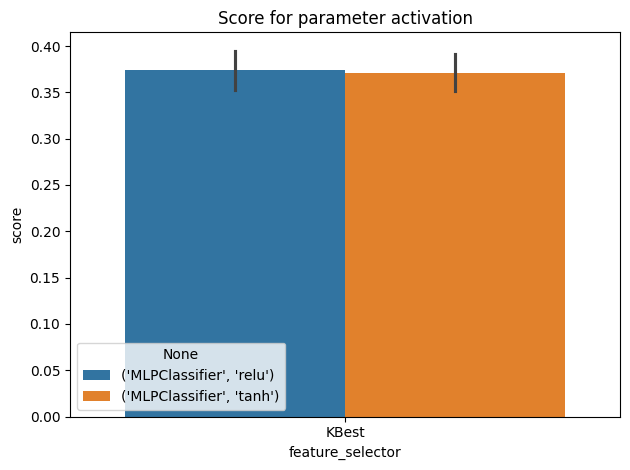

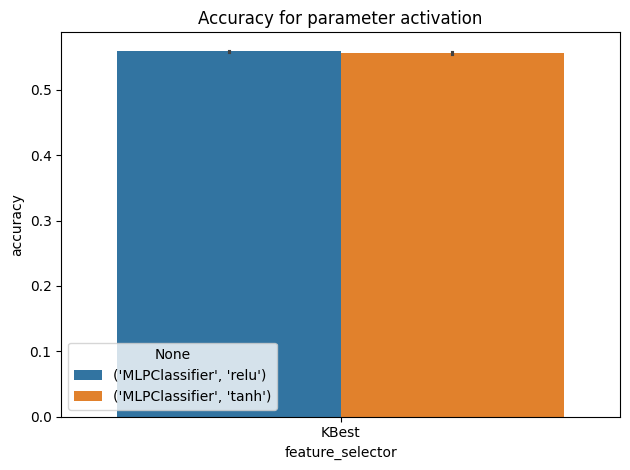

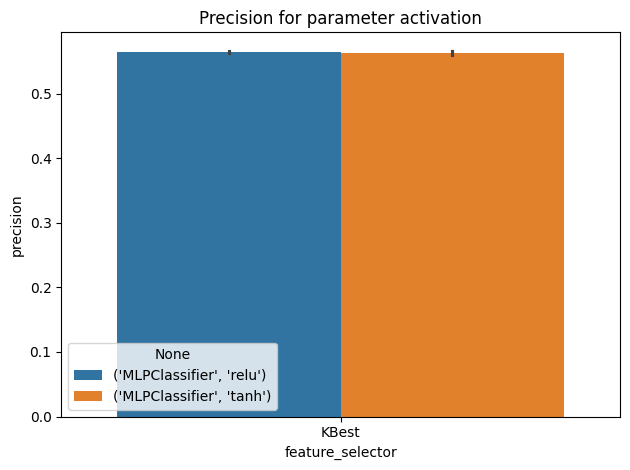

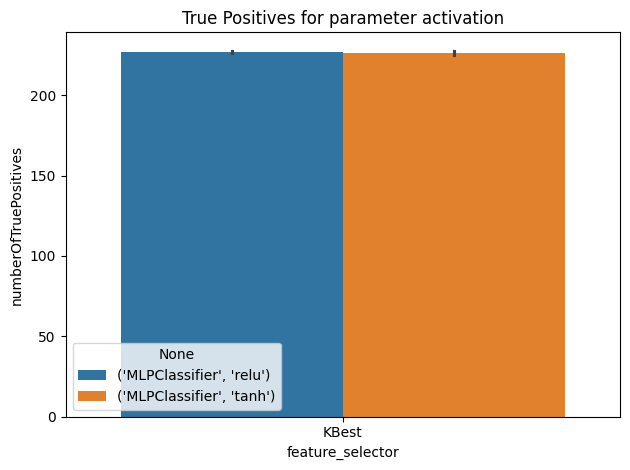

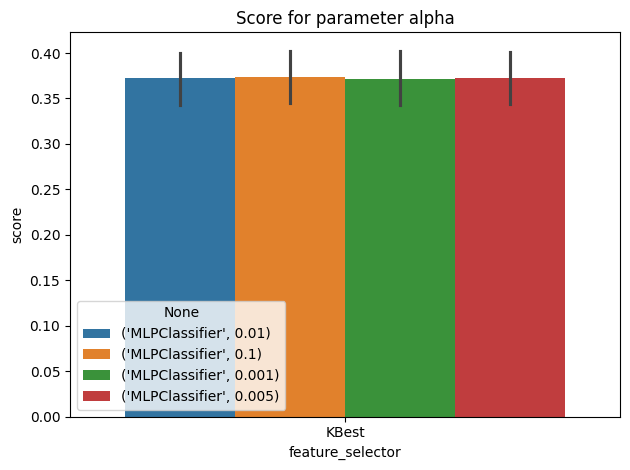

...

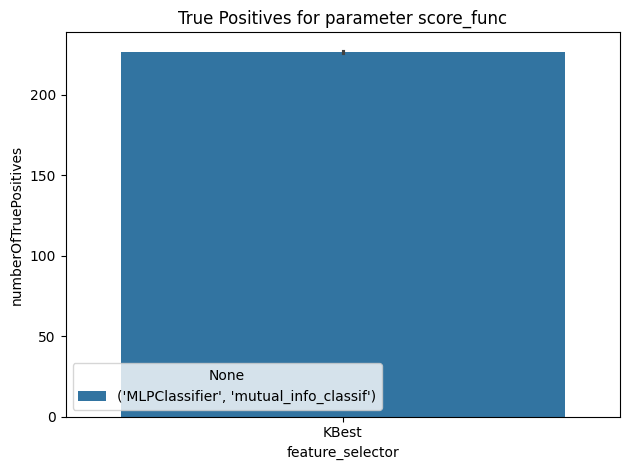

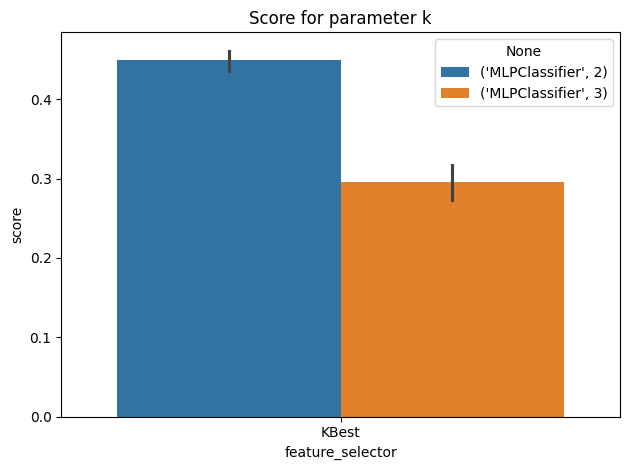

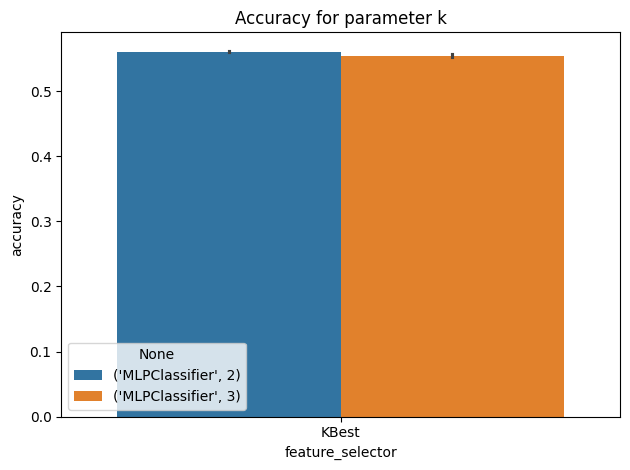

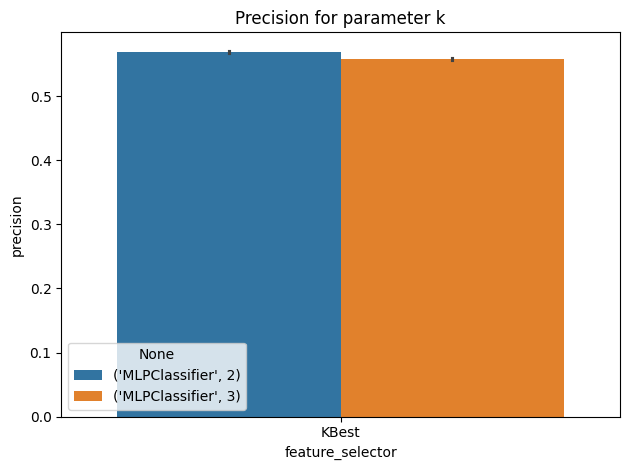

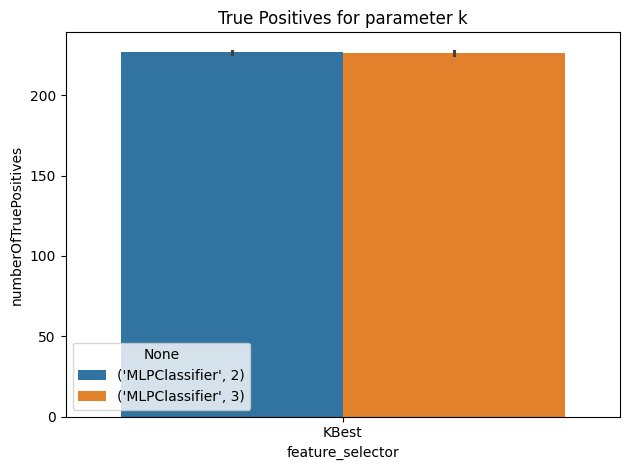

TypeError: boolean value of NA is ambiguous

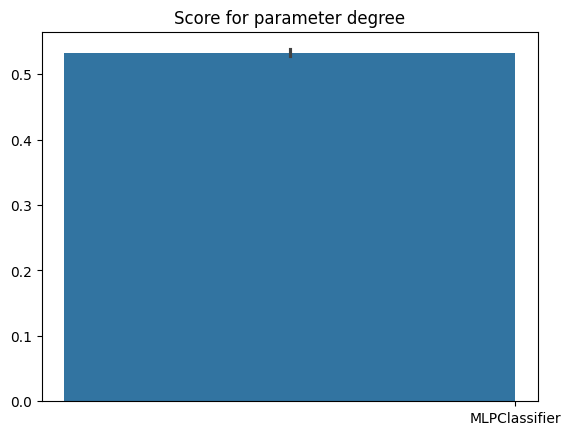

In [13]:
%%time
processedResultsDf, parameters = functions.extractParameterResultsArr(
    resultsDf,
    [models, featureSelectors, scalers, featureGenerators],
    [
        "model_parameters",
        "selector_parameters",
        "scaler_parameters",
        "feature_generator_parameters",
    ],
)
functions.drawParameterResultsBarplot(processedResultsDf, parameters)

### Score/Accuracy by number of features

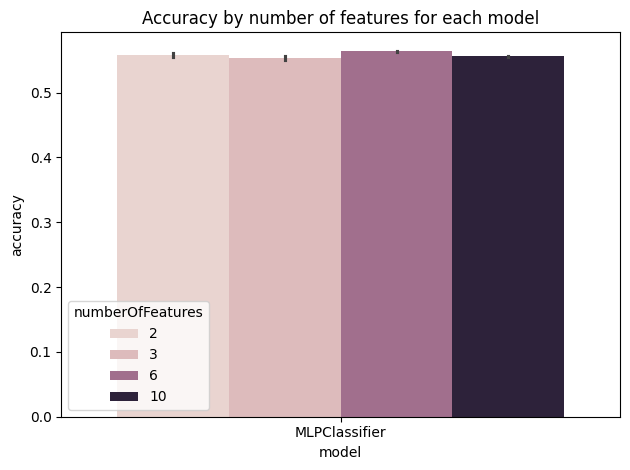

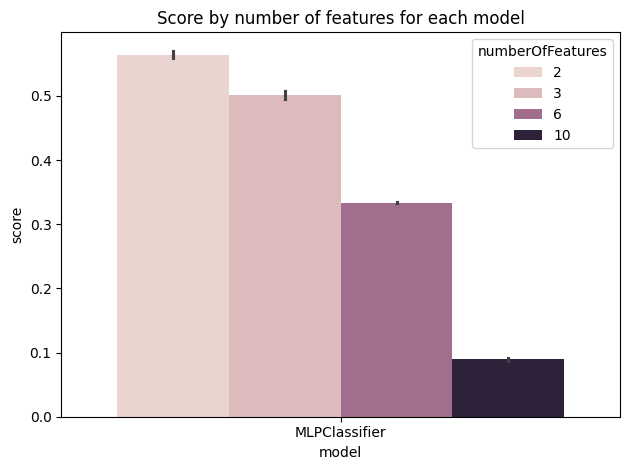

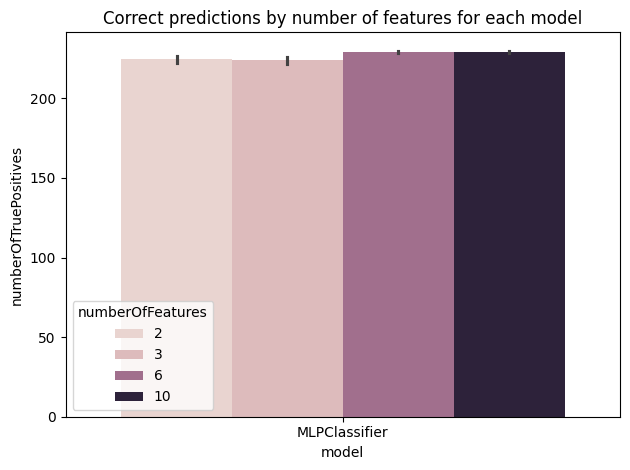

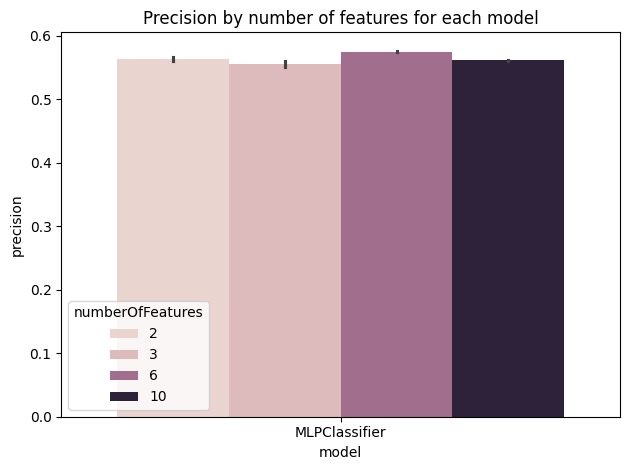

In [14]:
functions.drawResultsPerNumberOfFeatures(processedResultsDf)

### Final Results for Feature Selectors

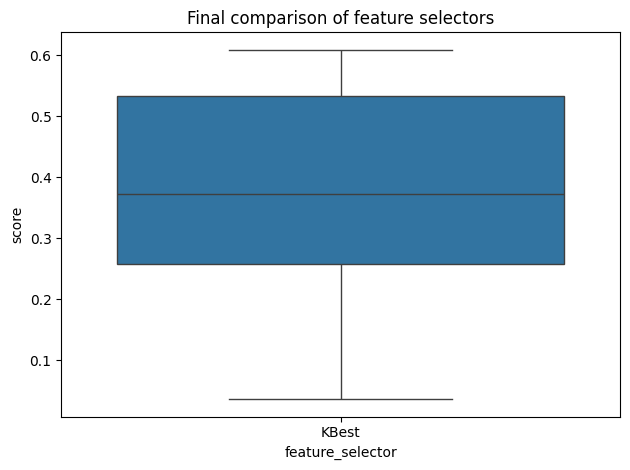

In [15]:
plt.title("Final comparison of feature selectors")
sns.boxplot(data=processedResultsDf, x="feature_selector", y="score")

plt.tight_layout()
plt.show()

<Axes: xlabel='model', ylabel='score'>

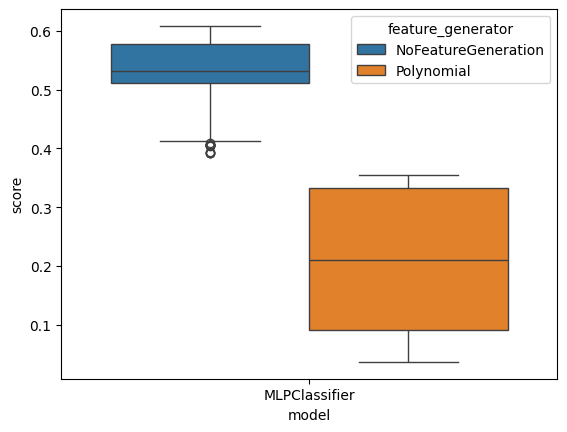

In [16]:
sns.boxplot(data=processedResultsDf, x="model", y="score", hue="feature_generator")

<Axes: xlabel='model', ylabel='score'>

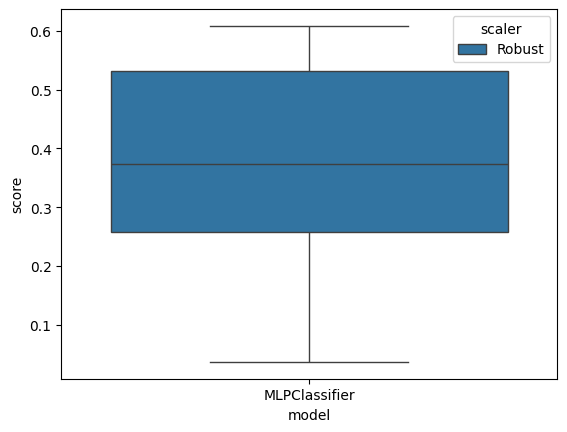

In [17]:
sns.boxplot(data=processedResultsDf, x="model", y="score", hue="scaler")

### Final Results for Models

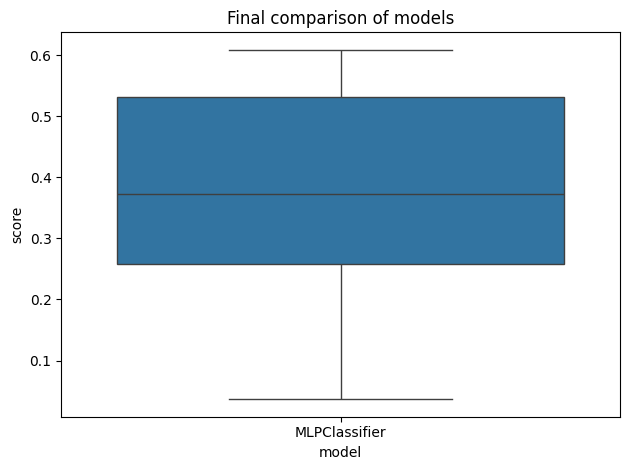

In [18]:
plt.title("Final comparison of models")
sns.boxplot(data=processedResultsDf, x="model", y="score")
plt.tight_layout()
plt.show()

### Final Results

In [19]:
%%time
filteredDf = functions.filterDataframeByBestResults(processedResultsDf)

CPU times: total: 0 ns
Wall time: 927 µs


In [20]:
processedResultsDf[
    processedResultsDf["model"] == functions.ModelType.XGBoost.name
].sort_values(by="score", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k,feature_generator_parameters_degree


In [35]:
processedResultsDf.sort_values(by="numberOfTruePositives", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k,feature_generator_parameters_degree
102,0.608563,239,0.561818,0.576355,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.100,42,adaptive,0.010,"(20,)",1600,adam,mutual_info_classif,2,<NA>
389,0.544343,238,0.559394,0.561210,3,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.005,42,adaptive,0.001,"(30,)",1600,adam,mutual_info_classif,3,<NA>
383,0.544343,238,0.556364,0.552632,3,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.005,42,adaptive,0.010,"(10,)",1600,adam,mutual_info_classif,3,<NA>
523,0.116208,238,0.560606,0.569678,10,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.001,42,adaptive,0.010,"(10,)",1600,adam,mutual_info_classif,3,2
323,0.544343,238,0.558788,0.555000,3,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.010,42,adaptive,0.010,"(10,)",1600,adam,mutual_info_classif,3,<NA>


In [34]:
processedResultsDf[
    processedResultsDf["feature_generator"]
    == functions.FeatureGenerator.Polynomial.name
].sort_values(by="numberOfTruePositives", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k,feature_generator_parameters_degree
523,0.116208,238,0.560606,0.569678,10,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.001,42,adaptive,0.010,"(10,)",1600,adam,mutual_info_classif,3,2
628,0.113150,237,0.561818,0.571649,10,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.005,42,adaptive,0.001,"(10,)",1600,adam,mutual_info_classif,3,2
603,0.113150,237,0.549091,0.555556,10,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.001,42,adaptive,0.010,"(10,)",1600,adam,mutual_info_classif,3,2
568,0.113150,237,0.561818,0.571649,10,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.010,42,adaptive,0.001,"(10,)",1600,adam,mutual_info_classif,3,2
588,0.113150,237,0.563030,0.576244,10,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.100,42,adaptive,0.001,"(10,)",1600,adam,mutual_info_classif,3,2


In [21]:
processedResultsDf[
    processedResultsDf["scaler"] == functions.Scaler.NoScaling.name
].sort_values(by="score", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k,feature_generator_parameters_degree


In [22]:
filteredDf["scaler"]

102    Robust
Name: scaler, dtype: object

In [23]:
filteredDf["model_parameters"].to_numpy()

array([{'activation': 'tanh', 'solver': 'adam', 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.01, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42}],
      dtype=object)

In [24]:
filteredDf["feature_generator"]

102    NoFeatureGeneration
Name: feature_generator, dtype: object

In [25]:
filteredDf

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k,feature_generator_parameters_degree
102,0.608563,239,0.561818,0.576355,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.1,42,adaptive,0.01,"(20,)",1600,adam,mutual_info_classif,2,<NA>


In [26]:
%%time
filteredDf = functions.filterDataframeByBestResults(processedResultsDf)

CPU times: total: 0 ns
Wall time: 999 µs


In [27]:
processedResultsDf[
    processedResultsDf["scaler"] == functions.Scaler.NoScaling.name
].sort_values(by="score", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k,feature_generator_parameters_degree


In [28]:
filteredDf["scaler"]

102    Robust
Name: scaler, dtype: object

In [29]:
filteredDf["model_parameters"].to_numpy()

array([{'activation': 'tanh', 'solver': 'adam', 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.01, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42}],
      dtype=object)

In [30]:
filteredDf["feature_generator"]

102    NoFeatureGeneration
Name: feature_generator, dtype: object

In [31]:
filteredDf

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k,feature_generator_parameters_degree
102,0.608563,239,0.561818,0.576355,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,0.1,42,adaptive,0.01,"(20,)",1600,adam,mutual_info_classif,2,<NA>


# Batch 2

## Consts

In [36]:
RESULTS_FILENAME = "./Results/Limited/MLP/results-2"

## Experiment

### Parameters

In [37]:
# HistGradientBoostingClassifier
learning_rate = [0.1, 0.01]
max_depth = [2, 3, 5, None]
random_state = [42]
max_features = [3, 5, 8, 1.0]
l2_regularization = [0, 0.5, 0.8]
histGradientBoostingParameters = functions.generateParameters(
    [learning_rate, max_depth, random_state, max_features, l2_regularization], globals()
)

# LDA
solver = ["svd", "lsqr"]
shrinkage = [None, "auto"]
n_components = [3, 5, 8, None]
ldaParameters = functions.generateParameters(
    [solver, shrinkage, n_components], globals()
)


# QDA
reg_param = [0, 0.3, 0.5, 0.8]
qdaParameters = functions.generateParameters([reg_param], globals())

# KNN
n_neighbors = [3, 5, 8]
weights = ["uniform", "distance"]
p = [1, 2]
leaf_size = [15, 30, 50]
knnParameters = functions.generateParameters(
    [n_neighbors, weights, p, leaf_size], globals()
)

# SVM
C = [0.5, 1.0, 1.5]
kernel = ["linear", "rbf", "sigmoid", "poly"]
svcParameters = functions.generateParameters([C, kernel], globals())

# GradientBoostingClassifier
loss = ["exponential"]
learning_rate = [0.001]
n_estimators = [800]
min_samples_split = [2]
min_samples_leaf = [5, 7]
subsample = [1.0]
max_depth = [5, 8]
min_impurity_decrease = [1]
random_state = [42]
max_features = [None]
ccp_alpha = [0]
gradientBoostingParameters = functions.generateParameters(
    [
        loss,
        learning_rate,
        n_estimators,
        subsample,
        max_depth,
        random_state,
        max_features,
        ccp_alpha,
        min_samples_split,
        min_samples_leaf,
        min_impurity_decrease,
    ],
    globals(),
)


# MLPClassifier

activation = ["relu", "tanh", "logistic"]
beta_1 = [0.9, 0.95, 0.85]
beta_2 = [0.999, 0.9, 0.95]

solver = ["adam"]
alpha = [0.1, 0.2, 0.15, 0.05]
learning_rate = ["adaptive"]
learning_rate_init = [0.001, 0.005, 0.002, 0.003, 0.004, 0.009, 0.008, 0.007, 0.006]
hidden_layer_sizes = [
    (100,),
    (50,),
    (20,),
    (10,),
    (11,),
    (12,),
    (13,),
    (14,),
    (15,),
    (16,),
    (17,),
    (81,),
    (19,),
    (21,),
    (22,),
    (23,),
    (24,),
    (25,),
    (26,),
    (27,),
    (28,),
    (29,),
    (200,),
]
max_iter = [1600]
random_state = [42]
mlpClassifierParameters = functions.generateParameters(
    [
        activation,
        solver,
        alpha,
        learning_rate,
        learning_rate_init,
        hidden_layer_sizes,
        max_iter,
        random_state,
    ],
    globals(),
)
# Voting?
estimators = [
    [
        (
            "1",
            functions.GradientBoostingClassifier(
                loss="exponential",
                learning_rate=0.01,
                n_estimators=200,
                random_state=42,
            ),
        ),
        ("2", functions.MLPClassifier(max_iter=800, random_state=42)),
        ("3", functions.QuadraticDiscriminantAnalysis()),
    ]
]
voting = ["soft"]

votingParameters = functions.generateParameters([estimators, voting], globals())

# AdaBoost


estimator = [
    functions.GradientBoostingClassifier(
        loss="exponential",
        learning_rate=0.001,
        n_estimators=800,
        random_state=42,
    )
]
estimator = [functions.QuadraticDiscriminantAnalysis()]
n_estimators = [50]
learning_rate = [0.5, 0.1]
random_state = [42]

adaBoostParameters = functions.generateParameters(
    [estimator, n_estimators, learning_rate, random_state], globals()
)

# XGBOOST
max_depth = [2, 3]
eta = [0.001, 0.0001, 0.01]
objective = ["binary:logistic"]
nthread = [4, 2, 8]
eval_metric = ["auc"]
gamma = [0, 2, 10]
min_child_weight = [1, 5, 10]
max_delta_step = [0, 2, 8]
scale_pos_weight = [1, 1.2, 1.5]
refresh_leaf = [0, 1]
process_type = ["defualt", "update"]
num_parallel_tree = [1, 2, 5]
max_leaves = [0, 2, 5]
tree_method = ["exact", "approx", "hist"]

xGBoostParameters = functions.generateParameters(
    [max_depth, eta, objective, nthread, eval_metric], globals()
)


models = [
    # {"model": functions.ModelType.LDA, "parameters": ldaParameters},
    # {"model": functions.ModelType.QDA, "parameters": qdaParameters},
    # {"model": functions.ModelType.KNN, "parameters": knnParameters},
    # {"model": functions.ModelType.SVC, "parameters": svcParameters},
    # {
    #  "model": functions.ModelType.GradientBoosting,
    #  "parameters": gradientBoostingParameters,
    # },
    # {
    #     "model": functions.ModelType.HistGradientBoosting,
    #     "parameters": histGradientBoostingParameters,
    # },
    {"model": functions.ModelType.MLPClassifier, "parameters": mlpClassifierParameters},
    # {"model": functions.ModelType.ADABoost, "parameters": adaBoostParameters},
    # {"model": functions.ModelType.Voting, "parameters": votingParameters},
    # {"model": functions.ModelType.XGBoost, "parameters": xGBoostParameters},
]

In [38]:
# KBest
k = [2, 3]
score_func = [mutual_info_classif]
kBestParameters = functions.generateParameters([score_func, k], globals())

# FPR

# mutual_info_classif seems to break for FPR but maybe try to run these without StandardScaler?
score_func = [f_classif]
alpha = [0.01]
fprParameters = functions.generateParameters([score_func, alpha], globals())


# RFE
estimator = [SVC(kernel="linear")]
n_features_to_select = [2, 3]
step = [0.9]
rfeParameters = functions.generateParameters(
    [estimator, n_features_to_select, step], globals()
)


featureSelectors = [
    {"model": functions.FeatureSelectorType.KBest, "parameters": kBestParameters},
    # {"model": functions.FeatureSelectorType.FPR, "parameters": fprParameters},
    # {"model": functions.FeatureSelectorType.RFE, "parameters": rfeParameters},
]

In [39]:
scalers = [
    # {"model": functions.Scaler.NoScaling, "parameters": [{}]},
    # {"model": functions.Scaler.Standard, "parameters": [{}]},
    {"model": functions.Scaler.Robust, "parameters": [{}]},
]

degree = [2]

polynomialParameters = functions.generateParameters([degree], globals())

featureGenerators = [
    {"model": functions.FeatureGenerator.NoFeatureGeneration, "parameters": [{}]},
    # {
    #   "model": functions.FeatureGenerator.Polynomial,
    #  "parameters": polynomialParameters,
    # },
]

### Conducting the experiment

In [40]:
y_train_ravel = np.ravel(y_train, order="C")
y_train_ravel = y_train_ravel.astype(int)

In [41]:
%%time
results = functions.conductExperimentsWithScalersAndGenerators(
    models=models,
    featureSelectors=featureSelectors,
    X_orig=X_train,
    y_orig=y_train_ravel,
    scalers=scalers,
    featureGenerators=featureGenerators,
    getLimitedScore=True,
    limit=0.45,
)
with open(RESULTS_FILENAME, "wb") as f:
    pickle.dump(results, f)

Performed Experiment 1/3312(approx) took (s): model: 0.67 selector 6.38 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x0000019AD6864900>, 'k': 2} ModelType.MLPClassifier {'activation': 'relu', 'solver': 'adam', 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 2/3312(approx) took (s): model: 0.33 selector 6.38 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x0000019AD6864900>, 'k': 2} ModelType.MLPClassifier {'activation': 'relu', 'solver': 'adam', 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 3/3312(approx) took (s): model: 0.1 selector 6.38 with: FeatureSelectorType.KBest {'score_func

## Results

In [42]:
with open(RESULTS_FILENAME, "rb") as input_file:
    results = pickle.load(input_file)

In [43]:
resultsDf = pd.DataFrame(
    results,
    columns=functions.RESULTS_COLUMNS,
)

### Detailed Results

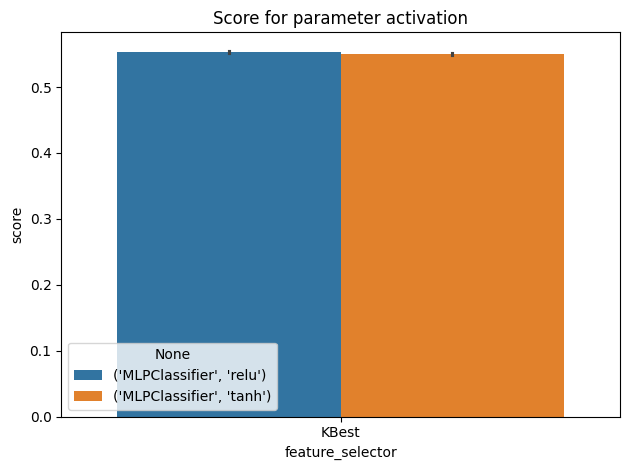

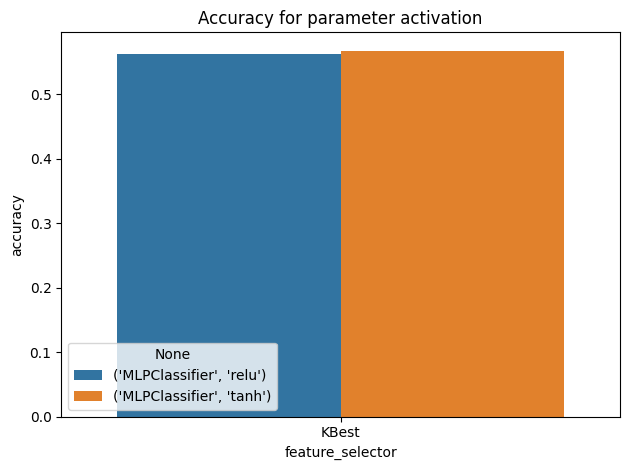

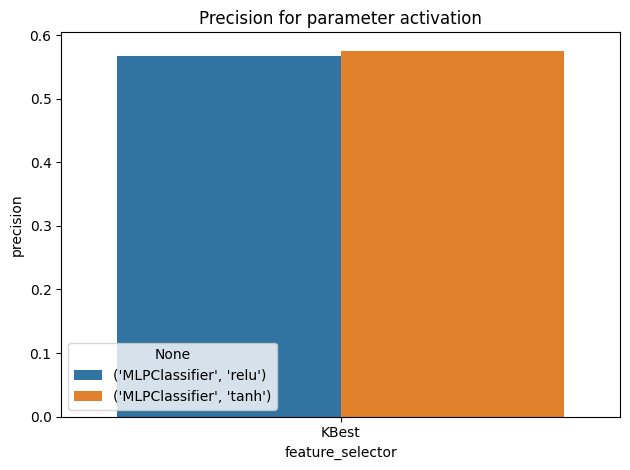

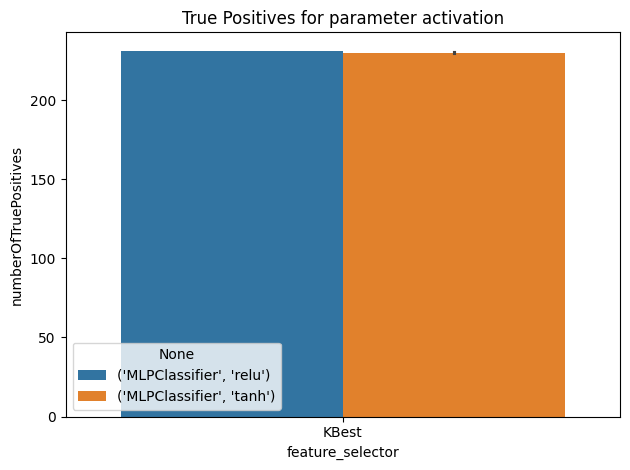

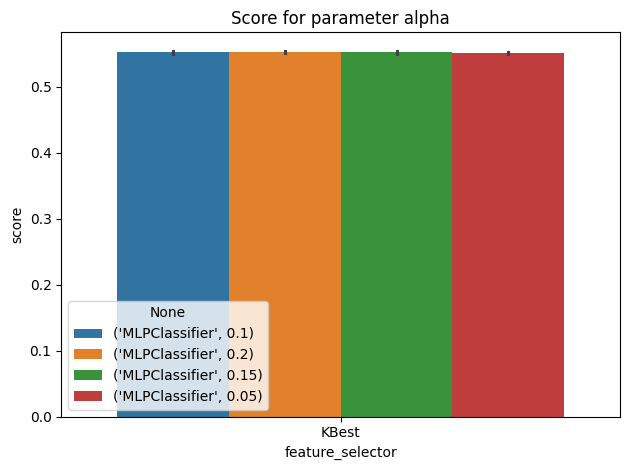

...

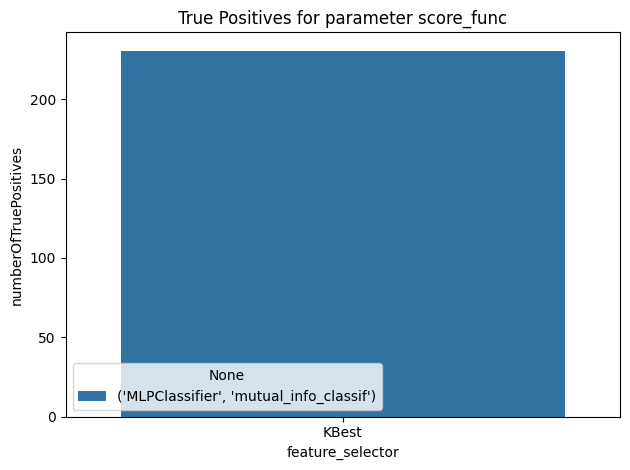

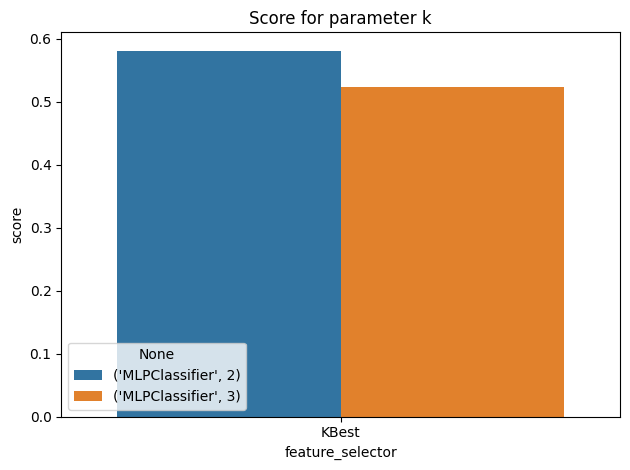

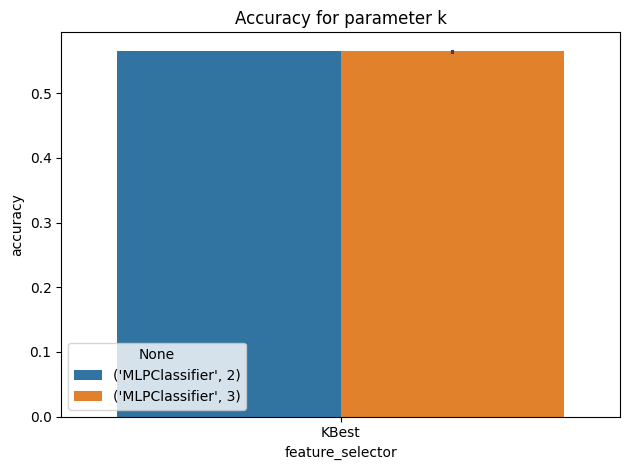

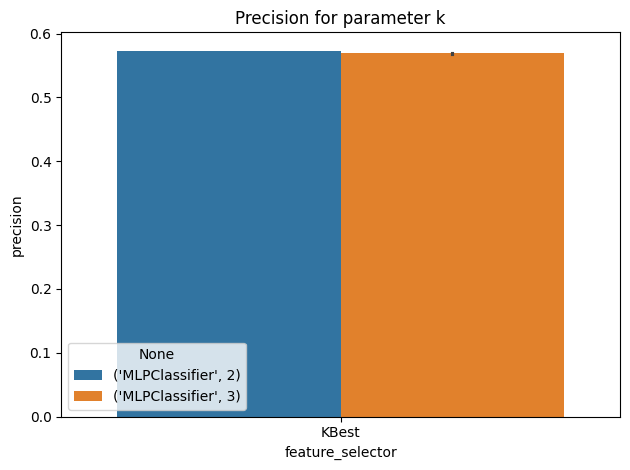

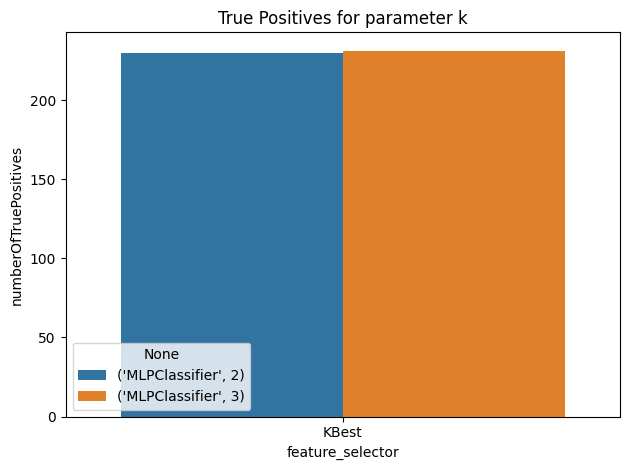

CPU times: total: 4.97 s
Wall time: 10.5 s


In [44]:
%%time
processedResultsDf, parameters = functions.extractParameterResultsArr(
    resultsDf,
    [models, featureSelectors, scalers, featureGenerators],
    [
        "model_parameters",
        "selector_parameters",
        "scaler_parameters",
        "feature_generator_parameters",
    ],
)
functions.drawParameterResultsBarplot(processedResultsDf, parameters)

### Score/Accuracy by number of features

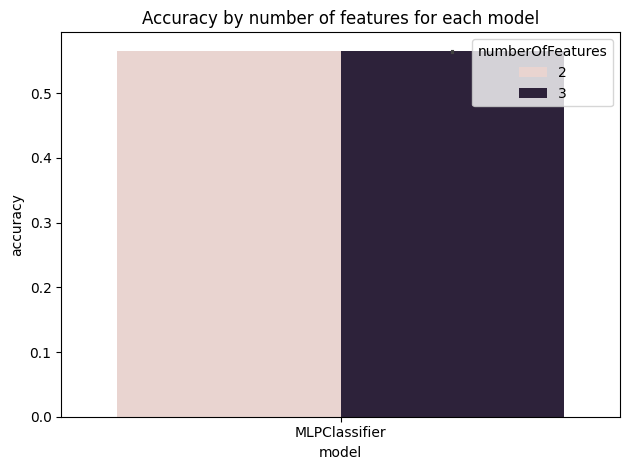

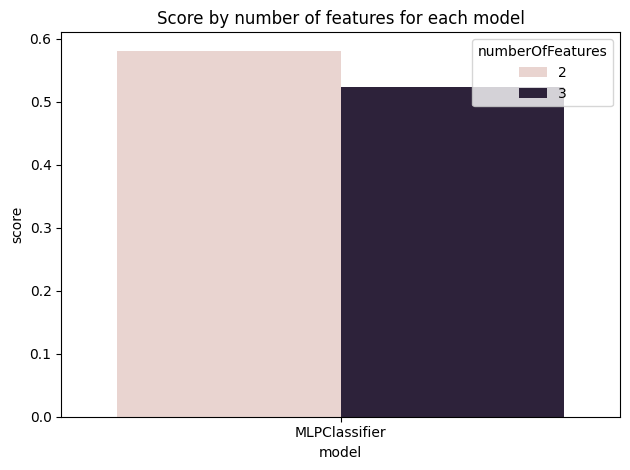

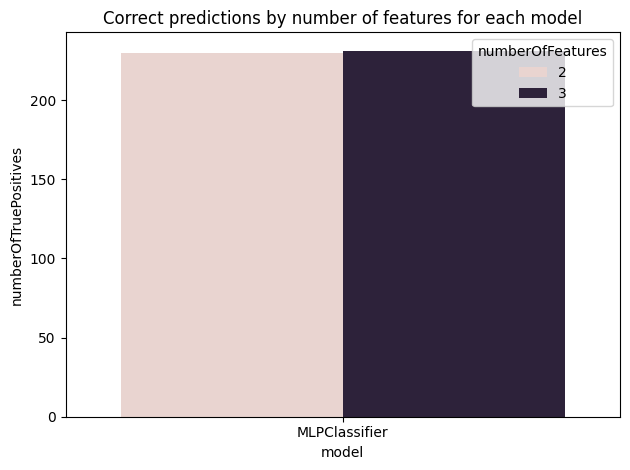

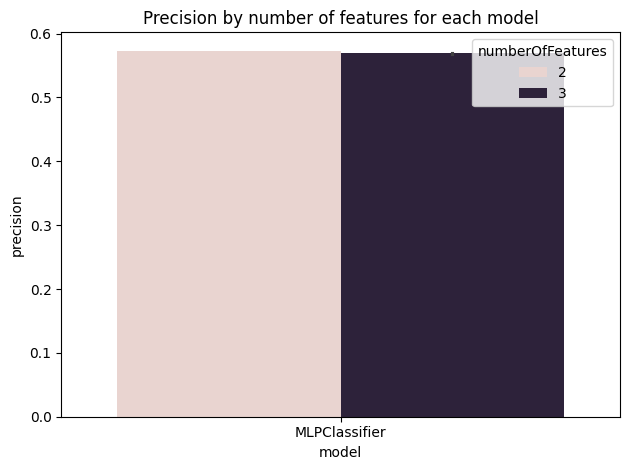

In [45]:
functions.drawResultsPerNumberOfFeatures(processedResultsDf)

### Final Results for Feature Selectors

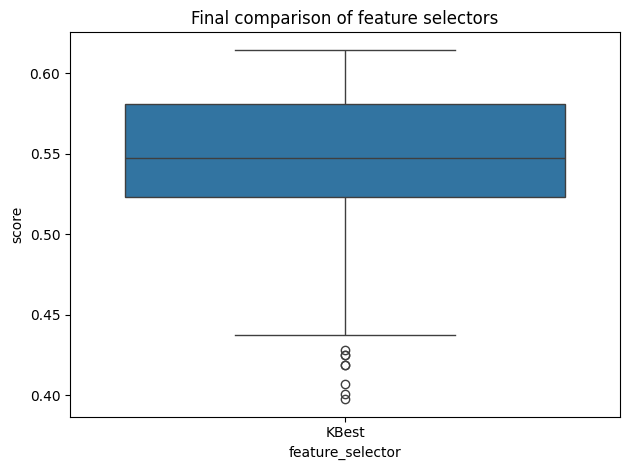

In [46]:
plt.title("Final comparison of feature selectors")
sns.boxplot(data=processedResultsDf, x="feature_selector", y="score")

plt.tight_layout()
plt.show()

<Axes: xlabel='model', ylabel='score'>

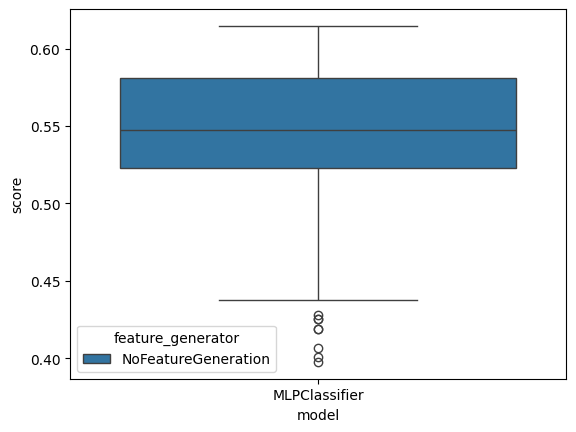

In [47]:
sns.boxplot(data=processedResultsDf, x="model", y="score", hue="feature_generator")

<Axes: xlabel='model', ylabel='score'>

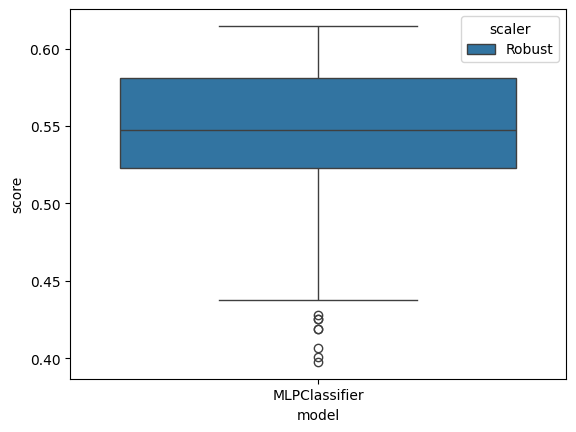

In [48]:
sns.boxplot(data=processedResultsDf, x="model", y="score", hue="scaler")

### Final Results for Models

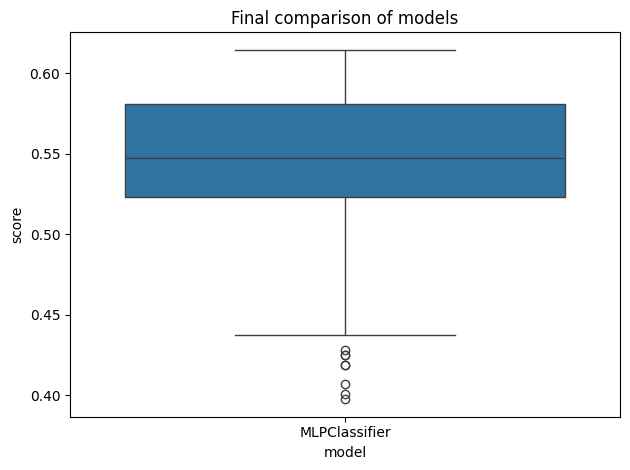

In [49]:
plt.title("Final comparison of models")
sns.boxplot(data=processedResultsDf, x="model", y="score")
plt.tight_layout()
plt.show()

### Final Results

In [50]:
%%time
filteredDf = functions.filterDataframeByBestResults(processedResultsDf)

CPU times: total: 0 ns
Wall time: 1.97 ms


In [51]:
processedResultsDf[
    processedResultsDf["model"] == functions.ModelType.XGBoost.name
].sort_values(by="score", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k


In [52]:
processedResultsDf.sort_values(by="numberOfTruePositives", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k
1357,0.614679,241,0.566061,0.605042,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,0.15,42,adaptive,0.009,"(100,)",1600,adam,mutual_info_classif,2
1173,0.611621,240,0.565455,0.600815,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,0.20,42,adaptive,0.008,"(100,)",1600,adam,mutual_info_classif,2
2015,0.550459,240,0.565455,0.571843,3,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,0.20,42,adaptive,0.008,"(22,)",1600,adam,mutual_info_classif,3
1697,0.550459,240,0.556970,0.563910,3,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,0.10,42,adaptive,0.005,"(26,)",1600,adam,mutual_info_classif,3
1942,0.550459,240,0.559394,0.561549,3,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,0.20,42,adaptive,0.003,"(17,)",1600,adam,mutual_info_classif,3


In [53]:
processedResultsDf[
    processedResultsDf["feature_generator"]
    == functions.FeatureGenerator.Polynomial.name
].sort_values(by="numberOfTruePositives", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k


In [54]:
processedResultsDf[
    processedResultsDf["scaler"] == functions.Scaler.NoScaling.name
].sort_values(by="score", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k


In [55]:
filteredDf["scaler"]

1357    Robust
Name: scaler, dtype: object

In [56]:
filteredDf["model_parameters"].to_numpy()

array([{'activation': 'tanh', 'solver': 'adam', 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42}],
      dtype=object)

In [57]:
filteredDf["feature_generator"]

1357    NoFeatureGeneration
Name: feature_generator, dtype: object

In [58]:
filteredDf

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k
1357,0.614679,241,0.566061,0.605042,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,0.15,42,adaptive,0.009,"(100,)",1600,adam,mutual_info_classif,2


In [59]:
%%time
filteredDf = functions.filterDataframeByBestResults(processedResultsDf)

CPU times: total: 0 ns
Wall time: 2.06 ms


In [60]:
processedResultsDf[
    processedResultsDf["scaler"] == functions.Scaler.NoScaling.name
].sort_values(by="score", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k


In [61]:
filteredDf["scaler"]

1357    Robust
Name: scaler, dtype: object

In [62]:
filteredDf["model_parameters"].to_numpy()

array([{'activation': 'tanh', 'solver': 'adam', 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42}],
      dtype=object)

In [63]:
filteredDf["feature_generator"]

1357    NoFeatureGeneration
Name: feature_generator, dtype: object

In [64]:
filteredDf

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_alpha,model_parameters_random_state,model_parameters_learning_rate,model_parameters_learning_rate_init,model_parameters_hidden_layer_sizes,model_parameters_max_iter,model_parameters_solver,selector_parameters_score_func,selector_parameters_k
1357,0.614679,241,0.566061,0.605042,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'alph...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,0.15,42,adaptive,0.009,"(100,)",1600,adam,mutual_info_classif,2


# Batch 3

## Consts

In [5]:
RESULTS_FILENAME = "./Results/Limited/MLP/results-3"

## Experiment

### Parameters

In [6]:
# HistGradientBoostingClassifier
learning_rate = [0.1, 0.01]
max_depth = [2, 3, 5, None]
random_state = [42]
max_features = [3, 5, 8, 1.0]
l2_regularization = [0, 0.5, 0.8]
histGradientBoostingParameters = functions.generateParameters(
    [learning_rate, max_depth, random_state, max_features, l2_regularization], globals()
)

# LDA
solver = ["svd", "lsqr"]
shrinkage = [None, "auto"]
n_components = [3, 5, 8, None]
ldaParameters = functions.generateParameters(
    [solver, shrinkage, n_components], globals()
)


# QDA
reg_param = [0, 0.3, 0.5, 0.8]
qdaParameters = functions.generateParameters([reg_param], globals())

# KNN
n_neighbors = [3, 5, 8]
weights = ["uniform", "distance"]
p = [1, 2]
leaf_size = [15, 30, 50]
knnParameters = functions.generateParameters(
    [n_neighbors, weights, p, leaf_size], globals()
)

# SVM
C = [0.5, 1.0, 1.5]
kernel = ["linear", "rbf", "sigmoid", "poly"]
svcParameters = functions.generateParameters([C, kernel], globals())

# GradientBoostingClassifier
loss = ["exponential"]
learning_rate = [0.001]
n_estimators = [800]
min_samples_split = [2]
min_samples_leaf = [5, 7]
subsample = [1.0]
max_depth = [5, 8]
min_impurity_decrease = [1]
random_state = [42]
max_features = [None]
ccp_alpha = [0]
gradientBoostingParameters = functions.generateParameters(
    [
        loss,
        learning_rate,
        n_estimators,
        subsample,
        max_depth,
        random_state,
        max_features,
        ccp_alpha,
        min_samples_split,
        min_samples_leaf,
        min_impurity_decrease,
    ],
    globals(),
)


# MLPClassifier

activation = ["relu", "tanh", "logistic"]
beta_1 = [0.9, 0.95, 0.85]
beta_2 = [0.999, 0.9, 0.95]

solver = ["adam"]
alpha = [0.1, 0.2, 0.3, 0.4, 0.15, 0.05]
learning_rate = ["adaptive"]
learning_rate_init = [0.001, 0.005, 0.002, 0.003, 0.004, 0.009, 0.008, 0.007, 0.006]
hidden_layer_sizes = [
    (100,),
    (50,),
    (20,),
    (10,),
    (11,),
    (12,),
    (13,),
    (14,),
    (15,),
    (16,),
    (17,),
    (81,),
    (19,),
    (21,),
    (22,),
    (23,),
    (24,),
    (25,),
    (26,),
    (27,),
    (28,),
    (29,),
    (200,),
    (300,),
]
max_iter = [1600]
random_state = [42]
mlpClassifierParameters = functions.generateParameters(
    [
        activation,
        solver,
        beta_1,
        beta_2,
        alpha,
        learning_rate,
        learning_rate_init,
        hidden_layer_sizes,
        max_iter,
        random_state,
    ],
    globals(),
)
# Voting?
estimators = [
    [
        (
            "1",
            functions.GradientBoostingClassifier(
                loss="exponential",
                learning_rate=0.01,
                n_estimators=200,
                random_state=42,
            ),
        ),
        ("2", functions.MLPClassifier(max_iter=800, random_state=42)),
        ("3", functions.QuadraticDiscriminantAnalysis()),
    ]
]
voting = ["soft"]

votingParameters = functions.generateParameters([estimators, voting], globals())

# AdaBoost


estimator = [
    functions.GradientBoostingClassifier(
        loss="exponential",
        learning_rate=0.001,
        n_estimators=800,
        random_state=42,
    )
]
estimator = [functions.QuadraticDiscriminantAnalysis()]
n_estimators = [50]
learning_rate = [0.5, 0.1]
random_state = [42]

adaBoostParameters = functions.generateParameters(
    [estimator, n_estimators, learning_rate, random_state], globals()
)

# XGBOOST
max_depth = [2, 3]
eta = [0.001, 0.0001, 0.01]
objective = ["binary:logistic"]
nthread = [4, 2, 8]
eval_metric = ["auc"]
gamma = [0, 2, 10]
min_child_weight = [1, 5, 10]
max_delta_step = [0, 2, 8]
scale_pos_weight = [1, 1.2, 1.5]
refresh_leaf = [0, 1]
process_type = ["defualt", "update"]
num_parallel_tree = [1, 2, 5]
max_leaves = [0, 2, 5]
tree_method = ["exact", "approx", "hist"]

xGBoostParameters = functions.generateParameters(
    [max_depth, eta, objective, nthread, eval_metric], globals()
)


models = [
    # {"model": functions.ModelType.LDA, "parameters": ldaParameters},
    # {"model": functions.ModelType.QDA, "parameters": qdaParameters},
    # {"model": functions.ModelType.KNN, "parameters": knnParameters},
    # {"model": functions.ModelType.SVC, "parameters": svcParameters},
    # {
    #  "model": functions.ModelType.GradientBoosting,
    #  "parameters": gradientBoostingParameters,
    # },
    # {
    #     "model": functions.ModelType.HistGradientBoosting,
    #     "parameters": histGradientBoostingParameters,
    # },
    {"model": functions.ModelType.MLPClassifier, "parameters": mlpClassifierParameters},
    # {"model": functions.ModelType.ADABoost, "parameters": adaBoostParameters},
    # {"model": functions.ModelType.Voting, "parameters": votingParameters},
    # {"model": functions.ModelType.XGBoost, "parameters": xGBoostParameters},
]

In [7]:
# KBest
k = [2, 3]
score_func = [mutual_info_classif]
kBestParameters = functions.generateParameters([score_func, k], globals())

# FPR

# mutual_info_classif seems to break for FPR but maybe try to run these without StandardScaler?
score_func = [f_classif]
alpha = [0.01]
fprParameters = functions.generateParameters([score_func, alpha], globals())


# RFE
estimator = [SVC(kernel="linear")]
n_features_to_select = [2, 3]
step = [0.9]
rfeParameters = functions.generateParameters(
    [estimator, n_features_to_select, step], globals()
)


featureSelectors = [
    {"model": functions.FeatureSelectorType.KBest, "parameters": kBestParameters},
    # {"model": functions.FeatureSelectorType.FPR, "parameters": fprParameters},
    # {"model": functions.FeatureSelectorType.RFE, "parameters": rfeParameters},
]

In [8]:
scalers = [
    # {"model": functions.Scaler.NoScaling, "parameters": [{}]},
    # {"model": functions.Scaler.Standard, "parameters": [{}]},
    {"model": functions.Scaler.Robust, "parameters": [{}]},
]

degree = [2]

polynomialParameters = functions.generateParameters([degree], globals())

featureGenerators = [
    {"model": functions.FeatureGenerator.NoFeatureGeneration, "parameters": [{}]},
    # {
    #   "model": functions.FeatureGenerator.Polynomial,
    #  "parameters": polynomialParameters,
    # },
]

### Conducting the experiment

In [9]:
y_train_ravel = np.ravel(y_train, order="C")
y_train_ravel = y_train_ravel.astype(int)

In [10]:
%%time
results = functions.conductExperimentsWithScalersAndGenerators(
    models=models,
    featureSelectors=featureSelectors,
    X_orig=X_train,
    y_orig=y_train_ravel,
    scalers=scalers,
    featureGenerators=featureGenerators,
    getLimitedScore=True,
    limit=0.45,
)
with open(RESULTS_FILENAME, "wb") as f:
    pickle.dump(results, f)

Performed Experiment 1/69984(approx) took (s): model: 2.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'relu', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 2/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'relu', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 3/69984(approx) took (s): 

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 18504/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'tanh', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 18505/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'tanh', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 18506/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 18960/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'tanh', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 18961/69984(approx) took (s): model: 0.89 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'tanh', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 18962/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23354/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23355/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23356/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23358/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23359/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23360/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23373/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23374/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23375/69984(approx) took (s): model: 1.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23376/69984(approx) took (s): model: 2.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23377/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23378/69984(approx) took (s): model: 0.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23379/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23399/69984(approx) took (s): model: 1.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23400/69984(approx) took (s): model: 1.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23401/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23402/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23420/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23421/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23422/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23424/69984(approx) took (s): model: 1.96 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23425/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23426/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23436/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23437/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23438/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23444/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23445/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23446/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23450/69984(approx) took (s): model: 0.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23451/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23452/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23465/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23466/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23467/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23468/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23469/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23471/69984(approx) took (s): model: 2.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23472/69984(approx) took (s): model: 1.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23473/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23474/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23475/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23476/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23492/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23493/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23494/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23496/69984(approx) took (s): model: 3.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23497/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23498/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23499/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23500/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23510/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23511/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23512/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23516/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23517/69984(approx) took (s): model: 0.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23518/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23519/69984(approx) took (s): model: 1.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23520/69984(approx) took (s): model: 1.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23521/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23522/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23523/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23524/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23534/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23535/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23536/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23540/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23541/69984(approx) took (s): model: 0.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23542/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23543/69984(approx) took (s): model: 1.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23544/69984(approx) took (s): model: 1.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23545/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23546/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23570/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23571/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23572/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23574/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23575/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23576/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23588/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23589/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23590/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23591/69984(approx) took (s): model: 1.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23592/69984(approx) took (s): model: 2.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23593/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23594/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23595/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23615/69984(approx) took (s): model: 0.9 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23616/69984(approx) took (s): model: 1.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23617/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23618/69984(approx) took (s): model: 0.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23619/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23620/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23636/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23637/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23638/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23640/69984(approx) took (s): model: 2.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23641/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23642/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23646/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23647/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23648/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23652/69984(approx) took (s): model: 0.79 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23653/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23654/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23661/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23662/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23663/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23666/69984(approx) took (s): model: 0.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23667/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23668/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23678/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23679/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23680/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23681/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23682/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23684/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23685/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23686/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23687/69984(approx) took (s): model: 2.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23688/69984(approx) took (s): model: 1.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23689/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23690/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23691/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23692/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23707/69984(approx) took (s): model: 0.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23708/69984(approx) took (s): model: 0.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23709/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23712/69984(approx) took (s): model: 2.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23713/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23714/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23715/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23716/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23726/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23727/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23728/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23732/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23733/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23734/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23735/69984(approx) took (s): model: 1.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23736/69984(approx) took (s): model: 2.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23737/69984(approx) took (s): model: 0.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23738/69984(approx) took (s): model: 0.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23739/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23740/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23743/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23744/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23745/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23750/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23751/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23752/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23755/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23756/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23757/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23758/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23759/69984(approx) took (s): model: 1.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23760/69984(approx) took (s): model: 1.95 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23761/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23762/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23786/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23787/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23788/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23792/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23793/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23794/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23795/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23796/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23804/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23805/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23806/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23807/69984(approx) took (s): model: 1.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23808/69984(approx) took (s): model: 2.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23809/69984(approx) took (s): model: 1.02 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23810/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23811/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23830/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23831/69984(approx) took (s): model: 1.05 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23832/69984(approx) took (s): model: 1.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23833/69984(approx) took (s): model: 1.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23834/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23835/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23836/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23852/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23853/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23854/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23856/69984(approx) took (s): model: 2.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23857/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23858/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23862/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23863/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23864/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23868/69984(approx) took (s): model: 0.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23869/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23870/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23871/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23872/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23877/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23878/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23879/69984(approx) took (s): model: 1.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23880/69984(approx) took (s): model: 1.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23881/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23882/69984(approx) took (s): model: 0.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23883/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23884/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23894/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23895/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23896/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23897/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23898/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23900/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23901/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23902/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23903/69984(approx) took (s): model: 2.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23904/69984(approx) took (s): model: 1.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23905/69984(approx) took (s): model: 0.92 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23906/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23907/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23908/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23918/69984(approx) took (s): model: 0.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23919/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23920/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23921/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23924/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23925/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23926/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23928/69984(approx) took (s): model: 2.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23929/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23930/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23931/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23932/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23942/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23943/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23944/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23946/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23947/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23948/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23949/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23950/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23951/69984(approx) took (s): model: 1.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23952/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23953/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23954/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23955/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23956/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23959/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23960/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23961/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23966/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23967/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23968/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23969/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23970/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23971/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23972/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23973/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23975/69984(approx) took (s): model: 1.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 23976/69984(approx) took (s): model: 1.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23977/69984(approx) took (s): model: 0.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 23978/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24001/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24002/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24003/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24004/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24007/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24008/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24009/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24010/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24011/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24019/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24020/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24021/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24023/69984(approx) took (s): model: 1.93 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24024/69984(approx) took (s): model: 2.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24025/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24026/69984(approx) took (s): model: 0.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24027/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24047/69984(approx) took (s): model: 1.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24048/69984(approx) took (s): model: 1.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24049/69984(approx) took (s): model: 1.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24050/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24051/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24052/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24069/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24070/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24071/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24072/69984(approx) took (s): model: 1.79 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24073/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24074/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24079/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24080/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24081/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24084/69984(approx) took (s): model: 1.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24085/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24086/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24087/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24088/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24093/69984(approx) took (s): model: 0.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24094/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24095/69984(approx) took (s): model: 1.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24096/69984(approx) took (s): model: 1.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24097/69984(approx) took (s): model: 1.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24098/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24099/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24100/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24101/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24102/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24110/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24111/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24112/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24113/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24114/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24116/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24117/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24118/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24119/69984(approx) took (s): model: 2.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24120/69984(approx) took (s): model: 1.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24121/69984(approx) took (s): model: 1.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24122/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24123/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24124/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24134/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24135/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24136/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24139/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24140/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24141/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24144/69984(approx) took (s): model: 3.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24145/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24146/69984(approx) took (s): model: 0.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24147/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24148/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24158/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24159/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24160/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24162/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24163/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24164/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24165/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24166/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24167/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24168/69984(approx) took (s): model: 1.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24169/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24170/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24171/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24172/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24175/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24176/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24177/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24182/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24183/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24184/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24185/69984(approx) took (s): model: 0.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24186/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24187/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24188/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24189/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24191/69984(approx) took (s): model: 1.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24192/69984(approx) took (s): model: 1.98 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24193/69984(approx) took (s): model: 0.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24194/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24218/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24219/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24220/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24222/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24223/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24224/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24236/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24237/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24238/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24239/69984(approx) took (s): model: 1.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24240/69984(approx) took (s): model: 2.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24241/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24242/69984(approx) took (s): model: 0.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24243/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24263/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24264/69984(approx) took (s): model: 1.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24265/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24266/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24284/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24285/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24286/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24288/69984(approx) took (s): model: 1.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24289/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24290/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24296/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24297/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24298/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24300/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24301/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24302/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24309/69984(approx) took (s): model: 0.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24310/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24311/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24314/69984(approx) took (s): model: 0.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24315/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24316/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24326/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24327/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24328/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24329/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24330/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24332/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24333/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24334/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24335/69984(approx) took (s): model: 2.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24336/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24337/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24338/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24339/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24340/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24356/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24357/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24358/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24360/69984(approx) took (s): model: 2.88 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24361/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24362/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24363/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24364/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24374/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24375/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24376/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24380/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24381/69984(approx) took (s): model: 0.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24382/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24383/69984(approx) took (s): model: 1.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24384/69984(approx) took (s): model: 1.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24385/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24386/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24387/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24388/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24391/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24392/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24393/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24398/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24399/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24400/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24403/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24404/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24405/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24407/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24408/69984(approx) took (s): model: 1.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24409/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24410/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24434/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24435/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24436/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24439/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24440/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24441/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24453/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24454/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24455/69984(approx) took (s): model: 1.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24456/69984(approx) took (s): model: 2.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24457/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24458/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24459/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24479/69984(approx) took (s): model: 0.92 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24480/69984(approx) took (s): model: 1.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24481/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24482/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24499/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24500/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24501/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24504/69984(approx) took (s): model: 1.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24505/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24506/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24516/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24517/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24518/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24524/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24525/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24526/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24530/69984(approx) took (s): model: 0.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24531/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24532/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24540/69984(approx) took (s): model: 0.93 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24541/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24542/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24544/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24545/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24546/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24548/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24549/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24550/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24551/69984(approx) took (s): model: 3.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24552/69984(approx) took (s): model: 1.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24553/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24554/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24555/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24568/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24569/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24570/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24572/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24573/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24574/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24576/69984(approx) took (s): model: 3.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24577/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24578/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24579/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24580/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24590/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24591/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24592/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24596/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24597/69984(approx) took (s): model: 0.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24598/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24599/69984(approx) took (s): model: 1.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24600/69984(approx) took (s): model: 1.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24601/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24602/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24603/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24604/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24614/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24615/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24616/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24620/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24621/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24622/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24623/69984(approx) took (s): model: 1.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24624/69984(approx) took (s): model: 1.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24625/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24626/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24650/69984(approx) took (s): model: 0.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24651/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24652/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24654/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24655/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24656/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24660/69984(approx) took (s): model: 0.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24661/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24662/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24667/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24668/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24669/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24672/69984(approx) took (s): model: 0.97 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24673/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24674/69984(approx) took (s): model: 0.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24675/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24720/69984(approx) took (s): model: 1.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24721/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24722/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24741/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24742/69984(approx) took (s): model: 0.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24743/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24744/69984(approx) took (s): model: 1.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24745/69984(approx) took (s): model: 1.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24746/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24747/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24748/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24754/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24755/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24756/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24758/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24759/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24760/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24765/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24766/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24767/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24768/69984(approx) took (s): model: 1.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24769/69984(approx) took (s): model: 1.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24770/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24771/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24772/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24788/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24789/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24790/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24791/69984(approx) took (s): model: 2.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24792/69984(approx) took (s): model: 1.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24793/69984(approx) took (s): model: 0.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24794/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24795/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24796/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24812/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24813/69984(approx) took (s): model: 0.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24814/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24815/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24816/69984(approx) took (s): model: 1.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24817/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24818/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24819/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24820/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24822/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24823/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24824/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24830/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24831/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24832/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24836/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24837/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24838/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24839/69984(approx) took (s): model: 1.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24840/69984(approx) took (s): model: 2.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24841/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24842/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24866/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24867/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24868/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24870/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24871/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24872/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24873/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24874/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24876/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24877/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24878/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24883/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24884/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24885/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24888/69984(approx) took (s): model: 1.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24889/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24890/69984(approx) took (s): model: 0.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24891/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24932/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24933/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24934/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24936/69984(approx) took (s): model: 1.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24937/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24938/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24944/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24945/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24946/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24948/69984(approx) took (s): model: 0.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24949/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24950/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24957/69984(approx) took (s): model: 0.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24958/69984(approx) took (s): model: 0.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24959/69984(approx) took (s): model: 1.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24960/69984(approx) took (s): model: 1.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24961/69984(approx) took (s): model: 0.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24962/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24963/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24964/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24970/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24971/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24972/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24974/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24975/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24976/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24980/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24981/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24982/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24984/69984(approx) took (s): model: 1.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24985/69984(approx) took (s): model: 1.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24986/69984(approx) took (s): model: 0.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24987/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 24988/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 24999/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25000/69984(approx) took (s): model: 0.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25001/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25004/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25005/69984(approx) took (s): model: 0.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25006/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25007/69984(approx) took (s): model: 2.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25008/69984(approx) took (s): model: 1.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25009/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25010/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25011/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25012/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25028/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25029/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25030/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25031/69984(approx) took (s): model: 1.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25032/69984(approx) took (s): model: 1.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25033/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25034/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25035/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25036/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25039/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25040/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25041/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25046/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25047/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25048/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25051/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25052/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25053/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25055/69984(approx) took (s): model: 1.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25056/69984(approx) took (s): model: 1.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25057/69984(approx) took (s): model: 0.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25058/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25082/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25083/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25084/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25088/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25089/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25090/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25092/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25093/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25094/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25100/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25101/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25102/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25104/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25105/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25106/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25107/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25126/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25127/69984(approx) took (s): model: 0.96 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25128/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25148/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25149/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25150/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25152/69984(approx) took (s): model: 1.9 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25153/69984(approx) took (s): model: 0.77 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25154/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25158/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25159/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25160/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25164/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25165/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25166/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25173/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25174/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25175/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25176/69984(approx) took (s): model: 1.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25177/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25178/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25179/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25180/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25186/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25187/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25188/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25190/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25191/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25192/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25196/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25197/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25198/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25199/69984(approx) took (s): model: 2.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25200/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25201/69984(approx) took (s): model: 1.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25202/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25203/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25204/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25216/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25217/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25218/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25220/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25221/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25222/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25223/69984(approx) took (s): model: 2.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25224/69984(approx) took (s): model: 1.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25225/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25226/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25227/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25228/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25231/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25232/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25233/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25244/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25245/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25246/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25247/69984(approx) took (s): model: 1.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25248/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25249/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25250/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25251/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25252/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25256/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25257/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25258/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25262/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25263/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25264/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25268/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25269/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25270/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25271/69984(approx) took (s): model: 1.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25272/69984(approx) took (s): model: 1.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25273/69984(approx) took (s): model: 1.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25274/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25284/69984(approx) took (s): model: 0.92 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25285/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25286/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25298/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25299/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25300/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25304/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25305/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25306/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25308/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25309/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25310/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25311/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25312/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25313/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25315/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25316/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25317/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25320/69984(approx) took (s): model: 1.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25321/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25322/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25323/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25342/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25343/69984(approx) took (s): model: 1.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25344/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25364/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25365/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25366/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25368/69984(approx) took (s): model: 1.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25369/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25370/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25375/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25376/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25377/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25380/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25381/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25382/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25388/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25389/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25390/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25391/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25392/69984(approx) took (s): model: 1.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25393/69984(approx) took (s): model: 1.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25394/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25395/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25396/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25406/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25407/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25408/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25412/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25413/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25414/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25415/69984(approx) took (s): model: 3.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25416/69984(approx) took (s): model: 1.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25417/69984(approx) took (s): model: 2.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25418/69984(approx) took (s): model: 0.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25419/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25420/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25430/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25431/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25432/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25437/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25438/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25439/69984(approx) took (s): model: 1.91 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25440/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25441/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25442/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25443/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25444/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25447/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25448/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25449/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25456/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25457/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25458/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25459/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25460/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25461/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25462/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25463/69984(approx) took (s): model: 1.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25464/69984(approx) took (s): model: 1.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25465/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25466/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25467/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25468/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25471/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25472/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25473/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25478/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25479/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25480/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25484/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25485/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25486/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25487/69984(approx) took (s): model: 1.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25488/69984(approx) took (s): model: 2.03 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25489/69984(approx) took (s): model: 1.04 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25490/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25514/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25515/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25516/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25520/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25521/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25522/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25524/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25525/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25526/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25532/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25533/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25534/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25536/69984(approx) took (s): model: 1.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25537/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25538/69984(approx) took (s): model: 0.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25539/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25584/69984(approx) took (s): model: 1.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25585/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25586/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25596/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25597/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25598/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25605/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25606/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25607/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25608/69984(approx) took (s): model: 1.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25609/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25610/69984(approx) took (s): model: 0.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25611/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25612/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25618/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25619/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25620/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25622/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25623/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25624/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25628/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25629/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25630/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25632/69984(approx) took (s): model: 2.01 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25633/69984(approx) took (s): model: 1.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25634/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25635/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25636/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25652/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25653/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25654/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25655/69984(approx) took (s): model: 2.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25656/69984(approx) took (s): model: 1.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25657/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25658/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25659/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25660/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25676/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25677/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25678/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25679/69984(approx) took (s): model: 2.02 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25680/69984(approx) took (s): model: 1.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25681/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25682/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25683/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25684/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25686/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25687/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25688/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25694/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25695/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25696/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25699/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25700/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25701/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25703/69984(approx) took (s): model: 1.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25704/69984(approx) took (s): model: 1.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25705/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25706/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25730/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25731/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25732/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25740/69984(approx) took (s): model: 0.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25741/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25742/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25748/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25749/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25750/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25752/69984(approx) took (s): model: 1.01 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25753/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25754/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25755/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25776/69984(approx) took (s): model: 1.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25777/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25778/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25800/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25801/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25802/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25820/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25821/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25822/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25824/69984(approx) took (s): model: 1.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25825/69984(approx) took (s): model: 0.93 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25826/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25827/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25828/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25845/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25846/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25847/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25848/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25849/69984(approx) took (s): model: 1.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25850/69984(approx) took (s): model: 0.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25851/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25852/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25868/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25869/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25870/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25871/69984(approx) took (s): model: 2.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25872/69984(approx) took (s): model: 1.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25873/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25874/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25875/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25876/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25888/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25889/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25890/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25891/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25892/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25893/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25895/69984(approx) took (s): model: 1.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25896/69984(approx) took (s): model: 1.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25897/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25898/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25899/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25900/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25904/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25905/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25906/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25910/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25911/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25912/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25915/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25916/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25917/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25919/69984(approx) took (s): model: 1.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25920/69984(approx) took (s): model: 1.04 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25921/69984(approx) took (s): model: 0.79 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25922/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25946/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25947/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25948/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25952/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25953/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25954/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25964/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25965/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25966/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25968/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25969/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25970/69984(approx) took (s): model: 0.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25971/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 25992/69984(approx) took (s): model: 1.91 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25993/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 25994/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26028/69984(approx) took (s): model: 1.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26029/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26030/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26037/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26038/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26039/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26040/69984(approx) took (s): model: 1.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26041/69984(approx) took (s): model: 0.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26042/69984(approx) took (s): model: 0.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26043/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26044/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26054/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26055/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26056/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26060/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26061/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26062/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26063/69984(approx) took (s): model: 2.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26064/69984(approx) took (s): model: 1.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26065/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26066/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26067/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26068/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26084/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26085/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26086/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26087/69984(approx) took (s): model: 1.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26088/69984(approx) took (s): model: 1.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26089/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26090/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26091/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26092/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26107/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26108/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26109/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26111/69984(approx) took (s): model: 1.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26112/69984(approx) took (s): model: 1.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26113/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26114/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26115/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26116/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26118/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26119/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26120/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26126/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26127/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26128/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26131/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26132/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26133/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26135/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26136/69984(approx) took (s): model: 1.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26137/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26138/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26162/69984(approx) took (s): model: 0.98 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26163/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26164/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26168/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26169/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26170/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26180/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26181/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26182/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26184/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26185/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26186/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26187/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26228/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26229/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26230/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26240/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26241/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26242/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26244/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26245/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26246/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26252/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26253/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26254/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26255/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26256/69984(approx) took (s): model: 1.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26257/69984(approx) took (s): model: 0.88 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26258/69984(approx) took (s): model: 0.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26259/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26260/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26266/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26267/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26268/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26270/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26271/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26272/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26275/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26276/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26277/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26279/69984(approx) took (s): model: 3.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26280/69984(approx) took (s): model: 1.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26281/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26282/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26283/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26284/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26296/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26297/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26298/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26300/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26301/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26302/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26303/69984(approx) took (s): model: 2.01 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26304/69984(approx) took (s): model: 1.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26305/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26306/69984(approx) took (s): model: 0.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26307/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26308/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26324/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26325/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26326/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26327/69984(approx) took (s): model: 1.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26328/69984(approx) took (s): model: 1.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26329/69984(approx) took (s): model: 0.77 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26330/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26331/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26332/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26334/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26335/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26336/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26342/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26343/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26344/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26347/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26348/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26349/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26351/69984(approx) took (s): model: 1.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26352/69984(approx) took (s): model: 1.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26353/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26354/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26378/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26379/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26380/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26384/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26385/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26386/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26388/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26389/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26390/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26395/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26396/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26397/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26400/69984(approx) took (s): model: 1.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26401/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26402/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26403/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26422/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26423/69984(approx) took (s): model: 1.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26424/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26426/69984(approx) took (s): model: 0.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26427/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26428/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26444/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26445/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26446/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26454/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26455/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26456/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26460/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26461/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26462/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26469/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26470/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26471/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26472/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26473/69984(approx) took (s): model: 0.87 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26474/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26475/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26476/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26482/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26483/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26484/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26486/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26487/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26488/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26491/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26492/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26493/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26495/69984(approx) took (s): model: 2.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26496/69984(approx) took (s): model: 1.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26497/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26498/69984(approx) took (s): model: 0.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26499/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26500/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26512/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26513/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26514/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26516/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26517/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26518/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26519/69984(approx) took (s): model: 1.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26520/69984(approx) took (s): model: 1.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26521/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26522/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26523/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26524/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26528/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26529/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26530/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26536/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26537/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26538/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26540/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26541/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26542/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26543/69984(approx) took (s): model: 1.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26544/69984(approx) took (s): model: 1.04 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26545/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26546/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26547/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26548/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26552/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26553/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26554/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26558/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26559/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26560/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26563/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26564/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26565/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26567/69984(approx) took (s): model: 1.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26568/69984(approx) took (s): model: 1.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26569/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26570/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26594/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26595/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26596/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26600/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26601/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26602/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26604/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26605/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26606/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26611/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26612/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26613/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26616/69984(approx) took (s): model: 1.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26617/69984(approx) took (s): model: 1.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26618/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26619/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26638/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26639/69984(approx) took (s): model: 1.02 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26640/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26642/69984(approx) took (s): model: 0.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26643/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26644/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26660/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26661/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26662/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26670/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26671/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26672/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26676/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26677/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26678/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26685/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26686/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26687/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26688/69984(approx) took (s): model: 1.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26689/69984(approx) took (s): model: 0.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26690/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26691/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26692/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26702/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26703/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26704/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26711/69984(approx) took (s): model: 1.96 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26712/69984(approx) took (s): model: 1.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26713/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26714/69984(approx) took (s): model: 0.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26715/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26716/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26728/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26729/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26730/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26732/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26733/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26734/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26735/69984(approx) took (s): model: 2.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26736/69984(approx) took (s): model: 1.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26737/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26738/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26739/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26740/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26744/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26745/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26746/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26752/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26753/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26754/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26756/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26757/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26758/69984(approx) took (s): model: 0.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26759/69984(approx) took (s): model: 2.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26760/69984(approx) took (s): model: 1.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26761/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26762/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26763/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26764/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26768/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26769/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26770/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26774/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26775/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26776/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26780/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26781/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26782/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26783/69984(approx) took (s): model: 1.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26784/69984(approx) took (s): model: 1.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26785/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26786/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26810/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26811/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26812/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26816/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26817/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26818/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26827/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26828/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26829/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26832/69984(approx) took (s): model: 1.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26833/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26834/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26835/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26856/69984(approx) took (s): model: 1.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26857/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26858/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26888/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26889/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26890/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26892/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26893/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26894/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26901/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26902/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26903/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26904/69984(approx) took (s): model: 1.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26905/69984(approx) took (s): model: 0.97 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26906/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26907/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26908/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26918/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26919/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26920/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26924/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26925/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26926/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26927/69984(approx) took (s): model: 2.95 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26928/69984(approx) took (s): model: 1.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26929/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26930/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26931/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26932/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26944/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26945/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26946/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26948/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26949/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26950/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26951/69984(approx) took (s): model: 1.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26952/69984(approx) took (s): model: 1.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26953/69984(approx) took (s): model: 0.94 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26954/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26955/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26956/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26972/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26973/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26974/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26975/69984(approx) took (s): model: 1.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26976/69984(approx) took (s): model: 1.02 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26977/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26978/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26979/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26980/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26983/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26984/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26985/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26990/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26991/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26992/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26996/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26997/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 26998/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 26999/69984(approx) took (s): model: 2.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27000/69984(approx) took (s): model: 1.79 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27001/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27002/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27026/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27027/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27028/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27032/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27033/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27034/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27044/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27045/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27046/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27048/69984(approx) took (s): model: 1.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27049/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27050/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27051/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27072/69984(approx) took (s): model: 1.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27073/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27074/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27108/69984(approx) took (s): model: 0.79 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27109/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27110/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27116/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27117/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27118/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27120/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27121/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27122/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27123/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27124/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27136/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27137/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27138/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27140/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27141/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27142/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27143/69984(approx) took (s): model: 2.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27144/69984(approx) took (s): model: 1.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27145/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27146/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27147/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27148/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27163/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27164/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27165/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27167/69984(approx) took (s): model: 1.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27168/69984(approx) took (s): model: 1.92 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27169/69984(approx) took (s): model: 0.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27170/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27171/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27172/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27187/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27188/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27189/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27191/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27192/69984(approx) took (s): model: 1.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27193/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27194/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27195/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27196/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27200/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27201/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27202/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27206/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27207/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27208/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27211/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27212/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27213/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27215/69984(approx) took (s): model: 1.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27216/69984(approx) took (s): model: 1.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27217/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27218/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27241/69984(approx) took (s): model: 0.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27242/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27243/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27244/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27261/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27262/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27263/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27264/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27265/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27266/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27286/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27287/69984(approx) took (s): model: 0.97 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27288/69984(approx) took (s): model: 2.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27289/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27290/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27291/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27311/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27312/69984(approx) took (s): model: 1.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27313/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27314/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27315/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27332/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27333/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27334/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27335/69984(approx) took (s): model: 1.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27336/69984(approx) took (s): model: 2.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27337/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27341/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27342/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27343/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27368/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27369/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27370/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27408/69984(approx) took (s): model: 1.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27409/69984(approx) took (s): model: 1.02 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27410/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27432/69984(approx) took (s): model: 1.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27433/69984(approx) took (s): model: 0.86 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27434/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27457/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27458/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27459/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27460/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27477/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27478/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27479/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27480/69984(approx) took (s): model: 1.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27481/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27482/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27503/69984(approx) took (s): model: 0.94 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27504/69984(approx) took (s): model: 2.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27505/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27506/69984(approx) took (s): model: 0.92 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27507/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27522/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27523/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27524/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27527/69984(approx) took (s): model: 1.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27528/69984(approx) took (s): model: 2.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27529/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27530/69984(approx) took (s): model: 0.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27531/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27548/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27549/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27550/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27551/69984(approx) took (s): model: 1.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27552/69984(approx) took (s): model: 2.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27553/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27555/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27556/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27557/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27558/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27559/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27560/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27567/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27568/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27569/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27579/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27580/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27581/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27584/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27585/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27586/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27603/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27604/69984(approx) took (s): model: 0.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27605/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27608/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27609/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27610/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27620/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27621/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27622/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27624/69984(approx) took (s): model: 1.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27625/69984(approx) took (s): model: 1.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27626/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27648/69984(approx) took (s): model: 1.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27649/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27650/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27673/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27674/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27675/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27676/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27696/69984(approx) took (s): model: 1.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27697/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27698/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27720/69984(approx) took (s): model: 2.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27721/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27722/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27723/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27738/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27739/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27740/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27743/69984(approx) took (s): model: 1.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27744/69984(approx) took (s): model: 1.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27745/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27746/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27747/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27760/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27761/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27762/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27764/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27765/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27766/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27767/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27768/69984(approx) took (s): model: 2.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27769/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27770/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27771/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27772/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27773/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27774/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27775/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27776/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27783/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27784/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27785/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27795/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27796/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27797/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27802/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27803/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27804/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27817/69984(approx) took (s): model: 1.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27818/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27819/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27820/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27821/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27824/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27825/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27826/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27836/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27837/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27838/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27840/69984(approx) took (s): model: 1.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27841/69984(approx) took (s): model: 1.05 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27842/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27843/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27844/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27845/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27861/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27862/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27863/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27864/69984(approx) took (s): model: 1.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27865/69984(approx) took (s): model: 1.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27866/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27889/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27890/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27891/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27892/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27912/69984(approx) took (s): model: 1.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27913/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27914/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27936/69984(approx) took (s): model: 2.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27937/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27938/69984(approx) took (s): model: 0.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27939/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27954/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27955/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27956/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27959/69984(approx) took (s): model: 0.93 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27960/69984(approx) took (s): model: 2.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27961/69984(approx) took (s): model: 0.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27962/69984(approx) took (s): model: 0.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27963/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27978/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27979/69984(approx) took (s): model: 0.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27980/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27983/69984(approx) took (s): model: 1.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27984/69984(approx) took (s): model: 2.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27985/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27986/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27987/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27988/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27989/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 27990/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27991/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 27992/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28000/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28001/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28002/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28007/69984(approx) took (s): model: 1.96 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28008/69984(approx) took (s): model: 1.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28009/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28011/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28012/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28013/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28014/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28015/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28016/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28017/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28018/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28019/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28033/69984(approx) took (s): model: 0.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28034/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28035/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28036/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28037/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28052/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28053/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28054/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28059/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28060/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28061/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28077/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28078/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28079/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28080/69984(approx) took (s): model: 1.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28081/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28082/

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28105/69984(approx) took (s): model: 0.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28106/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28107/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28108/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28125/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28126/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28127/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28128/69984(approx) took (s): model: 1.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28129/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28130

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28150/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28151/69984(approx) took (s): model: 0.91 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28152/69984(approx) took (s): model: 2.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28153/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28154/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28155/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28175/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28176/69984(approx) took (s): model: 1.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28177/69984(approx) took (s): model: 1.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28178/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28179/

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28196/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28197/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28198/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28199/69984(approx) took (s): model: 1.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28200/69984(approx) took (s): model: 2.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28201

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28207/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28208/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28209/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28215/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28216/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28217/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28229/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28230/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28231/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28232/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28233/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28234/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28251/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28252/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28253/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28272/69984(approx) took (s): model: 2.02 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28273/69984(approx) took (s): model: 1.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28274/

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28296/69984(approx) took (s): model: 1.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28297/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28298

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28322/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28323/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28324/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28339/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28340/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28341/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28342/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28343/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28344/69984(approx) took (s): model: 1.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28345/69984(approx) took (s): model: 0.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28346

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28368/69984(approx) took (s): model: 2.05 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28369/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28370/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28371/

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28391/69984(approx) took (s): model: 1.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28392/69984(approx) took (s): model: 1.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28393/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28394/69984(approx) took (s): model: 0.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28395/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28415/69984(approx) took (s): model: 0.93 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28416/69984(approx) took (s): model: 1.97 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28417

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28423/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28424/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28425/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28488/69984(approx) took (s): model: 1.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28489/69984(approx) took (s): model: 1.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28490

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28512/69984(approx) took (s): model: 1.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28513/69984(approx) took (s): model: 0.88 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28514/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28537/69984(approx) took (s): model: 0.87 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28538/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28539/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28540/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28557/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28558/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28559/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28560/69984(approx) took (s): model: 1.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28561/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28562/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28584/69984(approx) took (s): model: 1.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28585/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28586/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28587/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28607/69984(approx) took (s): model: 0.97 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28608/69984(approx) took (s): model: 2.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28609/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28610/69984(approx) took (s): model: 0.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28611/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28632/69984(approx) took (s): model: 1.87 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28633/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28634/69984(approx) took (s): model: 0.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28635/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28637/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28638/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28639/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28657/69984(approx) took (s): model: 1.01 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28658/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28659/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28664/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28665/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28666/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28677/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28678/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28679/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28688/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28689/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28690/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28705/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28706/69984(approx) took (s): model: 0.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28707/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28753/69984(approx) took (s): model: 0.77 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28754/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28755/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28756/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28773/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28774/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28775/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28776/69984(approx) took (s): model: 1.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28777/69984(approx) took (s): model: 0.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28778/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28800/69984(approx) took (s): model: 2.04 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28801/69984(approx) took (s): model: 1.03 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28802/69984(approx) took (s): model: 0.88 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28803/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28818/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28819/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28820/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28823/69984(approx) took (s): model: 0.96 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28824/69984(approx) took (s): model: 2.03 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28825/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28826/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28827/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28848/69984(approx) took (s): model: 1.77 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28849/69984(approx) took (s): model: 0.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28850/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28851/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28855/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28856/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28857/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28868/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28869/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28870/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28873/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28874/69984(approx) took (s): model: 0.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28875/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28877/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28878/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28879/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28880/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28881/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28882/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28893/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28894/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28895/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28906/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28907/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28908/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28921/69984(approx) took (s): model: 0.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28922/69984(approx) took (s): model: 0.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28923/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28967/69984(approx) took (s): model: 1.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28968/69984(approx) took (s): model: 2.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28969/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28970/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28971/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28972/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 28992/69984(approx) took (s): model: 1.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28993/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 28994/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29016/69984(approx) took (s): model: 2.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29017/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29018/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29019/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29034/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29035/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29036/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29039/69984(approx) took (s): model: 1.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29040/69984(approx) took (s): model: 2.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29041/69984(approx) took (s): model: 0.79 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29042/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29043/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29062/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29063/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29064/69984(approx) took (s): model: 1.88 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29065/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29066/69984(approx) took (s): model: 0.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29067/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29069/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29070/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29071/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29085/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29086/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29087/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29089/69984(approx) took (s): model: 1.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29090/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29091/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29093/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29094/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29095/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29102/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29103/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29104/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29109/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29110/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29111/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29122/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29123/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29124/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29137/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29138/69984(approx) took (s): model: 0.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29139/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29161/69984(approx) took (s): model: 0.86 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29162/69984(approx) took (s): model: 0.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29163/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29183/69984(approx) took (s): model: 1.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29184/69984(approx) took (s): model: 2.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29185/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29186/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29187/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29188/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29192/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29193/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29194/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29204/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29205/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29206/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29208/69984(approx) took (s): model: 1.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29209/69984(approx) took (s): model: 0.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29210/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29220/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29221/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29222/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29232/69984(approx) took (s): model: 1.79 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29233/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29234/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29235/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29239/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29240/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29241/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29250/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29251/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29252/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29254/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29255/69984(approx) took (s): model: 0.88 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29256/69984(approx) took (s): model: 2.03 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29257/69984(approx) took (s): model: 0.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29258/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29259/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29276/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29277/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29278/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29280/69984(approx) took (s): model: 3.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29281/69984(approx) took (s): model: 1.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29282/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29283/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29287/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29288/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29289/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29290/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29291/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29294/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29295/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29296/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29299/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29300/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29301/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29302/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29303/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29305/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29306/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29307/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29311/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29312/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29313/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29314/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29315/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29318/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29319/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29320/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29322/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29323/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29324/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29325/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29326/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29331/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29332/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29333/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29338/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29339/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29340/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29353/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29354/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29355/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29356/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29357/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29401/69984(approx) took (s): model: 0.79 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29402/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29403/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29404/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29422/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29423/69984(approx) took (s): model: 1.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29424/69984(approx) took (s): model: 1.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29425/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29426/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29448/69984(approx) took (s): model: 1.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29449/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29450/69984(approx) took (s): model: 0.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29451/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29471/69984(approx) took (s): model: 1.05 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29472/69984(approx) took (s): model: 2.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29473/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29474/69984(approx) took (s): model: 0.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29475/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29496/69984(approx) took (s): model: 1.77 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29497/69984(approx) took (s): model: 0.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29498/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29499/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29501/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29502/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29503/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29516/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29517/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29518/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29521/69984(approx) took (s): model: 1.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29522/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29523/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29525/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29526/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29527/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29528/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29529/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29530/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29540/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29541/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29542/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29552/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29553/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29554/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29569/69984(approx) took (s): model: 0.77 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29570/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29571/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29617/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29618/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29619/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29620/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29638/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29639/69984(approx) took (s): model: 1.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29640/69984(approx) took (s): model: 1.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29641/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29642/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29664/69984(approx) took (s): model: 2.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29665/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29666/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29667/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29689/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29690/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29691/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29709/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29710/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29711/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29712/69984(approx) took (s): model: 1.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29713/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29714/69984(approx) took (s): model: 0.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29715/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29719/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29720/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29721/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29737/69984(approx) took (s): model: 0.91 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29738/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29739/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29757/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29758/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29759/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29785/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29786/69984(approx) took (s): model: 0.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29787/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29832/69984(approx) took (s): model: 1.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29833/69984(approx) took (s): model: 0.93 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29834/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29835/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29836/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29854/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29855/69984(approx) took (s): model: 1.95 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29856/69984(approx) took (s): model: 1.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29857/69984(approx) took (s): model: 0.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29858/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29879/69984(approx) took (s): model: 1.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29880/69984(approx) took (s): model: 1.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29881/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29882/69984(approx) took (s): model: 0.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29883/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29903/69984(approx) took (s): model: 0.86 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29904/69984(approx) took (s): model: 2.02 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29905/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29906/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29907/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29927/69984(approx) took (s): model: 1.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29928/69984(approx) took (s): model: 2.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29929/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29935/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29936/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29937/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29949/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29950/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29951/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29952/69984(approx) took (s): model: 1.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29953/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29954/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29960/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29961/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29962/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29966/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29967/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29968/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 29976/69984(approx) took (s): model: 1.92 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29977/69984(approx) took (s): model: 0.88 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 29978/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30000/69984(approx) took (s): model: 2.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30001/69984(approx) took (s): model: 0.9 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30002/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30003/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30019/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30020/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30021/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30049/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30050/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30051/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30052/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30072/69984(approx) took (s): model: 1.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30073/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30074/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30096/69984(approx) took (s): model: 1.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30097/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30098/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30099/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30114/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30115/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30116/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30119/69984(approx) took (s): model: 1.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30120/69984(approx) took (s): model: 1.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30121/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30122/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30123/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30143/69984(approx) took (s): model: 0.86 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30144/69984(approx) took (s): model: 2.01 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30145/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30149/69984(approx) took (s): model: 0.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30150/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30151/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30158/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30159/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30160/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30165/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30166/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30167/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30168/69984(approx) took (s): model: 1.79 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30169/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30170/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30173/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30174/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30175/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30176/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30177/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30178/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30192/69984(approx) took (s): model: 2.03 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30193/69984(approx) took (s): model: 0.9 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30194/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30200/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30201/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30202/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30216/69984(approx) took (s): model: 1.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30217/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30218/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30219/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30240/69984(approx) took (s): model: 1.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30241/69984(approx) took (s): model: 0.89 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30242/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30265/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30266/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30267/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30268/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30271/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30272/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30273/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30288/69984(approx) took (s): model: 1.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30289/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30290/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30312/69984(approx) took (s): model: 1.86 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30313/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30314/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30315/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30330/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30331/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30332/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30333/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30334/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30335/69984(approx) took (s): model: 0.87 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30336/69984(approx) took (s): model: 2.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30337/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30357/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30358/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30359/69984(approx) took (s): model: 1.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30360/69984(approx) took (s): model: 2.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30361/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30365/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30366/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30367/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30380/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30381/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30382/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30384/69984(approx) took (s): model: 1.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30385/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30386/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30389/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30390/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30391/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30408/69984(approx) took (s): model: 1.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30409/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30410/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30411/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30412/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30413/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30418/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30419/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30420/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30432/69984(approx) took (s): model: 1.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30433/69984(approx) took (s): model: 0.77 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30434/69984(approx) took (s): model: 0.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30435/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30481/69984(approx) took (s): model: 0.89 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30482/69984(approx) took (s): model: 0.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30483/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30484/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30487/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30488/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30489/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30500/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30501/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30502/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30504/69984(approx) took (s): model: 1.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30505/69984(approx) took (s): model: 1.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30506/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30528/69984(approx) took (s): model: 2.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30529/69984(approx) took (s): model: 0.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30530/69984(approx) took (s): model: 1.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30531/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30546/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30547/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30548/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30549/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30550/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30551/69984(approx) took (s): model: 1.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30552/69984(approx) took (s): model: 2.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30553/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30574/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30575/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30576/69984(approx) took (s): model: 2.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30577/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30583/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30584/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30585/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30596/69984(approx) took (s): model: 0.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30597/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30598/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30599/69984(approx) took (s): model: 2.02 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30600/69984(approx) took (s): model: 2.01 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30601/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30602/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30605/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30606/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30607/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30610/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30611/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30612/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30624/69984(approx) took (s): model: 1.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30625/69984(approx) took (s): model: 0.93 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30626/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30627/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30628/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30629/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30634/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30635/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30636/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30648/69984(approx) took (s): model: 1.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30649/69984(approx) took (s): model: 0.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30650/69984(approx) took (s): model: 0.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30651/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30652/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30653/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30696/69984(approx) took (s): model: 1.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30697/69984(approx) took (s): model: 0.96 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30698/69984(approx) took (s): model: 0.86 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30699/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30700/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30718/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30719/69984(approx) took (s): model: 1.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30720/69984(approx) took (s): model: 1.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30721/69984(approx) took (s): model: 0.95 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30722/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30742/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30743/69984(approx) took (s): model: 1.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30744/69984(approx) took (s): model: 2.06 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30745/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30746/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30747/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30767/69984(approx) took (s): model: 0.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30768/69984(approx) took (s): model: 1.92 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30769/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30770/69984(approx) took (s): model: 0.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30771/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30791/69984(approx) took (s): model: 1.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30792/69984(approx) took (s): model: 2.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30793/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30797/69984(approx) took (s): model: 0.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30798/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30799/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30806/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30807/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30808/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30813/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30814/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30815/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30816/69984(approx) took (s): model: 1.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30817/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30818/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30824/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30825/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30826/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30830/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30831/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30832/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30840/69984(approx) took (s): model: 1.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30841/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30842/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30848/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30849/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30850/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30864/69984(approx) took (s): model: 1.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30865/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30866/69984(approx) took (s): model: 0.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30867/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30883/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30884/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30885/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30912/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30913/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30914/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30915/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30916/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30931/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30932/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30933/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30934/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30935/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30936/69984(approx) took (s): model: 1.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30937/69984(approx) took (s): model: 0.93 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30938/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30958/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30959/69984(approx) took (s): model: 1.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30960/69984(approx) took (s): model: 2.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30961/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30962/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30963/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30983/69984(approx) took (s): model: 0.96 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30984/69984(approx) took (s): model: 2.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 30985/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30986/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 30987/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31007/69984(approx) took (s): model: 0.94 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31008/69984(approx) took (s): model: 2.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31009/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31016/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31017/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31018/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31029/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31030/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31031/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31032/69984(approx) took (s): model: 1.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31033/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31034/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31046/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31047/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31048/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31056/69984(approx) took (s): model: 1.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31057/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31058/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31080/69984(approx) took (s): model: 1.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31081/69984(approx) took (s): model: 0.92 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31082/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31083/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31105/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31106/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31107/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31140/69984(approx) took (s): model: 1.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31141/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31142/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31146/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31147/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31148/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31149/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31152/69984(approx) took (s): model: 1.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31153/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31154/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31177/69984(approx) took (s): model: 0.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31178/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31179/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31180/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31199/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31200/69984(approx) took (s): model: 1.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31201/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31202/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31203/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31204/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31214/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31215/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31216/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31224/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31225/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31226/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31234/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31235/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31236/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31238/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31239/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31240/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31241/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31242/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31244/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31245/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31246/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31247/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31248/69984(approx) took (s): model: 1.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31249/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31250/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31258/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31259/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31260/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 31263/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31264/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31265/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31267/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31268/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31269/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31270/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31271/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31272/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31273/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31274/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31282/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31283/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31284/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31285/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31286/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31287/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31288/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31289/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31290/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31292/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31293/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31294/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31296/69984(approx) took (s): model: 1.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31297/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31298/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31307/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31308/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31309/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31310/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31311/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31312/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31313/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31314/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31315/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31316/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31317/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31320/69984(approx) took (s): model: 1.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31321/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31322/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31356/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31357/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31358/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31363/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31364/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31365/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31368/69984(approx) took (s): model: 1.9 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31369/69984(approx) took (s): model: 0.97 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31370/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31393/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31394/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31395/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31396/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31399/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31400/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31401/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31415/69984(approx) took (s): model: 1.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31416/69984(approx) took (s): model: 1.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31417/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31418/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31419/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31420/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31430/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31431/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31432/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31436/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31437/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31438/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31440/69984(approx) took (s): model: 1.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31441/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31442/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31443/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 31455/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31456/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31457/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31459/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31460/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31461/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31462/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31463/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31464/69984(approx) took (s): model: 1.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31465/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31466/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31476/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31477/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31478/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31479/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31480/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31481/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31482/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31484/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31485/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31486/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31487/69984(approx) took (s): model: 1.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31488/69984(approx) took (s): model: 1.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31489/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31490/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31500/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31501/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31502/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31503/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31504/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31505/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31507/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31508/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31509/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31512/69984(approx) took (s): model: 1.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31513/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31514/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31522/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31523/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31524/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31525/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31526/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31527/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31528/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31529/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31530/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31531/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31532/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31533/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31536/69984(approx) took (s): model: 1.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31537/69984(approx) took (s): model: 1.07 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31538/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31558/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31559/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31560/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31572/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31573/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31574/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31575/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31576/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31579/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31580/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31581/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31584/69984(approx) took (s): model: 1.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31585/69984(approx) took (s): model: 0.92 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31586/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31609/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31610/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31611/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31612/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31615/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31616/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31617/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31622/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31623/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31624/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31628/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31629/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31630/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31631/69984(approx) took (s): model: 1.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31632/69984(approx) took (s): model: 1.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31633/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31634/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31635/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31636/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31646/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31647/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31648/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31652/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31653/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31654/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31656/69984(approx) took (s): model: 1.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31657/69984(approx) took (s): model: 1.02 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31658/69984(approx) took (s): model: 0.87 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31659/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31666/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31667/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31668/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 31671/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31672/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31673/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31676/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31677/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31678/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31679/69984(approx) took (s): model: 1.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31680/69984(approx) took (s): model: 1.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31681/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31682/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31692/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31693/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31694/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31695/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31696/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31700/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31701/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31702/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31703/69984(approx) took (s): model: 1.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31704/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31705/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31706/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31716/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31717/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31718/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31719/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31720/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31721/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31722/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31723/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31724/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31725/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31726/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31727/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31728/69984(approx) took (s): model: 1.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31729/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31730/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31740/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31741/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31742/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31744/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31745/69984(approx) took (s): model: 0.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31746/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31747/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31748/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31749/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31752/69984(approx) took (s): model: 1.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31753/69984(approx) took (s): model: 1.05 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31754/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31774/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31775/69984(approx) took (s): model: 1.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31776/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31777/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31778/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31779/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31788/69984(approx) took (s): model: 1.01 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31789/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31790/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31791/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31792/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31795/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31796/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31797/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31800/69984(approx) took (s): model: 1.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31801/69984(approx) took (s): model: 1.03 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31802/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31825/69984(approx) took (s): model: 0.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31826/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31827/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31828/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31838/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31839/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31840/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31845/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31846/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31847/69984(approx) took (s): model: 1.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31848/69984(approx) took (s): model: 1.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31849/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31850/69984(approx) took (s): model: 0.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31851/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31852/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31854/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31855/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31856/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31857/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31858/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31859/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31862/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31863/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31864/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31868/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31869/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31870/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31872/69984(approx) took (s): model: 1.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31873/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31874/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31875/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31876/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31877/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31878/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31880/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31881/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31882/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 31887/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31888/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31889/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31892/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31893/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31894/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31895/69984(approx) took (s): model: 1.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31896/69984(approx) took (s): model: 1.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31897/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31898/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31900/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31901/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31902/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31907/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31908/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31909/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31910/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31911/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31912/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31913/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31916/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31917/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31918/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31919/69984(approx) took (s): model: 1.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31920/69984(approx) took (s): model: 1.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31921/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31922/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31932/69984(approx) took (s): model: 1.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31933/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31934/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31935/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31936/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31937/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31938/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31939/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31940/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31941/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31944/69984(approx) took (s): model: 1.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31945/69984(approx) took (s): model: 1.05 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31946/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31956/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31957/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31958/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31960/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31961/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31962/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31963/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31964/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31965/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 31968/69984(approx) took (s): model: 1.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31969/69984(approx) took (s): model: 1.01 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 31970/

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32004/69984(approx) took (s): model: 0.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32005/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32006/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32007/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32008/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32011/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32012/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32013/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32016/69984(approx) took (s): model: 1.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32017/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32018

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32041/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32042/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32043/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32044/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32063/69984(approx) took (s): model: 1.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32064/69984(approx) took (s): model: 2.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32065/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32066/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32067/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32068/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32078/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32079/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32080/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32084/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32085/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32086/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32088/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32089/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32090

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32099/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32100/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32101/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 32103/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32104/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32105/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32107/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32108/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32109/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32110/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32111/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32112/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32113/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32114/

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32122/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32123/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32124/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32126/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32127/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32128/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32129/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32130/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32131/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32132/69984(approx) took (s): model: 0.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32133/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32134/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32135/69984(approx) took (s): model: 1.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32136/69984(approx) took (s): model: 1.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32137/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32138

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32147/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32148/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32149/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32150/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32151/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32152/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32153/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32154/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32156/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32157/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32158/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32160/69984(approx) took (s): model: 1.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32161/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32162

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32170/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32171/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32172/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32173/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32174/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32177/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32178/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32179/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32180/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32181/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32184/69984(approx) took (s): model: 1.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32185/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32186

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32210/69984(approx) took (s): model: 0.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32211/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32212/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32220/69984(approx) took (s): model: 1.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32221/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32222/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32223/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32224/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32225/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32226/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32228/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32229/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32230/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32232/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32233/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32234

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32257/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32258/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32259/

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32279/69984(approx) took (s): model: 1.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32280/69984(approx) took (s): model: 1.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32281/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32282/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32283/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32284/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32294/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32295/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32296/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32304/69984(approx) took (s): model: 1.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32305/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32306

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32314/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32315/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32316/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 32319/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32320/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32321/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32323/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32324/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32325/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32326/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32327/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32328/69984(approx) took (s): model: 1.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32329/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32330/

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32338/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32339/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32340/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 32342/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32343/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32344/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32345/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32346/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32348/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32349/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32350/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32351/69984(approx) took (s): model: 1.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32352/69984(approx) took (s): model: 1.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32353/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32354

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32362/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32363/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32364/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32365/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32366/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32367/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32368/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32369/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32370/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32372/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32373/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32374/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32376/69984(approx) took (s): model: 1.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32377/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32378

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32387/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32388/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32389/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32390/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32393/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32394/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32395/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32396/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32397/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32400/69984(approx) took (s): model: 1.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32401/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32402/69984(approx) took (s): model: 0.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32403/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32438/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32439/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32440/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32444/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32445/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32446/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32448/69984(approx) took (s): model: 1.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32449/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32450/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32473/69984(approx) took (s): model: 0.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32474/69984(approx) took (s): model: 0.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32475/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32495/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32496/69984(approx) took (s): model: 1.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32497/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32498/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32499/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32500/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32510/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32511/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32512/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32516/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32517/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32518/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32519/69984(approx) took (s): model: 1.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32520/69984(approx) took (s): model: 1.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32521/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32522/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32523/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32524/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32530/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32531/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32532/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32535/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32536/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32537/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32538/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32539/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32541/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32542/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32543/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32554/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32555/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32556/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32557/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32558/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32559/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32560/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32564/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32565/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32566/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32567/69984(approx) took (s): model: 1.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32568/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32578/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32579/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32580/69984(approx) took (s): model: 0.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32581/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32582/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32584/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32585/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32586/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32588/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32589/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32590/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32591/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32592/69984(approx) took (s): model: 1.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32593/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32594/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32602/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32603/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32604/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32605/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32606/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32608/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32609/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32610/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32611/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32612/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32613/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32616/69984(approx) took (s): model: 1.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32617/69984(approx) took (s): model: 1.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32618/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32654/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32655/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32656/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32660/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32661/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32662/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32664/69984(approx) took (s): model: 1.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32665/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32666/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32689/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32690/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32691/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32711/69984(approx) took (s): model: 1.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32712/69984(approx) took (s): model: 1.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32713/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32714/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32715/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32716/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32732/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32733/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32734/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32735/69984(approx) took (s): model: 1.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32736/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32737/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32738/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32739/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32740/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 32750/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32751/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32752/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32754/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32755/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32756/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32758/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32759/69984(approx) took (s): model: 1.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32760/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32761/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32762/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32763/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32772/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32773/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32774/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32775/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32776/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32777/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32778/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32779/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32780/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32781/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32782/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32783/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32785/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32786/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32787/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32796/69984(approx) took (s): model: 1.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32797/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32798/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32804/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32805/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32806/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32807/69984(approx) took (s): model: 1.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32808/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32809/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32810/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32819/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32820/69984(approx) took (s): model: 0.9 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32821/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32822/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32823/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32824/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32828/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32829/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32830/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32832/69984(approx) took (s): model: 1.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32833/69984(approx) took (s): model: 0.91 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32834/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32854/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32855/69984(approx) took (s): model: 0.96 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32856/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32876/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32877/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32878/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32880/69984(approx) took (s): model: 1.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32881/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32882/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32905/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32906/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32907/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32911/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32912/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32913/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32927/69984(approx) took (s): model: 1.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32928/69984(approx) took (s): model: 3.04 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32929/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32930/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32931/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32932/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32934/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32935/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32936/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32948/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32949/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32950/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32951/69984(approx) took (s): model: 1.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32952/69984(approx) took (s): model: 1.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32953/69984(approx) took (s): model: 1.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32954/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32955/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32956/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32961/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32962/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32963/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 32966/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32967/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32968/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32970/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32971/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32972/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32974/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32975/69984(approx) took (s): model: 1.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32976/69984(approx) took (s): model: 2.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32977/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32978/69984(approx) took (s): model: 0.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32979/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32985/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32986/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32987/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32988/69984(approx) took (s): model: 0.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32989/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32990/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32991/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32992/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32996/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32997/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 32998/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 32999/69984(approx) took (s): model: 2.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33000/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33001/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33002/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33003/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33009/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33010/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33011/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33012/69984(approx) took (s): model: 1.03 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33013/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33014/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33016/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33017/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33018/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33020/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33021/69984(approx) took (s): model: 0.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33022/69984(approx) took (s): model: 0.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33023/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33024/69984(approx) took (s): model: 1.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33025/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33026/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33038/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33039/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33040/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33044/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33045/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33046/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33048/69984(approx) took (s): model: 2.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33049/69984(approx) took (s): model: 1.0 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33050/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33070/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33071/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33072/69984(approx) took (s): model: 1.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33073/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33091/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33092/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33093/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33096/69984(approx) took (s): model: 1.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33097/69984(approx) took (s): model: 1.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33098/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33121/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33122/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33123/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33126/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33127/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33128/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33141/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33142/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33143/69984(approx) took (s): model: 1.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33144/69984(approx) took (s): model: 1.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33145/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33146/69984(approx) took (s): model: 0.5 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33147/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33148/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33152/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33153/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33154/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33155/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33156/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33164/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33165/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33166/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33167/69984(approx) took (s): model: 1.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33168/69984(approx) took (s): model: 1.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33169/69984(approx) took (s): model: 0.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33170/69984(approx) took (s): model: 0.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33171/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33172/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33173/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33174/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33177/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33178/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33179/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 33182/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33183/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33184/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33186/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33187/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33188/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33190/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33191/69984(approx) took (s): model: 1.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33192/69984(approx) took (s): model: 2.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33193/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33194/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33195/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33196/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33197/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33198/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33201/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33202/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33203/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33204/69984(approx) took (s): model: 1.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33205/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33206/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33207/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33208/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33212/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33213/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33214/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33215/69984(approx) took (s): model: 1.34 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33216/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33217/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33218/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33219/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33225/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33226/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33227/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33228/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33229/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33230/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33231/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33232/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33236/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33237/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33238/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33239/69984(approx) took (s): model: 1.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33240/69984(approx) took (s): model: 2.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33241/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33242/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33250/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33251/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33252/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33254/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33255/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33256/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33260/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33261/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33262/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33264/69984(approx) took (s): model: 1.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33265/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33266/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33267/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33302/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33303/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33304/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33308/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33309/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33310/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33312/69984(approx) took (s): model: 2.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33313/69984(approx) took (s): model: 0.94 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33314/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33337/69984(approx) took (s): model: 0.77 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33338/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33339/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33359/69984(approx) took (s): model: 2.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33360/69984(approx) took (s): model: 1.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33361/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33362/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33363/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33364/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33374/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33375/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33376/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33379/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33380/69984(approx) took (s): model: 0.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33381/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33383/69984(approx) took (s): model: 1.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33384/69984(approx) took (s): model: 2.04 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33385/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33386/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33387/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33388/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 33398/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33399/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33400/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33402/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33403/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33404/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33406/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33407/69984(approx) took (s): model: 1.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33408/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33409/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33410/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33411/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33420/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33421/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33422/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33423/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33424/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33428/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33429/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33430/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33431/69984(approx) took (s): model: 2.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33432/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33433/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33434/69984(approx) took (s): model: 0.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33435/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33443/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33444/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33445/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33446/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33452/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33453/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33454/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33455/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33456/69984(approx) took (s): model: 1.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33457/69984(approx) took (s): model: 0.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33458/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33466/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33467/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33468/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33470/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33471/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33472/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33476/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33477/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33478/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33480/69984(approx) took (s): model: 1.99 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33481/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33482/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33483/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33520/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33521/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33522/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33523/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33524/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33525/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33528/69984(approx) took (s): model: 1.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33529/69984(approx) took (s): model: 0.74 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33530/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33553/69984(approx) took (s): model: 0.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33554/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33555/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33575/69984(approx) took (s): model: 2.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33576/69984(approx) took (s): model: 2.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33577/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33578/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33579/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33590/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33591/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33592/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33595/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33596/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33597/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33599/69984(approx) took (s): model: 1.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33600/69984(approx) took (s): model: 1.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33601/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33602/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33603/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33604/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 33614/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33615/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33616/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33617/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33618/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33619/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33620/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33621/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33622/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33623/69984(approx) took (s): model: 1.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33624/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33634/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33635/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33636/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33637/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33638/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33640/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33641/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33642/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33644/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33645/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33646/69984(approx) took (s): model: 0.24 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33647/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33658/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33659/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33660/69984(approx) took (s): model: 0.44 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33661/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33662/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33664/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33665/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33666/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33667/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33668/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33669/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33670/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33671/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33672/69984(approx) took (s): model: 1.54 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33673/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33674/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33683/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33684/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33685/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33686/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33688/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33689/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33690/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33691/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33692/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33693/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33696/69984(approx) took (s): model: 1.35 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33697/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33698/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33699/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33734/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33735/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33736/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33739/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33740/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33741/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33744/69984(approx) took (s): model: 1.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33745/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33746/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33769/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33770/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33771/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33791/69984(approx) took (s): model: 1.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33792/69984(approx) took (s): model: 1.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33793/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33794/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33795/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33796/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33806/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33807/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33808/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33812/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33813/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33814/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33815/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33816/69984(approx) took (s): model: 1.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33817/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33818/69984(approx) took (s): model: 0.73 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33819/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33826/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33827/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33828/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33831/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33832/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33833/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33835/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33836/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33837/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33838/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33839/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33840/69984(approx) took (s): model: 2.89 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33841/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33842/69984(approx) took (s): model: 0.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33843/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33850/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33851/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33852/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33854/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33855/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33856/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33860/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33861/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33862/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33863/69984(approx) took (s): model: 1.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33864/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33865/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33866/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33867/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33875/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33876/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33877/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33878/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33880/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33881/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33882/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33884/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33885/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33886/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33887/69984(approx) took (s): model: 1.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33888/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33898/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33899/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33900/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33901/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33902/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33904/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33905/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33906/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33908/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33909/69984(approx) took (s): model: 0.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33910/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33912/69984(approx) took (s): model: 1.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33913/69984(approx) took (s): model: 1.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33914/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33950/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33951/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33952/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33956/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33957/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33958/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33960/69984(approx) took (s): model: 2.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33961/69984(approx) took (s): model: 0.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33962/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 33985/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33986/69984(approx) took (s): model: 0.85 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 33987/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34007/69984(approx) took (s): model: 1.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34008/69984(approx) took (s): model: 1.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34009/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34010/69984(approx) took (s): model: 0.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34011/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34012/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34022/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34023/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34024/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34028/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34029/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34030/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34031/69984(approx) took (s): model: 1.95 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34032/69984(approx) took (s): model: 2.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34033/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34034/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34035/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 34047/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34048/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34049/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34051/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34052/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34053/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34054/69984(approx) took (s): model: 0.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34055/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34056/69984(approx) took (s): model: 2.86 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34057/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34058/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34059/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 34070/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34071/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34072/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34073/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34074/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34076/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34077/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34078/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34079/69984(approx) took (s): model: 1.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34080/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34081/69984(approx) took (s): model: 0.49 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34082/69984(approx) took (s): model: 0.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34083/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34092/69984(approx) took (s): model: 1.89 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34093/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34094/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34096/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34097/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34098/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34100/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34101/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34102/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34103/69984(approx) took (s): model: 1.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34104/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34114/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34115/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34116/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34118/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34119/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34120/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34124/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34125/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34126/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34128/69984(approx) took (s): model: 1.87 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34129/69984(approx) took (s): model: 1.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34130/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34149/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34150/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34151/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34172/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34173/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34174/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34176/69984(approx) took (s): model: 1.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34177/69984(approx) took (s): model: 0.94 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34178/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34201/69984(approx) took (s): model: 0.62 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34202/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34203/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34206/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34207/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34208/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34223/69984(approx) took (s): model: 1.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34224/69984(approx) took (s): model: 1.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34225/69984(approx) took (s): model: 0.88 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34226/69984(approx) took (s): model: 1.03 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34227/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34228/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34232/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34233/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34234/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34244/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34245/69984(approx) took (s): model: 0.29 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34246/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34247/69984(approx) took (s): model: 1.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34248/69984(approx) took (s): model: 2.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34249/69984(approx) took (s): model: 0.68 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34250/69984(approx) took (s): model: 0.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34251/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34252/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34253/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34254/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34256/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34257/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34258/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 34263/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34264/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34265/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34268/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34269/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34270/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34271/69984(approx) took (s): model: 1.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34272/69984(approx) took (s): model: 2.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34273/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34274/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34275/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34283/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34284/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34285/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34286/69984(approx) took (s): model: 0.27 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34287/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34288/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34289/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34290/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34292/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34293/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34294/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34295/69984(approx) took (s): model: 1.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34296/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34297/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34298/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34299/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34308/69984(approx) took (s): model: 1.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34309/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34310/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34312/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34313/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34314/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34315/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34316/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34317/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34318/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34319/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34330/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34331/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34332/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34334/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34335/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34336/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34340/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34341/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34342/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34344/69984(approx) took (s): model: 1.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34345/69984(approx) took (s): model: 0.9 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34346/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34366/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34367/69984(approx) took (s): model: 1.76 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34368/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34388/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34389/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34390/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34392/69984(approx) took (s): model: 1.37 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34393/69984(approx) took (s): model: 0.89 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34394/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34417/69984(approx) took (s): model: 0.65 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34418/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34419/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34422/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (12,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34423/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34424/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34437/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34438/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34439/69984(approx) took (s): model: 1.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34440/69984(approx) took (s): model: 1.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34441/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34442/69984(approx) took (s): model: 0.52 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34443/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34444/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34448/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34449/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34450/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34451/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34452/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34460/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34461/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34462/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34463/69984(approx) took (s): model: 1.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34464/69984(approx) took (s): model: 1.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34465/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34466/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34467/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34468/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34469/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34470/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34472/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34473/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34474/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34478/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34479/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34480/69984(approx) took (s): model: 0.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34481/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34482/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34486/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34487/69984(approx) took (s): model: 2.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34488/69984(approx) took (s): model: 2.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34489/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34490/69984(approx) took (s): model: 0.61 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34491/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34492/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (10,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34493/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (11,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34494/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34497/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34498/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34499/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34500/69984(approx) took (s): model: 1.31 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34501/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34502/69984(approx) took (s): model: 0.28 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34503/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34504/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34505/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34506/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34509/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34510/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34511/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34513/69984(approx) took (s): model: 0.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34514/69984(approx) took (s): model: 0.78 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34515/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34521/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34522/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34523/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34524/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34525/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34526/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34528/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34529/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34530/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34532/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34533/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34534/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34535/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34536/69984(approx) took (s): model: 1.4 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34537/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34538/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34549/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34550/69984(approx) took (s): model: 0.25 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34551/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34552/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34555/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34556/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34557/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34558/69984(approx) took (s): model: 0.3 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34559/69984(approx) took (s): model: 1.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34560/69984(approx) took (s): model: 1.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34561/69984(approx) took (s): model: 0.84 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34562/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34598/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34599/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34600/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34604/69984(approx) took (s): model: 0.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34605/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34606/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34608/69984(approx) took (s): model: 1.38 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34609/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34610/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34633/69984(approx) took (s): model: 0.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34634/69984(approx) took (s): model: 0.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34635/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34655/69984(approx) took (s): model: 1.87 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34656/69984(approx) took (s): model: 1.77 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34657/69984(approx) took (s): model: 0.7 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34658/69984(approx) took (s): model: 0.75 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34659/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34660/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34670/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34671/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34672/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34676/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34677/69984(approx) took (s): model: 0.26 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34678/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34679/69984(approx) took (s): model: 1.36 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34680/69984(approx) took (s): model: 1.45 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34681/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34682/69984(approx) took (s): model: 1.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34683/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34694/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34695/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34696/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34697/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34698/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34699/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34700/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34701/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34702/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34703/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34704/69984(approx) took (s): model: 2.83 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34705/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34706/69984(approx) took (s): model: 0.64 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34707/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34715/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34716/69984(approx) took (s): model: 0.51 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34717/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 34718/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34719/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34720/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34723/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34724/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34725/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34726/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34727/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34729/69984(approx) took (s): model: 0.71 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34730/69984(approx) took (s): model: 0.58 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34731/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34738/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34739/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34740/69984(approx) took (s): model: 1.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34741/69984(approx) took (s): model: 0.19 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34742/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34744/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34745/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34746/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34748/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34749/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34750/69984(approx) took (s): model: 0.32 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34751/69984(approx) took (s): model: 2.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34752/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34762/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34763/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34764/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34766/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34767/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34768/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34769/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34770/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34772/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34773/69984(approx) took (s): model: 0.21 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34774/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34776/69984(approx) took (s): model: 1.81 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34777/69984(approx) took (s): model: 0.69 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34778/69984(approx) took (s): model: 0.48 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34779/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34802/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34803/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34804/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34814/69984(approx) took (s): model: 0.12 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34815/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34816/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34817/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34818/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34819/69984(approx) took (s): model: 0.22 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34820/69984(approx) took (s): model: 0.2 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34821/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34824/69984(approx) took (s): model: 2.39 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34825/69984(approx) took (s): model: 0.72 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34826/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34849/69984(approx) took (s): model: 0.66 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34850/69984(approx) took (s): model: 0.47 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34851/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34871/69984(approx) took (s): model: 1.33 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34872/69984(approx) took (s): model: 1.63 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34873/69984(approx) took (s): model: 0.8 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34874/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34875/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34876/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34886/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34887/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34888/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34891/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34892/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34893/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34895/69984(approx) took (s): model: 1.82 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34896/69984(approx) took (s): model: 1.46 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34897/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34898/69984(approx) took (s): model: 0.53 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34899/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34906/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34907/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34908/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 34911/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34912/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34913/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34915/69984(approx) took (s): model: 0.14 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34916/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34917/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34918/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34919/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34920/69984(approx) took (s): model: 4.04 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34921/69984(approx) took (s): model: 0.57 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34922/69984(approx) took (s): model: 0.59 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34923/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34931/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34932/69984(approx) took (s): model: 0.55 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34933/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capita

Performed Experiment 34934/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34935/69984(approx) took (s): model: 0.09 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34936/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34939/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34940/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34941/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34942/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34943/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34945/69984(approx) took (s): model: 0.67 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34946/69984(approx) took (s): model: 0.42 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34947/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34954/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34955/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34956/69984(approx) took (s): model: 0.43 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34957/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34958/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34960/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34961/69984(approx) took (s): model: 0.15 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34962/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34964/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34965/69984(approx) took (s): model: 0.16 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34966/69984(approx) took (s): model: 0.23 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34967/69984(approx) took (s): model: 1.6 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34968/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34978/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34979/69984(approx) took (s): model: 0.08 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (17,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34980/69984(approx) took (s): model: 0.56 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34981/69984(approx) took (s): model: 0.1 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34982/69984(approx) took (s): model: 0.11 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34983/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34984/69984(approx) took (s): model: 0.13 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34985/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34986/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34988/69984(approx) took (s): model: 0.17 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34989/69984(approx) took (s): model: 0.18 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34990/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 34992/69984(approx) took (s): model: 1.41 selector 10.99 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 2} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34993/69984(approx) took (s): model: 0.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'relu', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 34994/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58391/69984(approx) took (s): model: 1.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58392/69984(approx) took (s): model: 4.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58393/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58415/69984(approx) took (s): model: 1.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58416/69984(approx) took (s): model: 2.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58417/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58441/69984(approx) took (s): model: 0.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58442/69984(approx) took (s): model: 0.42 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58443/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58444/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58462/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58463/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58464/69984(approx) took (s): model: 1.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58465/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58466/69984(approx) took (s): model: 0.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58467/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58468/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58486/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58487/69984(approx) took (s): model: 2.98 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58488/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58490/69984(approx) took (s): model: 0.62 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58491/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58492/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58510/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58511/69984(approx) took (s): model: 1.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58512/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58528/69984(approx) took (s): model: 0.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58529/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58530/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58607/69984(approx) took (s): model: 1.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58608/69984(approx) took (s): model: 2.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58609/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58631/69984(approx) took (s): model: 1.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58632/69984(approx) took (s): model: 2.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58633/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58657/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58658/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58659/69984(approx) took (s): model: 0.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58660/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58678/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58679/69984(approx) took (s): model: 3.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58680/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58682/69984(approx) took (s): model: 0.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58683/69984(approx) took (s): model: 0.09 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58684/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58699/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58700/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58701/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58702/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58703/69984(approx) took (s): model: 3.38 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58704/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58706/69984(approx) took (s): model: 0.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58707/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58708/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58723/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58724/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58725/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58726/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58727/69984(approx) took (s): model: 1.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58728/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58744/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58745/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58746/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58750/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58751/69984(approx) took (s): model: 2.34 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58752/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58823/69984(approx) took (s): model: 1.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58824/69984(approx) took (s): model: 2.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58825/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58847/69984(approx) took (s): model: 1.37 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58848/69984(approx) took (s): model: 2.34 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58849/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58873/69984(approx) took (s): model: 1.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58874/69984(approx) took (s): model: 0.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58875/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58884/69984(approx) took (s): model: 1.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58885/69984(approx) took (s): model: 0.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58886/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58891/69984(approx) took (s): model: 0.6 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58892/69984(approx) took (s): model: 0.37 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58893/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58894/69984(approx) took (s): model: 0.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58895/69984(approx) took (s): model: 3.82 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58896/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58898/69984(approx) took (s): model: 0.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58899/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58900/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58915/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58916/69984(approx) took (s): model: 0.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58917/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58918/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58919/69984(approx) took (s): model: 3.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58920/69984(approx) took (s): model: 2.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58921/69984(approx) took (s): model: 1.05 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58922/69984(approx) took (s): model: 0.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58923/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58924/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58939/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58940/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58941/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58942/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58943/69984(approx) took (s): model: 1.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58944/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58946/69984(approx) took (s): model: 0.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58947/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58948/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58960/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58961/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58962/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58963/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58964/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58965/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 58966/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58967/69984(approx) took (s): model: 2.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 58968/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59039/69984(approx) took (s): model: 1.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59040/69984(approx) took (s): model: 2.33 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59041/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59063/69984(approx) took (s): model: 1.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59064/69984(approx) took (s): model: 2.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59065/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59089/69984(approx) took (s): model: 1.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59090/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59091/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59100/69984(approx) took (s): model: 0.94 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59101/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59102/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59107/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59108/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59109/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59110/69984(approx) took (s): model: 0.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59111/69984(approx) took (s): model: 2.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59112/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59114/69984(approx) took (s): model: 0.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59115/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59116/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59124/69984(approx) took (s): model: 1.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59125/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59126/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59131/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59132/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59133/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59134/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59135/69984(approx) took (s): model: 3.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59136/69984(approx) took (s): model: 3.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59137/69984(approx) took (s): model: 1.04 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59138/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59139/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59155/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59156/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59157/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59158/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59159/69984(approx) took (s): model: 0.95 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59160/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59162/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59163/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59164/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59176/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59177/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59178/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59179/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59180/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59181/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59182/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59183/69984(approx) took (s): model: 2.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59184/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59224/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59225/69984(approx) took (s): model: 0.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59226/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59255/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59256/69984(approx) took (s): model: 2.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59257/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59279/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59280/69984(approx) took (s): model: 3.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59281/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59305/69984(approx) took (s): model: 0.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59306/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59307/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59308/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59326/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59327/69984(approx) took (s): model: 2.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59328/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59330/69984(approx) took (s): model: 0.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59331/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59332/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59350/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59351/69984(approx) took (s): model: 2.98 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59352/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59354/69984(approx) took (s): model: 0.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59355/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59356/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59374/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59375/69984(approx) took (s): model: 1.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59376/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59392/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59393/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59394/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59471/69984(approx) took (s): model: 1.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59472/69984(approx) took (s): model: 2.58 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59473/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59495/69984(approx) took (s): model: 1.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59496/69984(approx) took (s): model: 2.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59497/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59521/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59522/69984(approx) took (s): model: 0.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59523/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59524/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59542/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59543/69984(approx) took (s): model: 1.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59544/69984(approx) took (s): model: 1.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59545/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59546/69984(approx) took (s): model: 0.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59547/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59548/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59566/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59567/69984(approx) took (s): model: 3.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59568/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59570/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59571/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59572/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59608/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59609/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59610/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59663/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59664/69984(approx) took (s): model: 2.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59665/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59687/69984(approx) took (s): model: 1.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59688/69984(approx) took (s): model: 2.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59689/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59711/69984(approx) took (s): model: 1.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59712/69984(approx) took (s): model: 2.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59713/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59738/69984(approx) took (s): model: 0.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59739/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59740/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59758/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59759/69984(approx) took (s): model: 1.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59760/69984(approx) took (s): model: 2.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59761/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59762/69984(approx) took (s): model: 0.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59763/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59764/69984(approx

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59782/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59783/69984(approx) took (s): model: 1.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59784/69984(approx) took (s): model: 1.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59785/69984(approx) took (s): model: 0.93 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59786/69984(approx) took (s): model: 0.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59787/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59788/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59796/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59797/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59798/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59806/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59807/69984(approx) took (s): model: 1.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59808/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59820/69984(approx) took (s): model: 0.95 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59821/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59822/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59831/69984(approx) took (s): model: 2.04 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59832/69984(approx) took (s): model: 1.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59833/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59879/69984(approx) took (s): model: 1.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59880/69984(approx) took (s): model: 2.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59881/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59903/69984(approx) took (s): model: 1.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59904/69984(approx) took (s): model: 2.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59905/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59927/69984(approx) took (s): model: 1.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59928/69984(approx) took (s): model: 2.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59929/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59954/69984(approx) took (s): model: 0.58 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59955/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59956/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59974/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59975/69984(approx) took (s): model: 1.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59976/69984(approx) took (s): model: 2.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59977/69984(approx) took (s): model: 0.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59978/69984(approx) took (s): model: 0.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59979/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59980/69984(approx

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59988/69984(approx) took (s): model: 0.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59989/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59990/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 59998/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 59999/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60000/69984(approx) took (s): model: 1.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60001/69984(approx) took (s): model: 1.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60002/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60003/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60004/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60012/69984(approx) took (s): model: 0.92 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60013/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60014/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60022/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60023/69984(approx) took (s): model: 1.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60024/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60026/69984(approx) took (s): model: 0.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60027/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60028/69984(approx

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60036/69984(approx) took (s): model: 0.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60037/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60038/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60046/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60047/69984(approx) took (s): model: 1.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60048/69984(approx) took (s): model: 1.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60049/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60095/69984(approx) took (s): model: 1.33 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60096/69984(approx) took (s): model: 2.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60097/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60119/69984(approx) took (s): model: 1.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60120/69984(approx) took (s): model: 2.09 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60121/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60143/69984(approx) took (s): model: 1.29 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60144/69984(approx) took (s): model: 2.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60145/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60170/69984(approx) took (s): model: 0.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60171/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60172/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60188/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60189/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60190/69984(approx) took (s): model: 0.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60191/69984(approx) took (s): model: 1.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60192/69984(approx) took (s): model: 2.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60193/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60194/69984(approx) took (s): model: 0.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60195/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60196/69984(approx)

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60204/69984(approx) took (s): model: 0.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60205/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60206/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60214/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60215/69984(approx) took (s): model: 1.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60216/69984(approx) took (s): model: 1.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60217/69984(approx) took (s): model: 1.07 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60218/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60219/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60220/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60228/69984(approx) took (s): model: 0.62 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60229/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60230/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60238/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60239/69984(approx) took (s): model: 1.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60240/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60242/69984(approx) took (s): model: 0.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60243/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60244/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60252/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60253/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60254/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60259/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60260/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60261/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60262/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60263/69984(approx) took (s): model: 1.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60264/69984(approx) took (s): model: 1.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60265/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60307/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60308/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60309/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60311/69984(approx) took (s): model: 1.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60312/69984(approx) took (s): model: 2.34 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60313/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60335/69984(approx) took (s): model: 1.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60336/69984(approx) took (s): model: 1.99 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60337/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60359/69984(approx) took (s): model: 1.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60360/69984(approx) took (s): model: 2.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60361/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60396/69984(approx) took (s): model: 0.82 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60397/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60398/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60404/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60405/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60406/69984(approx) took (s): model: 0.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60407/69984(approx) took (s): model: 1.94 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60408/69984(approx) took (s): model: 2.93 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60409/69984(approx) took (s): model: 0.93 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60410/69984(approx) took (s): model: 0.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60411/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60412/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60420/69984(approx) took (s): model: 0.97 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60421/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60422/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60423/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60424/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60430/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60431/69984(approx) took (s): model: 1.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60432/69984(approx) took (s): model: 1.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60433/69984(approx) took (s): model: 1.04 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60434/69984(approx) took (s): model: 0.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60435/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60436/69984(approx

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60444/69984(approx) took (s): model: 0.82 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60445/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60446/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60451/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60452/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60453/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60454/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60455/69984(approx) took (s): model: 1.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60456/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60458/69984(approx) took (s): model: 0.42 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60459/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60460/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60468/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60469/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60470/69984(approx

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60475/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60476/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60477/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60478/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60479/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60480/69984(approx) took (s): model: 1.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60481/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60527/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60528/69984(approx) took (s): model: 3.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60529/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60551/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60552/69984(approx) took (s): model: 2.02 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60553/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60575/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60576/69984(approx) took (s): model: 2.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60577/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60602/69984(approx) took (s): model: 0.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60603/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60604/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60622/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60623/69984(approx) took (s): model: 1.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60624/69984(approx) took (s): model: 2.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60625/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60626/69984(approx) took (s): model: 0.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60627/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60628/69984(appro

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60636/69984(approx) took (s): model: 0.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60637/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60638/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60646/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60647/69984(approx) took (s): model: 1.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60648/69984(approx) took (s): model: 2.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60649/69984(approx) took (s): model: 1.74 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60650/69984(approx) took (s): model: 0.58 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60651/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60652/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60660/69984(approx) took (s): model: 1.34 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60661/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60662/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60670/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60671/69984(approx) took (s): model: 2.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60672/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60674/69984(approx) took (s): model: 0.41 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60675/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60676/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60684/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60685/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60686/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60694/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60695/69984(approx) took (s): model: 1.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60696/69984(approx) took (s): model: 1.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60697/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60767/69984(approx) took (s): model: 2.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60768/69984(approx) took (s): model: 2.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60769/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60791/69984(approx) took (s): model: 1.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60792/69984(approx) took (s): model: 2.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60793/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60818/69984(approx) took (s): model: 0.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60819/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60820/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60839/69984(approx) took (s): model: 1.29 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60840/69984(approx) took (s): model: 2.97 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60841/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60842/69984(approx) took (s): model: 0.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60843/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60844/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60862/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60863/69984(approx) took (s): model: 1.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60864/69984(approx) took (s): model: 1.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60865/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60866/69984(approx) took (s): model: 0.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60867/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60868/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60876/69984(approx) took (s): model: 0.97 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60877/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60878/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60886/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60887/69984(approx) took (s): model: 1.03 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60888/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60911/69984(approx) took (s): model: 1.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60912/69984(approx) took (s): model: 2.41 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60913/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60959/69984(approx) took (s): model: 1.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60960/69984(approx) took (s): model: 2.06 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60961/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 60983/69984(approx) took (s): model: 1.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60984/69984(approx) took (s): model: 2.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 60985/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61007/69984(approx) took (s): model: 1.93 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61008/69984(approx) took (s): model: 1.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61009/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61033/69984(approx) took (s): model: 1.09 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61034/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61035/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61054/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61055/69984(approx) took (s): model: 1.38 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61056/69984(approx) took (s): model: 1.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61057/69984(approx) took (s): model: 0.97 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61058/69984(approx) took (s): model: 0.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61059/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61060/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61078/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61079/69984(approx) took (s): model: 1.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61080/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61081/69984(approx) took (s): model: 1.03 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61082/69984(approx) took (s): model: 0.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61083/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61084/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61102/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61103/69984(approx) took (s): model: 0.94 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61104/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61176/69984(approx) took (s): model: 1.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61177/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61178/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61199/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61200/69984(approx) took (s): model: 2.03 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61201/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61223/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61224/69984(approx) took (s): model: 2.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61225/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61249/69984(approx) took (s): model: 1.02 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61250/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61251/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61270/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61271/69984(approx) took (s): model: 1.41 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61272/69984(approx) took (s): model: 1.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61273/69984(approx) took (s): model: 1.01 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61274/69984(approx) took (s): model: 0.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61275/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61276/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61294/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61295/69984(approx) took (s): model: 1.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61296/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61297/69984(approx) took (s): model: 1.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61298/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61299/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61300/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61308/69984(approx) took (s): model: 0.87 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61309/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61310/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61318/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61319/69984(approx) took (s): model: 1.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61320/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61322/69984(approx) took (s): model: 0.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61323/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61324/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61342/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61343/69984(approx) took (s): model: 4.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61344/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61387/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61388/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61389/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61392/69984(approx) took (s): model: 1.98 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61393/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61394/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61415/69984(approx) took (s): model: 1.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61416/69984(approx) took (s): model: 2.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61417/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61439/69984(approx) took (s): model: 1.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61440/69984(approx) took (s): model: 2.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61441/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61465/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61466/69984(approx) took (s): model: 1.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61467/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61486/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61487/69984(approx) took (s): model: 1.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61488/69984(approx) took (s): model: 1.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61489/69984(approx) took (s): model: 1.0 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61490/69984(approx) took (s): model: 0.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61491/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61492/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61500/69984(approx) took (s): model: 0.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61501/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61502/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61510/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61511/69984(approx) took (s): model: 1.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61512/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61513/69984(approx) took (s): model: 1.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61514/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61515/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61516/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61524/69984(approx) took (s): model: 0.87 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61525/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61526/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61531/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61532/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61533/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61534/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61535/69984(approx) took (s): model: 1.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61536/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61538/69984(approx) took (s): model: 0.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61539/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61540/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61548/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61549/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61550/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61555/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61556/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61557/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61558/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61559/69984(approx) took (s): model: 2.99 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61560/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61603/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61604/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61605/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61607/69984(approx) took (s): model: 1.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61608/69984(approx) took (s): model: 1.97 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61609/69984(approx) took (s): model: 1.06 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61610/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61631/69984(approx) took (s): model: 2.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61632/69984(approx) took (s): model: 2.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61633/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61655/69984(approx) took (s): model: 1.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61656/69984(approx) took (s): model: 3.87 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61657/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61681/69984(approx) took (s): model: 1.07 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61682/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61683/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61694/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61695/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61696/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61702/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61703/69984(approx) took (s): model: 2.02 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61704/69984(approx) took (s): model: 2.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61705/69984(approx) took (s): model: 1.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61706/69984(approx) took (s): model: 0.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61707/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61708/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61716/69984(approx) took (s): model: 0.84 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61717/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61718/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61726/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61727/69984(approx) took (s): model: 1.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61728/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61729/69984(approx) took (s): model: 1.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61730/69984(approx) took (s): model: 0.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61731/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61732/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61740/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61741/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61742/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61747/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61748/69984(approx) took (s): model: 0.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61749/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61750/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61751/69984(approx) took (s): model: 1.03 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61752/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61754/69984(approx) took (s): model: 0.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61755/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61756/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61764/69984(approx) took (s): model: 0.96 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61765/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61766/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61771/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61772/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61773/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61774/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61775/69984(approx) took (s): model: 3.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61776/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61847/69984(approx) took (s): model: 1.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61848/69984(approx) took (s): model: 2.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61849/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61871/69984(approx) took (s): model: 1.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61872/69984(approx) took (s): model: 2.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61873/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61897/69984(approx) took (s): model: 1.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61898/69984(approx) took (s): model: 1.02 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61899/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61918/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61919/69984(approx) took (s): model: 1.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61920/69984(approx) took (s): model: 1.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61921/69984(approx) took (s): model: 1.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61922/69984(approx) took (s): model: 0.6 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61923/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61924/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61942/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61943/69984(approx) took (s): model: 1.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61944/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61945/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61946/69984(approx) took (s): model: 0.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61947/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61948/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61966/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61967/69984(approx) took (s): model: 0.98 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61968/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 61970/69984(approx) took (s): model: 0.42 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61971/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 61972/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62063/69984(approx) took (s): model: 1.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62064/69984(approx) took (s): model: 2.42 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62065/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62087/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62088/69984(approx) took (s): model: 1.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62089/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62113/69984(approx) took (s): model: 1.09 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62114/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62115/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62134/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62135/69984(approx) took (s): model: 1.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62136/69984(approx) took (s): model: 1.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62137/69984(approx) took (s): model: 1.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62138/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62139/69984(approx) took (s): model: 0.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62140/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62158/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62159/69984(approx) took (s): model: 1.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62160/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62161/69984(approx) took (s): model: 1.86 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62162/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62163/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62182/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62183/69984(approx) took (s): model: 1.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62184/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62280/69984(approx) took (s): model: 1.42 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62281/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62282/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62329/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62330/69984(approx) took (s): model: 0.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62331/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62364/69984(approx) took (s): model: 0.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62365/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62366/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62375/69984(approx) took (s): model: 1.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62376/69984(approx) took (s): model: 1.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62377/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62388/69984(approx) took (s): model: 0.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62389/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62390/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62400/69984(approx) took (s): model: 1.6 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62401/69984(approx) took (s): model: 0.86 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62402/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62412/69984(approx) took (s): model: 0.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62413/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62414/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62496/69984(approx) took (s): model: 1.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62497/69984(approx) took (s): model: 2.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62498/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62508/69984(approx) took (s): model: 0.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62509/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62510/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62545/69984(approx) took (s): model: 0.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62546/69984(approx) took (s): model: 0.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62547/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62569/69984(approx) took (s): model: 0.85 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62570/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62571/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62580/69984(approx) took (s): model: 0.76 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62581/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62582/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62591/69984(approx) took (s): model: 1.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62592/69984(approx) took (s): model: 1.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62593/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62594/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62604/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62605/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62606/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62616/69984(approx) took (s): model: 2.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62617/69984(approx) took (s): model: 0.99 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62618/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62628/69984(approx) took (s): model: 0.82 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62629/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62630/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62712/69984(approx) took (s): model: 1.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62713/69984(approx) took (s): model: 1.07 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62714/69984(approx) took (s): model: 1.09 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62715/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62716/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62761/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62762/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62763/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62772/69984(approx) took (s): model: 0.76 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62773/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62774/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62775/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62776/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62777/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62785/69984(approx) took (s): model: 0.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62786/69984(approx) took (s): model: 0.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62787/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62796/69984(approx) took (s): model: 0.84 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62797/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62798/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62807/69984(approx) took (s): model: 1.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62808/69984(approx) took (s): model: 1.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62809/69984(approx) took (s): model: 0.92 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62810/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62820/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62821/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62822/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62844/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62845/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62846/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62928/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62929/69984(approx) took (s): model: 1.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62930/69984(approx) took (s): model: 0.95 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62931/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62932/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62977/69984(approx) took (s): model: 0.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62978/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62979/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62988/69984(approx) took (s): model: 0.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62989/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62990/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 62991/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62992/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 62993/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63001/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63002/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63003/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63012/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63013/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63014/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63015/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63016/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63017/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63023/69984(approx) took (s): model: 1.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63024/69984(approx) took (s): model: 2.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63025/69984(approx) took (s): model: 1.09 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63026/69984(approx) took (s): model: 0.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63027/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63036/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63037/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63038/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63060/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63061/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63062/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63071/69984(approx) took (s): model: 1.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63072/69984(approx) took (s): model: 2.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63073/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63144/69984(approx) took (s): model: 2.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63145/69984(approx) took (s): model: 1.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63146/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63156/69984(approx) took (s): model: 0.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63157/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63158/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63193/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63194/69984(approx) took (s): model: 0.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63195/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63217/69984(approx) took (s): model: 0.93 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63218/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63219/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63228/69984(approx) took (s): model: 0.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63229/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63230/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63239/69984(approx) took (s): model: 1.33 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63240/69984(approx) took (s): model: 1.74 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63241/69984(approx) took (s): model: 0.95 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63242/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63252/69984(approx) took (s): model: 0.86 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63253/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63254/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63264/69984(approx) took (s): model: 2.41 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63265/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63266/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63276/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63277/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63278/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63360/69984(approx) took (s): model: 1.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63361/69984(approx) took (s): model: 0.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63362/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63409/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63410/69984(approx) took (s): model: 0.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63411/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63444/69984(approx) took (s): model: 0.6 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63445/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63446/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63455/69984(approx) took (s): model: 1.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63456/69984(approx) took (s): model: 1.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63457/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63468/69984(approx) took (s): model: 0.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63469/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63470/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63480/69984(approx) took (s): model: 2.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63481/69984(approx) took (s): model: 1.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63482/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63492/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63493/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63494/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63623/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63624/69984(approx) took (s): model: 2.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63625/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63647/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63648/69984(approx) took (s): model: 2.34 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63649/69984(approx) took (s): model: 0.84 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63650/69984(approx) took (s): model: 0.86 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63651/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63660/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63661/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63662/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63671/69984(approx) took (s): model: 1.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63672/69984(approx) took (s): model: 2.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63673/69984(approx) took (s): model: 1.07 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63674/69984(approx) took (s): model: 1.08 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63675/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63695/69984(approx) took (s): model: 1.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63696/69984(approx) took (s): model: 2.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63697/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63708/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63709/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63710/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63720/69984(approx) took (s): model: 3.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63721/69984(approx) took (s): model: 1.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63722/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63768/69984(approx) took (s): model: 1.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63769/69984(approx) took (s): model: 0.86 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63770/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63791/69984(approx) took (s): model: 1.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63792/69984(approx) took (s): model: 1.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63793/69984(approx) took (s): model: 0.96 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63794/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63839/69984(approx) took (s): model: 1.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63840/69984(approx) took (s): model: 2.05 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63841/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63863/69984(approx) took (s): model: 1.37 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63864/69984(approx) took (s): model: 2.38 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63865/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63866/69984(approx) took (s): model: 0.82 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63867/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63876/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63877/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63878/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63887/69984(approx) took (s): model: 1.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63888/69984(approx) took (s): model: 2.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63889/69984(approx) took (s): model: 1.0 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63890/69984(approx) took (s): model: 0.87 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63891/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63911/69984(approx) took (s): model: 1.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63912/69984(approx) took (s): model: 2.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63913/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63924/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63925/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63926/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63936/69984(approx) took (s): model: 2.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63937/69984(approx) took (s): model: 1.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63938/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 63984/69984(approx) took (s): model: 1.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63985/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 63986/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64007/69984(approx) took (s): model: 1.94 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64008/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64009/69984(approx) took (s): model: 1.34 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64010/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64031/69984(approx) took (s): model: 1.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64032/69984(approx) took (s): model: 4.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64033/69984(approx) took (s): model: 1.03 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64034/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64055/69984(approx) took (s): model: 1.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64056/69984(approx) took (s): model: 2.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64057/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64079/69984(approx) took (s): model: 1.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64080/69984(approx) took (s): model: 2.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64081/69984(approx) took (s): model: 0.84 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64082/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64083/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64092/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64093/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64094/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64095/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64096/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64097/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64103/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64104/69984(approx) took (s): model: 1.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64105/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64106/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64107/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64116/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64117/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64118/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64127/69984(approx) took (s): model: 1.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64128/69984(approx) took (s): model: 2.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64129/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64140/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64141/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64142/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64152/69984(approx) took (s): model: 2.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64153/69984(approx) took (s): model: 1.06 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64154/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64200/69984(approx) took (s): model: 2.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64201/69984(approx) took (s): model: 1.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64202/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64223/69984(approx) took (s): model: 1.97 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64224/69984(approx) took (s): model: 1.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64225/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64247/69984(approx) took (s): model: 1.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64248/69984(approx) took (s): model: 3.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64249/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64250/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64271/69984(approx) took (s): model: 1.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64272/69984(approx) took (s): model: 2.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64273/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64279/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64280/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64281/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64282/69984(approx) took (s): model: 0.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64283/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64288/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64289/69984(approx) took (s): model: 0.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64290/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64292/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64293/69984(approx) took (s): model: 0.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64294/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64295/69984(approx) took (s): model: 1.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64296/69984(approx) took (s): model: 2.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64297/69984(approx) took (s): model: 0.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64298/69984(approx) took (s): model: 0.74 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64299/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64308/69984(approx) took (s): model: 0.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64309/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64310/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64312/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64313/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64314/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64319/69984(approx) took (s): model: 1.29 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64320/69984(approx) took (s): model: 2.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64321/69984(approx) took (s): model: 1.01 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64322/69984(approx) took (s): model: 0.98 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64323/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64332/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64333/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64334/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64343/69984(approx) took (s): model: 1.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64344/69984(approx) took (s): model: 2.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64345/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64356/69984(approx) took (s): model: 0.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64357/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64358/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64360/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64361/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64362/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64368/69984(approx) took (s): model: 2.95 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64369/69984(approx) took (s): model: 0.92 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64370/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64439/69984(approx) took (s): model: 1.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64440/69984(approx) took (s): model: 1.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64441/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64487/69984(approx) took (s): model: 1.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64488/69984(approx) took (s): model: 2.42 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64489/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64511/69984(approx) took (s): model: 1.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64512/69984(approx) took (s): model: 2.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64513/69984(approx) took (s): model: 0.85 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64514/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64515/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64524/69984(approx) took (s): model: 0.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64525/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64526/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64535/69984(approx) took (s): model: 1.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64536/69984(approx) took (s): model: 1.82 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64537/69984(approx) took (s): model: 0.84 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64538/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64539/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64559/69984(approx) took (s): model: 1.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64560/69984(approx) took (s): model: 2.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64561/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64572/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64573/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64574/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64584/69984(approx) took (s): model: 3.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64585/69984(approx) took (s): model: 0.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64586/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64655/69984(approx) took (s): model: 1.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64656/69984(approx) took (s): model: 1.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64657/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64703/69984(approx) took (s): model: 1.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64704/69984(approx) took (s): model: 2.41 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64705/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64727/69984(approx) took (s): model: 1.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64728/69984(approx) took (s): model: 2.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64729/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64730/69984(approx) took (s): model: 0.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64731/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64740/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64741/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64742/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64751/69984(approx) took (s): model: 1.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64752/69984(approx) took (s): model: 1.95 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64753/69984(approx) took (s): model: 1.0 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64754/69984(approx) took (s): model: 0.87 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64755/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64775/69984(approx) took (s): model: 1.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64776/69984(approx) took (s): model: 2.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64777/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64788/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64789/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64790/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64800/69984(approx) took (s): model: 2.85 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64801/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64802/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64848/69984(approx) took (s): model: 1.76 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64849/69984(approx) took (s): model: 0.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64850/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64871/69984(approx) took (s): model: 1.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64872/69984(approx) took (s): model: 1.33 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64873/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64945/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64946/69984(approx) took (s): model: 0.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64947/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64956/69984(approx) took (s): model: 0.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64957/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64958/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64969/69984(approx) took (s): model: 1.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64970/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64971/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64980/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64981/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64982/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 64991/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64992/69984(approx) took (s): model: 2.07 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 64993/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65004/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65005/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65006/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65064/69984(approx) took (s): model: 1.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65065/69984(approx) took (s): model: 0.86 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65066/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65087/69984(approx) took (s): model: 1.99 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65088/69984(approx) took (s): model: 1.33 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65089/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65161/69984(approx) took (s): model: 0.74 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65162/69984(approx) took (s): model: 0.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65163/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65172/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65173/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65174/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65185/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65186/69984(approx) took (s): model: 0.86 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65187/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65196/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65197/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65198/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65207/69984(approx) took (s): model: 1.29 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65208/69984(approx) took (s): model: 2.03 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65209/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65220/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65221/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65222/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65232/69984(approx) took (s): model: 2.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65233/69984(approx) took (s): model: 1.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65234/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65280/69984(approx) took (s): model: 1.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65281/69984(approx) took (s): model: 0.89 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65282/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65303/69984(approx) took (s): model: 1.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65304/69984(approx) took (s): model: 1.33 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65305/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65377/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65378/69984(approx) took (s): model: 0.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65379/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65388/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65389/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65390/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65401/69984(approx) took (s): model: 0.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65402/69984(approx) took (s): model: 0.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65403/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65412/69984(approx) took (s): model: 0.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65413/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65414/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65423/69984(approx) took (s): model: 1.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65424/69984(approx) took (s): model: 1.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65425/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65436/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65437/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65438/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65448/69984(approx) took (s): model: 2.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65449/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65450/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65496/69984(approx) took (s): model: 1.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65497/69984(approx) took (s): model: 1.07 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65498/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65519/69984(approx) took (s): model: 1.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65520/69984(approx) took (s): model: 1.58 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65521/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65575/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65576/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65577/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65584/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65585/69984(approx) took (s): model: 0.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65586/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65588/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65589/69984(approx) took (s): model: 0.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (28,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65590/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65593/69984(approx) took (s): model: 0.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65594/69984(approx) took (s): model: 1.01 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65595/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65604/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65605/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65606/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65617/69984(approx) took (s): model: 1.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65618/69984(approx) took (s): model: 1.04 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65619/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65628/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65629/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65630/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65639/69984(approx) took (s): model: 2.02 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65640/69984(approx) took (s): model: 2.09 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65641/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65652/69984(approx) took (s): model: 0.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65653/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65654/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65664/69984(approx) took (s): model: 2.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65665/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65666/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65712/69984(approx) took (s): model: 1.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65713/69984(approx) took (s): model: 0.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65714/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65735/69984(approx) took (s): model: 1.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65736/69984(approx) took (s): model: 1.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65737/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65748/69984(approx) took (s): model: 0.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65749/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.003, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65750/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65809/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65810/69984(approx) took (s): model: 0.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65811/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65820/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65821/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65822/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65833/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65834/69984(approx) took (s): model: 1.0 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65835/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65844/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65845/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65846/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65855/69984(approx) took (s): model: 1.42 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65856/69984(approx) took (s): model: 2.05 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65857/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65868/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65869/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65870/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65928/69984(approx) took (s): model: 1.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65929/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65930/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 65951/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65952/69984(approx) took (s): model: 1.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 65953/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66025/69984(approx) took (s): model: 1.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66026/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66027/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66036/69984(approx) took (s): model: 0.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66037/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66038/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66049/69984(approx) took (s): model: 0.91 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66050/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66051/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66060/69984(approx) took (s): model: 0.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66061/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66062/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66084/69984(approx) took (s): model: 0.86 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66085/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66086/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66121/69984(approx) took (s): model: 1.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66122/69984(approx) took (s): model: 0.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66123/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66136/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66137/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66138/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66142/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66143/69984(approx) took (s): model: 1.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66144/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66167/69984(approx) took (s): model: 1.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66168/69984(approx) took (s): model: 3.29 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66169/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66208/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66209/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66210/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66217/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66218/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66219/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66234/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66235/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66236/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66238/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66239/69984(approx) took (s): model: 1.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66240/69984(approx) took (s): model: 1.42 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66241/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66242/69984(approx) took (s): model: 0.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66243/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66262/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66263/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66264/69984(approx) took (s): model: 1.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66265/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66266/69984(approx) took (s): model: 0.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66267/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66286/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66287/69984(approx) took (s): model: 1.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66288/69984(approx) took (s): model: 1.41 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66289/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66290/69984(approx) took (s): model: 0.76 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66291/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66310/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66311/69984(approx) took (s): model: 1.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66312/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66335/69984(approx) took (s): model: 1.41 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66336/69984(approx) took (s): model: 2.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66337/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66338/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66339/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66358/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66359/69984(approx) took (s): model: 1.34 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66360/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66383/69984(approx) took (s): model: 1.37 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66384/69984(approx) took (s): model: 2.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66385/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66409/69984(approx) took (s): model: 0.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66410/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66411/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66433/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66434/69984(approx) took (s): model: 0.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66435/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66450/69984(approx) took (s): model: 0.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66451/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66452/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66454/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66455/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66456/69984(approx) took (s): model: 1.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66457/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66458/69984(approx) took (s): model: 0.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66459/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66474/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66475/69984(approx) took (s): model: 0.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66476/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66478/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66479/69984(approx) took (s): model: 2.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66480/69984(approx) took (s): model: 2.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66481/69984(approx) took (s): model: 0.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66482/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66483/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66502/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66503/69984(approx) took (s): model: 1.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66504/69984(approx) took (s): model: 1.29 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66505/69984(approx) took (s): model: 0.87 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66506/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66507/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66526/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66527/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66528/69984(approx) took (s): model: 2.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66529/69984(approx) took (s): model: 1.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66530/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66551/69984(approx) took (s): model: 1.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66552/69984(approx) took (s): model: 2.38 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66553/69984(approx) took (s): model: 0.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66554/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66555/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66574/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66575/69984(approx) took (s): model: 1.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66576/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66599/69984(approx) took (s): model: 1.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66600/69984(approx) took (s): model: 3.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66601/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66625/69984(approx) took (s): model: 0.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66626/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66627/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66646/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66647/69984(approx) took (s): model: 1.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66648/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66649/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66650/69984(approx) took (s): model: 0.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66651/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66660/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66661/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66662/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66666/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66667/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66668/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66670/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66671/69984(approx) took (s): model: 1.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66672/69984(approx) took (s): model: 1.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66673/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66674/69984(approx) took (s): model: 0.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66675/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66690/69984(approx) took (s): model: 0.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66691/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66692/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66694/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66695/69984(approx) took (s): model: 1.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66696/69984(approx) took (s): model: 1.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66697/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66698/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66699/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66718/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66719/69984(approx) took (s): model: 1.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66720/69984(approx) took (s): model: 1.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66721/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66722/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66723/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66742/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66743/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66744/69984(approx) took (s): model: 1.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66745/69984(approx) took (s): model: 1.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66746/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66767/69984(approx) took (s): model: 1.33 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66768/69984(approx) took (s): model: 2.34 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66769/69984(approx) took (s): model: 0.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66770/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66771/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66790/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66791/69984(approx) took (s): model: 1.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66792/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66815/69984(approx) took (s): model: 1.38 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66816/69984(approx) took (s): model: 2.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66817/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66841/69984(approx) took (s): model: 0.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66842/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66843/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66859/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66860/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66861/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66862/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66863/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66864/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66865/69984(approx) took (s): model: 0.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66866/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66867/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66876/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66877/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66878/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66882/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66883/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66884/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66886/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66887/69984(approx) took (s): model: 1.92 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66888/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66889/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66890/69984(approx) took (s): model: 0.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66891/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66906/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66907/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66908/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66910/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66911/69984(approx) took (s): model: 1.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66912/69984(approx) took (s): model: 1.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66913/69984(approx) took (s): model: 1.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66914/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66930/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66931/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66932/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66934/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66935/69984(approx) took (s): model: 1.6 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66936/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66937/69984(approx) took (s): model: 1.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66938/69984(approx) took (s): model: 1.07 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66939/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66959/69984(approx) took (s): model: 1.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66960/69984(approx) took (s): model: 1.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66961/69984(approx) took (s): model: 1.07 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66962/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 66985/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66986/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 66987/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67006/69984(approx) took (s): model: 0.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67007/69984(approx) took (s): model: 1.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67008/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67031/69984(approx) took (s): model: 1.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67032/69984(approx) took (s): model: 2.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67033/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67057/69984(approx) took (s): model: 1.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67058/69984(approx) took (s): model: 0.62 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67059/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67072/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67073/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67074/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67081/69984(approx) took (s): model: 0.74 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67082/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67083/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67098/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67099/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67100/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67102/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67103/69984(approx) took (s): model: 1.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67104/69984(approx) took (s): model: 1.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67105/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67106/69984(approx) took (s): model: 0.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67107/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67122/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67123/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67124/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67126/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67127/69984(approx) took (s): model: 1.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67128/69984(approx) took (s): model: 1.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67129/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67130/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67131/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67150/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67151/69984(approx) took (s): model: 1.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67152/69984(approx) took (s): model: 1.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67153/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67154/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67155/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67174/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67175/69984(approx) took (s): model: 1.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67176/69984(approx) took (s): model: 1.48 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67177/69984(approx) took (s): model: 0.82 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67178/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67201/69984(approx) took (s): model: 0.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67202/69984(approx) took (s): model: 0.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67203/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67216/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67217/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67218/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67247/69984(approx) took (s): model: 1.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67248/69984(approx) took (s): model: 2.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67249/6

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67288/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67289/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67290/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67297/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67298/69984(approx) took (s): model: 0.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67299/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67311/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67312/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67313/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67314/69984(approx) took (s): model: 0.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67315/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67316/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67318/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67319/69984(approx) took (s): model: 1.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67320/69984(approx) took (s): model: 1.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67321/69984(approx) took (s): model: 0.62 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67322/69984(approx) took (s): model: 0.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67323/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67342/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67343/69984(approx) took (s): model: 2.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67344/69984(approx) took (s): model: 1.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67345/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67346/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67347/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67366/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67367/69984(approx) took (s): model: 1.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67368/69984(approx) took (s): model: 1.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67369/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67370/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67371/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67390/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67391/69984(approx) took (s): model: 1.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.999, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67392/69

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67417/69984(approx) took (s): model: 0.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67418/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67419/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67438/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67439/69984(approx) took (s): model: 1.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67440/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67463/69984(approx) took (s): model: 1.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67464/69984(approx) took (s): model: 2.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67465/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67489/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67490/69984(approx) took (s): model: 0.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67491/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67512/69984(approx) took (s): model: 1.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67513/69984(approx) took (s): model: 2.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67514/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67534/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67535/69984(approx) took (s): model: 1.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67536/69984(approx) took (s): model: 1.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67537/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67538/69984(approx) took (s): model: 0.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67539/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67552/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67553/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67554/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67558/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67559/69984(approx) took (s): model: 1.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67560/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67561/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67562/69984(approx) took (s): model: 0.94 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67563/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67582/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67583/69984(approx) took (s): model: 1.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67584/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67585/69984(approx) took (s): model: 0.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67586/69984(approx) took (s): model: 0.74 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67587/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67606/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67607/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67608/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67633/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67634/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67635/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67654/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67655/69984(approx) took (s): model: 1.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67656/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67679/69984(approx) took (s): model: 1.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67680/69984(approx) took (s): model: 2.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67681/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67705/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67706/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67707/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67728/69984(approx) took (s): model: 1.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67729/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67730/69984(approx) took (s): model: 0.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67731/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67750/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67751/69984(approx) took (s): model: 1.58 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67752/69984(approx) took (s): model: 1.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67753/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67754/69984(approx) took (s): model: 0.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67755/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67774/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67775/69984(approx) took (s): model: 1.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67776/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67777/69984(approx) took (s): model: 1.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67778/69984(approx) took (s): model: 1.02 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67779/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67798/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67799/69984(approx) took (s): model: 1.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67800/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67801/69984(approx) took (s): model: 0.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67802/69984(approx) took (s): model: 0.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67803/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67822/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67823/69984(approx) took (s): model: 2.09 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67824/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67847/69984(approx) took (s): model: 1.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67848/69984(approx) took (s): model: 2.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67849/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67850/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67851/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67867/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67868/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67869/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67870/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67871/69984(approx) took (s): model: 1.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67872/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67895/69984(approx) took (s): model: 1.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67896/69984(approx) took (s): model: 2.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67897/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67921/69984(approx) took (s): model: 0.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67922/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67923/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67932/69984(approx) took (s): model: 0.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67933/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67934/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67944/69984(approx) took (s): model: 1.33 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67945/69984(approx) took (s): model: 2.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67946/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67962/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67963/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67964/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67966/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67967/69984(approx) took (s): model: 2.06 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67968/69984(approx) took (s): model: 1.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67969/69984(approx) took (s): model: 0.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67970/69984(approx) took (s): model: 0.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67971/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67990/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67991/69984(approx) took (s): model: 1.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67992/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 67993/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67994/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 67995/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68014/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68015/69984(approx) took (s): model: 1.57 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68016/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68017/69984(approx) took (s): model: 0.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68018/69984(approx) took (s): model: 0.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68019/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68038/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68039/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68040/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68063/69984(approx) took (s): model: 1.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68064/69984(approx) took (s): model: 2.41 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68065/69984(approx) took (s): model: 0.6 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68066/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68067/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68076/69984(approx) took (s): model: 0.74 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68077/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68078/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68083/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68084/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68085/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68086/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68087/69984(approx) took (s): model: 1.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68088/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68111/69984(approx) took (s): model: 1.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68112/69984(approx) took (s): model: 2.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68113/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68137/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68138/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68139/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68148/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68149/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68150/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68155/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68156/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68157/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68158/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68159/69984(approx) took (s): model: 1.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68160/69984(approx) took (s): model: 1.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68161/69984(approx) took (s): model: 1.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68162/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68169/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68170/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (16,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68171/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68174/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68175/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68176/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68178/69984(approx) took (s): model: 0.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68179/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68180/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68182/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68183/69984(approx) took (s): model: 1.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68184/69984(approx) took (s): model: 1.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68185/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68186/69984(approx) took (s): model: 0.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68187/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68192/69984(approx) took (s): model: 0.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (14,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68193/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (15,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68194/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68206/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68207/69984(approx) took (s): model: 1.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68208/69984(approx) took (s): model: 1.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68209/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68210/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68211/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68230/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68231/69984(approx) took (s): model: 1.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68232/69984(appr

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68233/69984(approx) took (s): model: 0.87 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68234/69984(approx) took (s): model: 0.87 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68235/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68246/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (21,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68247/69984(approx) took (s): model: 0.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68248/69984(app

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68254/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68255/69984(approx) took (s): model: 1.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68256/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68281/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68282/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68283/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68302/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68303/69984(approx) took (s): model: 1.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68304/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68327/69984(approx) took (s): model: 1.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68328/69984(approx) took (s): model: 2.37 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68329/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68353/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68354/69984(approx) took (s): model: 0.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68355/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68376/69984(approx) took (s): model: 1.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68377/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68378/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68379/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68398/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68399/69984(approx) took (s): model: 1.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68400/69984(approx) took (s): model: 1.4 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68401/69984(approx) took (s): model: 0.63 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68402/69984(approx) took (s): model: 0.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68403/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68422/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68423/69984(approx) took (s): model: 1.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68424/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68425/69984(approx) took (s): model: 0.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68426/69984(approx) took (s): model: 0.82 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68427/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68446/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68447/69984(approx) took (s): model: 1.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68448/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68449/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68450/69984(approx) took (s): model: 0.85 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68451/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68470/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68471/69984(approx) took (s): model: 1.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68472/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68497/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68498/69984(approx) took (s): model: 0.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68499/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68543/69984(approx) took (s): model: 2.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68544/69984(approx) took (s): model: 2.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68545/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68569/69984(approx) took (s): model: 0.6 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68570/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68571/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68592/69984(approx) took (s): model: 1.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68593/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68594/69984(approx) took (s): model: 0.36 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68595/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68614/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68615/69984(approx) took (s): model: 1.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68616/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68617/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68618/69984(approx) took (s): model: 0.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68619/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68632/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68633/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68634/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68639/69984(approx) took (s): model: 1.51 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68640/69984(approx) took (s): model: 1.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68641/69984(approx) took (s): model: 0.85 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68642/69984(approx) took (s): model: 1.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68643/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68656/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68657/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68658/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68662/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68663/69984(approx) took (s): model: 1.31 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68664/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68665/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68666/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68667/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68686/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68687/69984(approx) took (s): model: 1.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.9, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68688/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68713/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68714/69984(approx) took (s): model: 0.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68715/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68734/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68735/69984(approx) took (s): model: 1.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68736/69984(approx) took (s): model: 1.38 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68737/69984(approx) took (s): model: 0.76 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68738/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68759/69984(approx) took (s): model: 1.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68760/69984(approx) took (s): model: 2.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68761/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68785/69984(approx) took (s): model: 0.6 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68786/69984(approx) took (s): model: 0.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68787/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68830/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68831/69984(approx) took (s): model: 1.62 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68832/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68833/69984(approx) took (s): model: 0.54 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68834/69984(approx) took (s): model: 0.38 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68835/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68848/69984(approx) took (s): model: 0.15 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68849/69984(approx) took (s): model: 0.28 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68850/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68854/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68855/69984(approx) took (s): model: 1.29 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68856/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68857/69984(approx) took (s): model: 0.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68858/69984(approx) took (s): model: 0.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68859/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68878/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68879/69984(approx) took (s): model: 1.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68880/69984(approx) took (s): model: 1.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68881/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68882/69984(approx) took (s): model: 0.95 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68883/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68902/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68903/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68904/69984(approx) took (s): model: 1.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68905/69984(approx) took (s): model: 1.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68906/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68927/69984(approx) took (s): model: 1.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68928/69984(approx) took (s): model: 2.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68929/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68930/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68931/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68950/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68951/69984(approx) took (s): model: 1.03 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68952/69984(approx) took (s): model: 1.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68953/69984(approx) took (s): model: 0.62 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68954/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 68975/69984(approx) took (s): model: 1.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68976/69984(approx) took (s): model: 2.35 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 68977/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69001/69984(approx) took (s): model: 0.82 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69002/69984(approx) took (s): model: 1.09 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69003/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69036/69984(approx) took (s): model: 0.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69037/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69038/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69042/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69043/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69044/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69046/69984(approx) took (s): model: 0.18 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69047/69984(approx) took (s): model: 1.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69048/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69049/69984(approx) took (s): model: 0.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69050/69984(approx) took (s): model: 0.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69051/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69064/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69065/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69066/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69070/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69071/69984(approx) took (s): model: 2.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69072/69984(approx) took (s): model: 1.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69073/69984(approx) took (s): model: 0.85 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69074/69984(approx) took (s): model: 0.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69075/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69094/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69095/69984(approx) took (s): model: 1.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69096/69984(approx) took (s): model: 1.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69097/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69098/69984(approx) took (s): model: 0.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69099/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69118/69984(approx) took (s): model: 0.22 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69119/69984(approx) took (s): model: 1.47 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69120/69984(approx) took (s): model: 1.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69121/69984(approx) took (s): model: 1.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69122/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69143/69984(approx) took (s): model: 1.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69144/69984(approx) took (s): model: 2.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69145/69984(approx) took (s): model: 0.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69146/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69147/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69163/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69164/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69165/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69166/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69167/69984(approx) took (s): model: 1.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69168/69984(approx) took (s): model: 1.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69169/69984(approx) took (s): model: 0.62 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69170/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69191/69984(approx) took (s): model: 1.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69192/69984(approx) took (s): model: 2.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69193/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69217/69984(approx) took (s): model: 0.58 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69218/69984(approx) took (s): model: 0.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69219/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69252/69984(approx) took (s): model: 0.78 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69253/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69254/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69259/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69260/69984(approx) took (s): model: 0.26 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69261/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69262/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69263/69984(approx) took (s): model: 1.66 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69264/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69265/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69266/69984(approx) took (s): model: 0.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69267/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69286/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69287/69984(approx) took (s): model: 2.03 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69288/69984(approx) took (s): model: 1.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69289/69984(approx) took (s): model: 0.86 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69290/69984(approx) took (s): model: 0.9 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69291/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69310/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69311/69984(approx) took (s): model: 1.37 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69312/69984(approx) took (s): model: 1.45 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69313/69984(approx) took (s): model: 0.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69314/69984(approx) took (s): model: 0.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69315/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69334/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69335/69984(approx) took (s): model: 1.03 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69336/69984(approx) took (s): model: 1.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69337/69984(approx) took (s): model: 1.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69338/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69359/69984(approx) took (s): model: 1.16 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69360/69984(approx) took (s): model: 2.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69361/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69362/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69363/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69379/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69380/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69381/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69382/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69383/69984(approx) took (s): model: 1.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69384/69984(approx) took (s): model: 1.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69385/69984(approx) took (s): model: 0.84 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69386/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69407/69984(approx) took (s): model: 1.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69408/69984(approx) took (s): model: 2.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69409/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69433/69984(approx) took (s): model: 0.75 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69434/69984(approx) took (s): model: 0.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69435/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69444/69984(approx) took (s): model: 0.83 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69445/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69446/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69451/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69452/69984(approx) took (s): model: 0.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (27,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69453/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69454/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69455/69984(approx) took (s): model: 1.04 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69456/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69474/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69475/69984(approx) took (s): model: 0.27 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69476/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69478/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69479/69984(approx) took (s): model: 1.95 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69480/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69481/69984(approx) took (s): model: 0.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69482/69984(approx) took (s): model: 0.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69483/69984(a

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69498/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69499/69984(approx) took (s): model: 0.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69500/69984(ap

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69502/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69503/69984(approx) took (s): model: 1.65 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69504/69984(approx) took (s): model: 1.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69505/69984(approx) took (s): model: 0.74 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69506/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69507/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69526/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69527/69984(approx) took (s): model: 1.64 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69528/69984(approx) took (s): model: 1.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69529/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69530/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69531/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69550/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69551/69984(approx) took (s): model: 1.68 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69552/69984(approx) took (s): model: 1.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69553/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69554/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69577/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69578/69984(approx) took (s): model: 0.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69579/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69598/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69599/69984(approx) took (s): model: 1.12 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69600/69984(approx) took (s): model: 1.42 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69601/69984(approx) took (s): model: 0.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69602/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69623/69984(approx) took (s): model: 1.49 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69624/69984(approx) took (s): model: 2.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69625/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69649/69984(approx) took (s): model: 0.67 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69650/69984(approx) took (s): model: 0.44 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69651/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69684/69984(approx) took (s): model: 0.69 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (81,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69685/69984(approx) took (s): model: 0.11 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (19,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69686/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69690/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (25,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69691/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (26,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69692/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69694/69984(approx) took (s): model: 0.21 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69695/69984(approx) took (s): model: 1.71 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69696/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69697/69984(approx) took (s): model: 0.79 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69698/69984(approx) took (s): model: 0.53 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69699/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69711/69984(approx) took (s): model: 0.3 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (22,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69712/69984(approx) took (s): model: 0.17 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69713/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69718/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69719/69984(approx) took (s): model: 1.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69720/69984(approx) took (s): model: 1.59 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69721/69984(approx) took (s): model: 0.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69722/69984(approx) took (s): model: 0.46 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69723/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69742/69984(approx) took (s): model: 0.24 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69743/69984(approx) took (s): model: 1.62 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69744/69984(approx) took (s): model: 1.55 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69745/69984(approx) took (s): model: 0.77 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69746/69984(approx) took (s): model: 0.73 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69747/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69766/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69767/69984(approx) took (s): model: 1.05 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}


c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69768/69984(approx) took (s): model: 1.29 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.15, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69769/69984(approx) took (s): model: 0.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69770/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69793/69984(approx) took (s): model: 0.81 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69794/69984(approx) took (s): model: 0.92 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69795/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69816/69984(approx) took (s): model: 1.23 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.005, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69817/69984(approx) took (s): model: 0.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69818/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69839/69984(approx) took (s): model: 1.56 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69840/69984(approx) took (s): model: 4.02 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.002, 'hidden_layer_sizes': (300,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69841/699

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69865/69984(approx) took (s): model: 0.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69866/69984(approx) took (s): model: 0.5 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.004, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69867/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69910/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69911/69984(approx) took (s): model: 1.88 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69912/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69913/69984(approx) took (s): model: 0.61 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69914/69984(approx) took (s): model: 0.52 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69915/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69928/69984(approx) took (s): model: 0.14 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69929/69984(approx) took (s): model: 0.25 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69930/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69934/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69935/69984(approx) took (s): model: 1.32 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69936/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69937/69984(approx) took (s): model: 0.8 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69938/69984(approx) took (s): model: 0.43 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69939/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69952/69984(approx) took (s): model: 0.13 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (23,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69953/69984(approx) took (s): model: 0.1 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (24,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69954/69984(

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69958/69984(approx) took (s): model: 0.2 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69959/69984(approx) took (s): model: 1.39 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.007, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69960/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69961/69984(approx) took (s): model: 0.7 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (100,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69962/69984(approx) took (s): model: 0.72 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (50,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69963/69984

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Performed Experiment 69982/69984(approx) took (s): model: 0.19 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (29,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69983/69984(approx) took (s): model: 1.07 selector 6.34 with: FeatureSelectorType.KBest {'score_func': <function mutual_info_classif at 0x00000270217FD1C0>, 'k': 3} ModelType.MLPClassifier {'activation': 'logistic', 'solver': 'adam', 'beta_1': 0.85, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006, 'hidden_layer_sizes': (200,), 'max_iter': 1600, 'random_state': 42} Scaler.Robust {} FeatureGenerator.NoFeatureGeneration {}
Performed Experiment 69984/6998

c:\Users\prusak.patryk\Projects\Uni\advml-proj-2\.venv\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


## Results

In [11]:
with open(RESULTS_FILENAME, "rb") as input_file:
    results = pickle.load(input_file)

In [12]:
resultsDf = pd.DataFrame(
    results,
    columns=functions.RESULTS_COLUMNS,
)

### Detailed Results

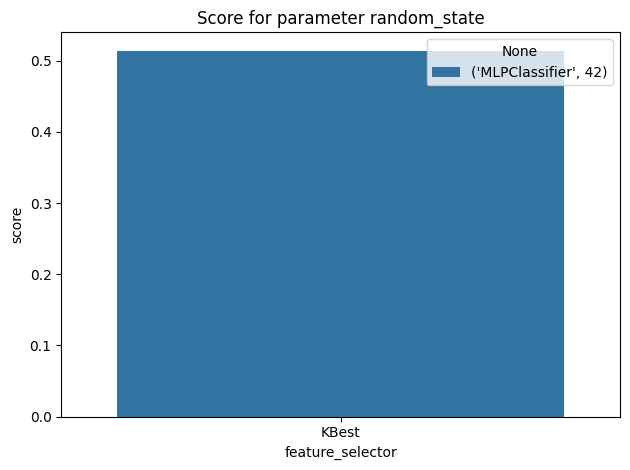

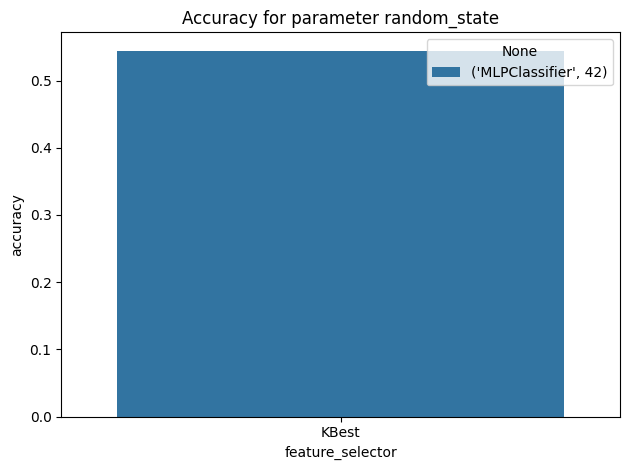

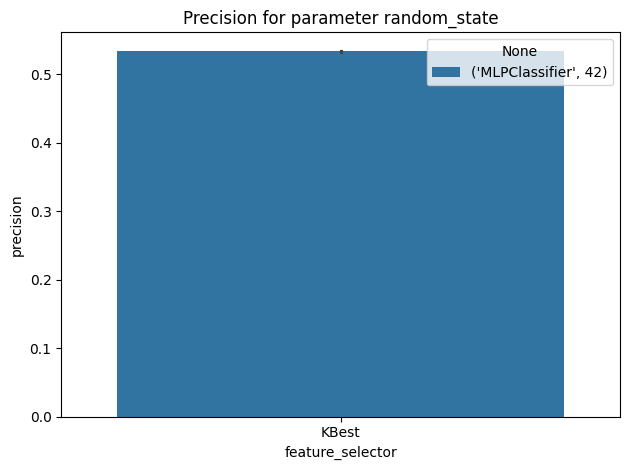

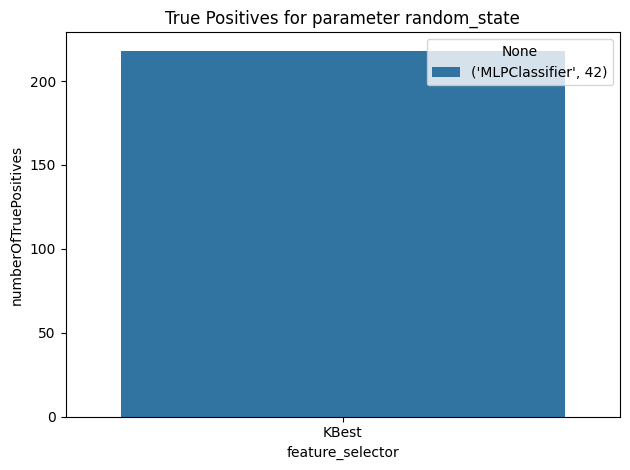

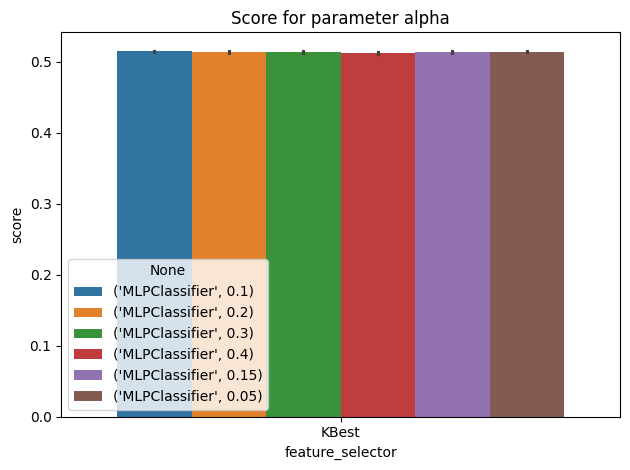

...

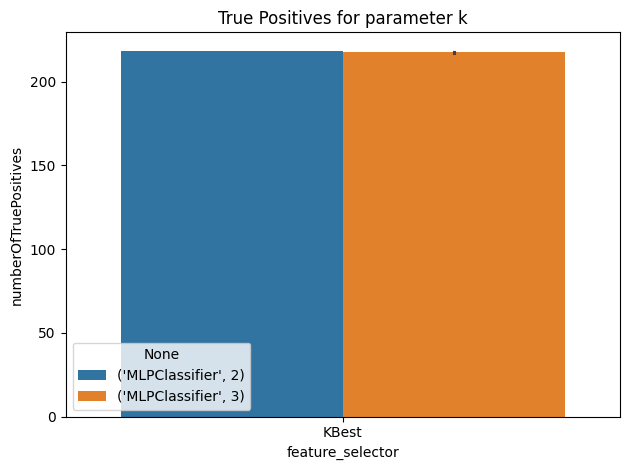

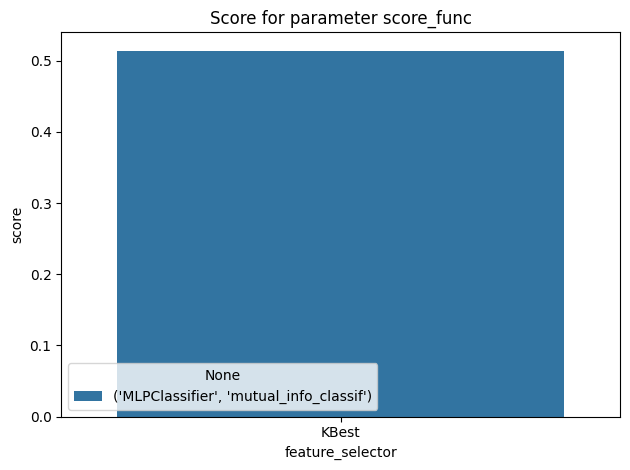

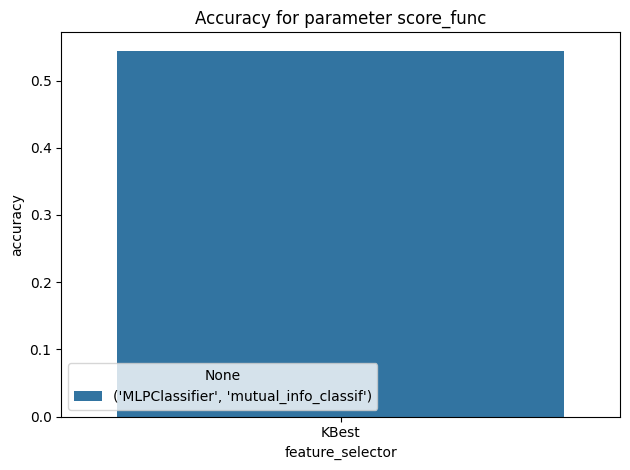

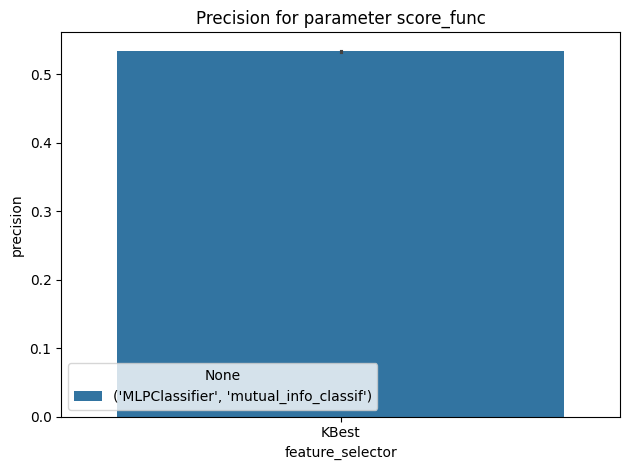

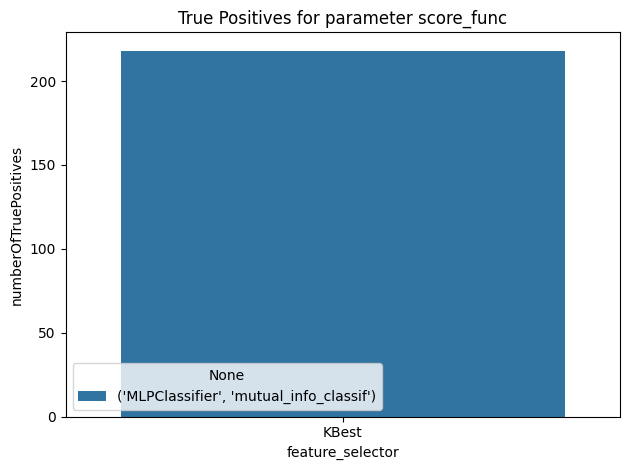

CPU times: total: 26.6 s
Wall time: 39.6 s


In [13]:
%%time
processedResultsDf, parameters = functions.extractParameterResultsArr(
    resultsDf,
    [models, featureSelectors, scalers, featureGenerators],
    [
        "model_parameters",
        "selector_parameters",
        "scaler_parameters",
        "feature_generator_parameters",
    ],
)
functions.drawParameterResultsBarplot(processedResultsDf, parameters)

### Score/Accuracy by number of features

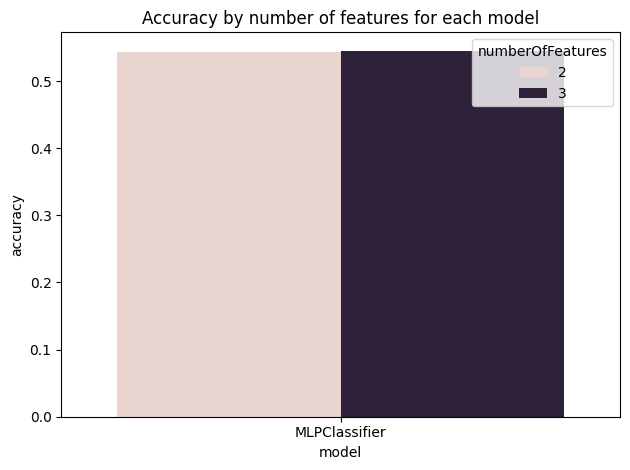

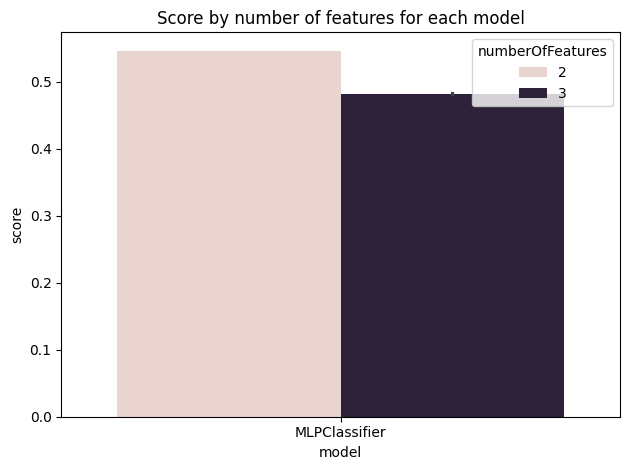

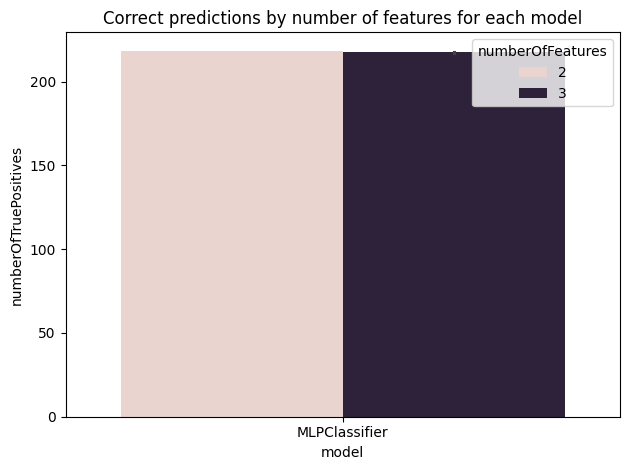

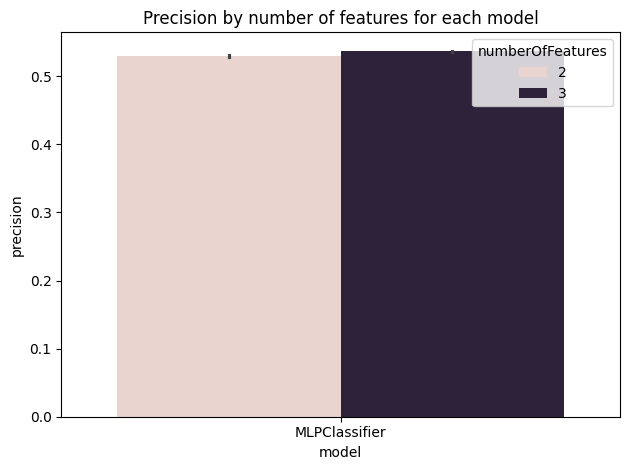

In [14]:
functions.drawResultsPerNumberOfFeatures(processedResultsDf)

### Final Results for Feature Selectors

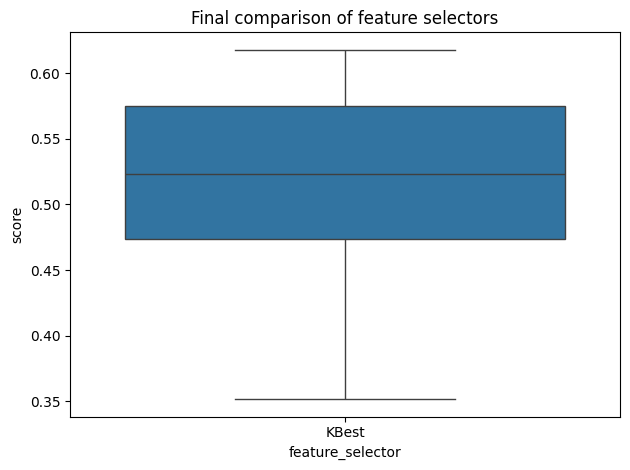

In [15]:
plt.title("Final comparison of feature selectors")
sns.boxplot(data=processedResultsDf, x="feature_selector", y="score")

plt.tight_layout()
plt.show()

<Axes: xlabel='model', ylabel='score'>

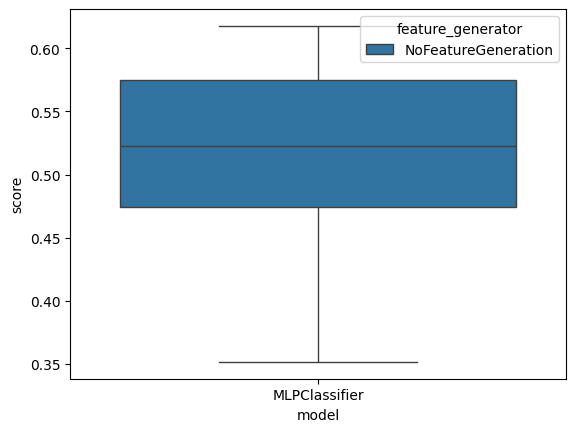

In [16]:
sns.boxplot(data=processedResultsDf, x="model", y="score", hue="feature_generator")

<Axes: xlabel='model', ylabel='score'>

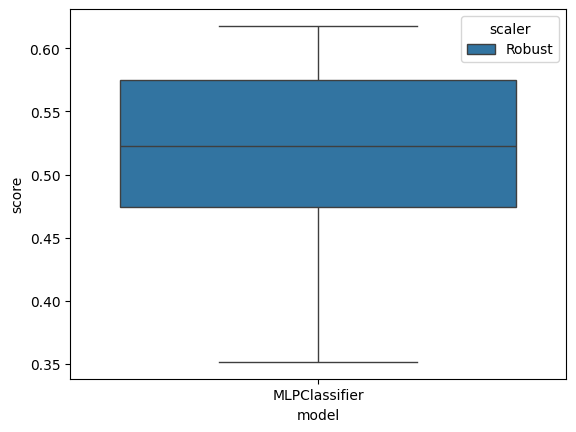

In [17]:
sns.boxplot(data=processedResultsDf, x="model", y="score", hue="scaler")

### Final Results for Models

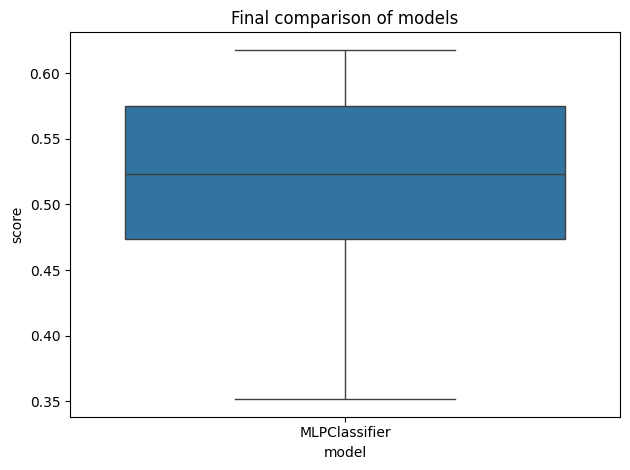

In [18]:
plt.title("Final comparison of models")
sns.boxplot(data=processedResultsDf, x="model", y="score")
plt.tight_layout()
plt.show()

### Final Results

In [19]:
%%time
filteredDf = functions.filterDataframeByBestResults(processedResultsDf)

CPU times: total: 31.2 ms
Wall time: 21.9 ms


In [20]:
processedResultsDf[
    processedResultsDf["model"] == functions.ModelType.XGBoost.name
].sort_values(by="score", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_hidden_layer_sizes,model_parameters_beta_2,model_parameters_solver,model_parameters_learning_rate_init,model_parameters_learning_rate,model_parameters_max_iter,model_parameters_beta_1,selector_parameters_k,selector_parameters_score_func


In [21]:
processedResultsDf.sort_values(by="numberOfTruePositives", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_hidden_layer_sizes,model_parameters_beta_2,model_parameters_solver,model_parameters_learning_rate_init,model_parameters_learning_rate,model_parameters_max_iter,model_parameters_beta_1,selector_parameters_k,selector_parameters_score_func
40075,0.556575,242,0.555152,0.560831,3,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,"(27,)",0.999,adam,0.004,adaptive,1600,0.95,3,mutual_info_classif
42094,0.556575,242,0.560606,0.563107,3,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,"(200,)",0.950,adam,0.007,adaptive,1600,0.95,3,mutual_info_classif
19265,0.617737,242,0.563636,0.569565,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(25,)",0.950,adam,0.005,adaptive,1600,0.95,2,mutual_info_classif
4470,0.617737,242,0.563030,0.572519,2,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,"(13,)",0.999,adam,0.008,adaptive,1600,0.95,2,mutual_info_classif
14594,0.617737,242,0.561818,0.576355,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(20,)",0.950,adam,0.009,adaptive,1600,0.90,2,mutual_info_classif


In [22]:
processedResultsDf[
    processedResultsDf["feature_generator"]
    == functions.FeatureGenerator.Polynomial.name
].sort_values(by="numberOfTruePositives", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_hidden_layer_sizes,model_parameters_beta_2,model_parameters_solver,model_parameters_learning_rate_init,model_parameters_learning_rate,model_parameters_max_iter,model_parameters_beta_1,selector_parameters_k,selector_parameters_score_func


In [23]:
processedResultsDf[
    processedResultsDf["scaler"] == functions.Scaler.NoScaling.name
].sort_values(by="score", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_hidden_layer_sizes,model_parameters_beta_2,model_parameters_solver,model_parameters_learning_rate_init,model_parameters_learning_rate,model_parameters_max_iter,model_parameters_beta_1,selector_parameters_k,selector_parameters_score_func


In [24]:
filteredDf["scaler"]

4470     Robust
4686     Robust
7278     Robust
14594    Robust
19265    Robust
19844    Robust
23086    Robust
23276    Robust
Name: scaler, dtype: object

In [25]:
filteredDf["model_parameters"].to_numpy()

array([{'activation': 'relu', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42},
       {'activation': 'relu', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42},
       {'activation': 'relu', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42},
       {'activation': 'tanh', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42},
       {'activation': 'tanh', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adapti

In [26]:
filteredDf["feature_generator"]

4470     NoFeatureGeneration
4686     NoFeatureGeneration
7278     NoFeatureGeneration
14594    NoFeatureGeneration
19265    NoFeatureGeneration
19844    NoFeatureGeneration
23086    NoFeatureGeneration
23276    NoFeatureGeneration
Name: feature_generator, dtype: object

In [27]:
filteredDf

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_hidden_layer_sizes,model_parameters_beta_2,model_parameters_solver,model_parameters_learning_rate_init,model_parameters_learning_rate,model_parameters_max_iter,model_parameters_beta_1,selector_parameters_k,selector_parameters_score_func
4470,0.617737,242,0.563030,0.572519,2,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,"(13,)",0.999,adam,0.008,adaptive,1600,0.95,2,mutual_info_classif
4686,0.617737,242,0.563636,0.571642,2,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,"(13,)",0.999,adam,0.008,adaptive,1600,0.95,2,mutual_info_classif
7278,0.617737,242,0.566667,0.575261,2,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,"(13,)",0.950,adam,0.008,adaptive,1600,0.95,2,mutual_info_classif
14594,0.617737,242,0.561818,0.576355,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(20,)",0.950,adam,0.009,adaptive,1600,0.90,2,mutual_info_classif
19265,0.617737,242,0.563636,0.569565,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(25,)",0.950,adam,0.005,adaptive,1600,0.95,2,mutual_info_classif
19844,0.617737,242,0.563636,0.576677,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(28,)",0.999,adam,0.007,adaptive,1600,0.85,2,mutual_info_classif
23086,0.617737,242,0.570909,0.563084,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(200,)",0.950,adam,0.007,adaptive,1600,0.85,2,mutual_info_classif
23276,0.617737,242,0.560000,0.567771,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(28,)",0.950,adam,0.008,adaptive,1600,0.85,2,mutual_info_classif


In [28]:
%%time
filteredDf = functions.filterDataframeByBestResults(processedResultsDf)

CPU times: total: 0 ns
Wall time: 26 ms


In [29]:
processedResultsDf[
    processedResultsDf["scaler"] == functions.Scaler.NoScaling.name
].sort_values(by="score", ascending=False).head(5)

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_hidden_layer_sizes,model_parameters_beta_2,model_parameters_solver,model_parameters_learning_rate_init,model_parameters_learning_rate,model_parameters_max_iter,model_parameters_beta_1,selector_parameters_k,selector_parameters_score_func


In [30]:
filteredDf["scaler"]

4470     Robust
4686     Robust
7278     Robust
14594    Robust
19265    Robust
19844    Robust
23086    Robust
23276    Robust
Name: scaler, dtype: object

In [31]:
filteredDf["model_parameters"].to_numpy()

array([{'activation': 'relu', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.3, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42},
       {'activation': 'relu', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.999, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42},
       {'activation': 'relu', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.4, 'learning_rate': 'adaptive', 'learning_rate_init': 0.008, 'hidden_layer_sizes': (13,), 'max_iter': 1600, 'random_state': 42},
       {'activation': 'tanh', 'solver': 'adam', 'beta_1': 0.9, 'beta_2': 0.95, 'alpha': 0.2, 'learning_rate': 'adaptive', 'learning_rate_init': 0.009, 'hidden_layer_sizes': (20,), 'max_iter': 1600, 'random_state': 42},
       {'activation': 'tanh', 'solver': 'adam', 'beta_1': 0.95, 'beta_2': 0.95, 'alpha': 0.05, 'learning_rate': 'adapti

In [32]:
filteredDf["feature_generator"]

4470     NoFeatureGeneration
4686     NoFeatureGeneration
7278     NoFeatureGeneration
14594    NoFeatureGeneration
19265    NoFeatureGeneration
19844    NoFeatureGeneration
23086    NoFeatureGeneration
23276    NoFeatureGeneration
Name: feature_generator, dtype: object

In [33]:
filteredDf

,score,numberOfTruePositives,accuracy,precision,numberOfFeatures,model,model_parameters,feature_selector,selector_parameters,scaler,...,model_parameters_activation,model_parameters_hidden_layer_sizes,model_parameters_beta_2,model_parameters_solver,model_parameters_learning_rate_init,model_parameters_learning_rate,model_parameters_max_iter,model_parameters_beta_1,selector_parameters_k,selector_parameters_score_func
4470,0.617737,242,0.563030,0.572519,2,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,"(13,)",0.999,adam,0.008,adaptive,1600,0.95,2,mutual_info_classif
4686,0.617737,242,0.563636,0.571642,2,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,"(13,)",0.999,adam,0.008,adaptive,1600,0.95,2,mutual_info_classif
7278,0.617737,242,0.566667,0.575261,2,MLPClassifier,"{'activation': 'relu', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,relu,"(13,)",0.950,adam,0.008,adaptive,1600,0.95,2,mutual_info_classif
14594,0.617737,242,0.561818,0.576355,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(20,)",0.950,adam,0.009,adaptive,1600,0.90,2,mutual_info_classif
19265,0.617737,242,0.563636,0.569565,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(25,)",0.950,adam,0.005,adaptive,1600,0.95,2,mutual_info_classif
19844,0.617737,242,0.563636,0.576677,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(28,)",0.999,adam,0.007,adaptive,1600,0.85,2,mutual_info_classif
23086,0.617737,242,0.570909,0.563084,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(200,)",0.950,adam,0.007,adaptive,1600,0.85,2,mutual_info_classif
23276,0.617737,242,0.560000,0.567771,2,MLPClassifier,"{'activation': 'tanh', 'solver': 'adam', 'beta...",KBest,{'score_func': <function mutual_info_classif a...,Robust,...,tanh,"(28,)",0.950,adam,0.008,adaptive,1600,0.85,2,mutual_info_classif
